# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:12, 15.1MB/s]                              
SVHN Testing Set: 64.3MB [00:05, 11.7MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

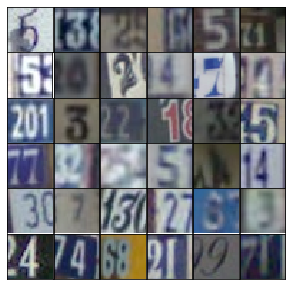

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def leaky_relu(alpha, val):
    return tf.maximum(alpha * val, val)

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Convert to shape for first conv layer.
        x1 = tf.reshape(x1, shape=(-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = leaky_relu(alpha, x1)
        # 4x4x512 now
        
        # Layer 2
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = leaky_relu(alpha, x2)
        # 8x8x256 now
        
        # Layer 3
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = leaky_relu(alpha, x3)
        # 16x16x128 now
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding="same")
        x1 = leaky_relu(alpha, x1)
        # 16x16x64
        
        # Layer 2
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding="same")
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = leaky_relu(alpha, x2)
        # 8x8x128
        
        # Layer 3
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding="same")
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = leaky_relu(alpha, x3)
        # 4x4x256
        
        # Flatten it.
        flattened = tf.reshape(x3, shape=(-1, 4*4*256))
        logits = tf.layers.dense(flattened, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [23]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2676... Generator Loss: 0.7339
Epoch 1/25... Discriminator Loss: 0.3308... Generator Loss: 2.4260
Epoch 1/25... Discriminator Loss: 0.1838... Generator Loss: 2.2110
Epoch 1/25... Discriminator Loss: 0.1591... Generator Loss: 2.5843
Epoch 1/25... Discriminator Loss: 0.1344... Generator Loss: 2.7827
Epoch 1/25... Discriminator Loss: 0.1043... Generator Loss: 2.8689
Epoch 1/25... Discriminator Loss: 0.1017... Generator Loss: 2.9999
Epoch 1/25... Discriminator Loss: 0.1539... Generator Loss: 3.8205
Epoch 1/25... Discriminator Loss: 0.1027... Generator Loss: 3.3379
Epoch 1/25... Discriminator Loss: 0.2706... Generator Loss: 2.3014


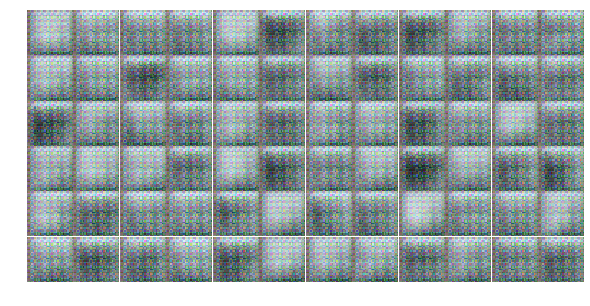

Epoch 1/25... Discriminator Loss: 1.1294... Generator Loss: 2.5824
Epoch 1/25... Discriminator Loss: 0.3897... Generator Loss: 2.4271
Epoch 1/25... Discriminator Loss: 0.3841... Generator Loss: 2.2529
Epoch 1/25... Discriminator Loss: 0.2527... Generator Loss: 2.4542
Epoch 1/25... Discriminator Loss: 0.3007... Generator Loss: 2.0713
Epoch 1/25... Discriminator Loss: 0.5477... Generator Loss: 1.4357
Epoch 1/25... Discriminator Loss: 0.2571... Generator Loss: 2.4647
Epoch 1/25... Discriminator Loss: 0.2837... Generator Loss: 2.2053
Epoch 1/25... Discriminator Loss: 0.1832... Generator Loss: 3.3674
Epoch 1/25... Discriminator Loss: 0.5076... Generator Loss: 2.5308


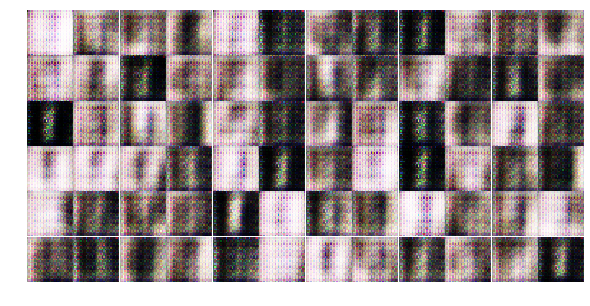

Epoch 1/25... Discriminator Loss: 1.1702... Generator Loss: 0.6177
Epoch 1/25... Discriminator Loss: 0.7690... Generator Loss: 1.0266
Epoch 1/25... Discriminator Loss: 2.1705... Generator Loss: 0.4065
Epoch 1/25... Discriminator Loss: 0.5103... Generator Loss: 1.8199
Epoch 1/25... Discriminator Loss: 0.5603... Generator Loss: 3.3124
Epoch 1/25... Discriminator Loss: 0.7434... Generator Loss: 1.1570
Epoch 1/25... Discriminator Loss: 2.3735... Generator Loss: 3.2711
Epoch 1/25... Discriminator Loss: 0.7081... Generator Loss: 1.1681
Epoch 1/25... Discriminator Loss: 0.7192... Generator Loss: 1.8454
Epoch 1/25... Discriminator Loss: 0.5972... Generator Loss: 3.1003


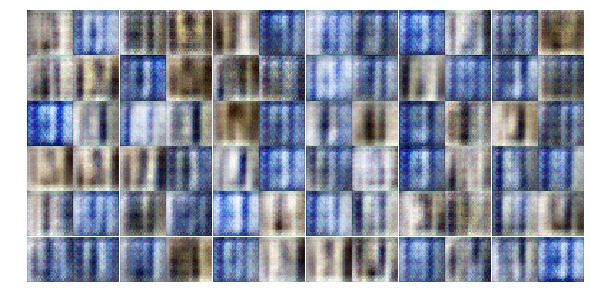

Epoch 1/25... Discriminator Loss: 1.3154... Generator Loss: 1.6344
Epoch 1/25... Discriminator Loss: 0.6041... Generator Loss: 1.5346
Epoch 1/25... Discriminator Loss: 0.6680... Generator Loss: 1.6405
Epoch 1/25... Discriminator Loss: 0.7467... Generator Loss: 1.0365
Epoch 1/25... Discriminator Loss: 0.5474... Generator Loss: 2.0235
Epoch 1/25... Discriminator Loss: 0.7857... Generator Loss: 1.0390
Epoch 1/25... Discriminator Loss: 0.4462... Generator Loss: 1.9263
Epoch 1/25... Discriminator Loss: 0.2306... Generator Loss: 3.4866
Epoch 1/25... Discriminator Loss: 0.5420... Generator Loss: 1.5954
Epoch 1/25... Discriminator Loss: 0.3855... Generator Loss: 2.1767


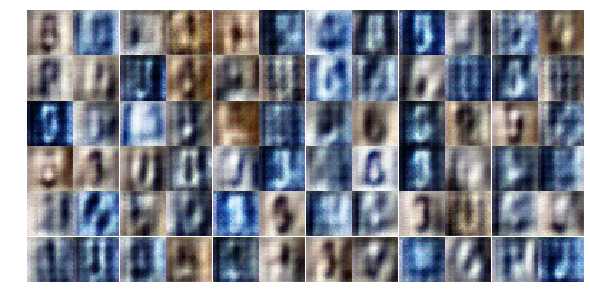

Epoch 1/25... Discriminator Loss: 1.1805... Generator Loss: 0.6561
Epoch 1/25... Discriminator Loss: 0.8863... Generator Loss: 0.8884
Epoch 1/25... Discriminator Loss: 0.4315... Generator Loss: 2.5617
Epoch 1/25... Discriminator Loss: 1.5366... Generator Loss: 1.8166
Epoch 1/25... Discriminator Loss: 0.6266... Generator Loss: 1.9625
Epoch 1/25... Discriminator Loss: 0.6413... Generator Loss: 1.1301
Epoch 1/25... Discriminator Loss: 0.5928... Generator Loss: 1.4554
Epoch 1/25... Discriminator Loss: 0.6426... Generator Loss: 1.4076
Epoch 1/25... Discriminator Loss: 0.7270... Generator Loss: 1.2543
Epoch 1/25... Discriminator Loss: 0.4165... Generator Loss: 2.9080


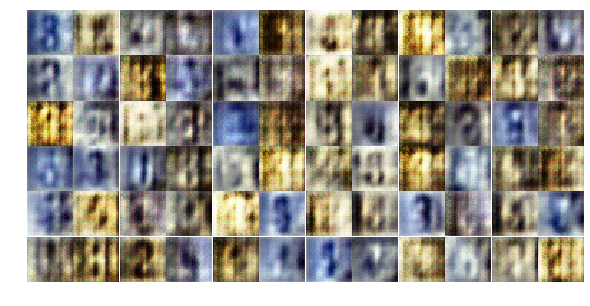

Epoch 1/25... Discriminator Loss: 0.3175... Generator Loss: 2.1547
Epoch 1/25... Discriminator Loss: 0.5024... Generator Loss: 1.5905
Epoch 1/25... Discriminator Loss: 0.8821... Generator Loss: 1.5729
Epoch 1/25... Discriminator Loss: 0.7577... Generator Loss: 0.9955
Epoch 1/25... Discriminator Loss: 0.8012... Generator Loss: 1.3970
Epoch 1/25... Discriminator Loss: 0.8920... Generator Loss: 1.0853
Epoch 1/25... Discriminator Loss: 0.6386... Generator Loss: 1.5754
Epoch 2/25... Discriminator Loss: 0.9485... Generator Loss: 1.4334
Epoch 2/25... Discriminator Loss: 0.6459... Generator Loss: 1.6790
Epoch 2/25... Discriminator Loss: 1.1010... Generator Loss: 1.0081


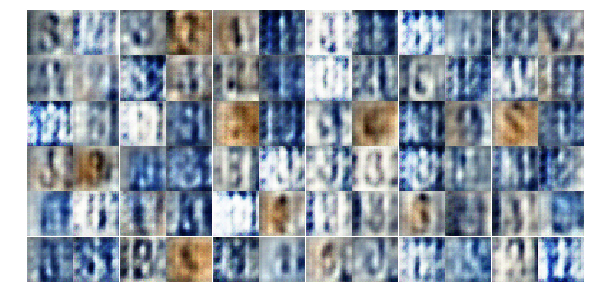

Epoch 2/25... Discriminator Loss: 1.5239... Generator Loss: 0.3376
Epoch 2/25... Discriminator Loss: 1.1437... Generator Loss: 0.8585
Epoch 2/25... Discriminator Loss: 0.9965... Generator Loss: 1.0481
Epoch 2/25... Discriminator Loss: 0.9264... Generator Loss: 1.3443
Epoch 2/25... Discriminator Loss: 0.9925... Generator Loss: 0.8507
Epoch 2/25... Discriminator Loss: 1.0349... Generator Loss: 1.0476
Epoch 2/25... Discriminator Loss: 1.0119... Generator Loss: 1.0329
Epoch 2/25... Discriminator Loss: 0.6762... Generator Loss: 1.1132
Epoch 2/25... Discriminator Loss: 0.8763... Generator Loss: 1.4883
Epoch 2/25... Discriminator Loss: 0.8026... Generator Loss: 1.2574


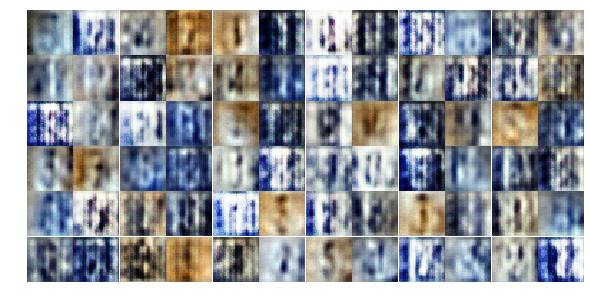

Epoch 2/25... Discriminator Loss: 1.2403... Generator Loss: 1.7072
Epoch 2/25... Discriminator Loss: 1.0484... Generator Loss: 1.1937
Epoch 2/25... Discriminator Loss: 1.1350... Generator Loss: 1.3711
Epoch 2/25... Discriminator Loss: 0.9870... Generator Loss: 1.0098
Epoch 2/25... Discriminator Loss: 1.1309... Generator Loss: 0.9591
Epoch 2/25... Discriminator Loss: 1.3659... Generator Loss: 0.7766
Epoch 2/25... Discriminator Loss: 1.1823... Generator Loss: 0.6989
Epoch 2/25... Discriminator Loss: 1.3229... Generator Loss: 0.6897
Epoch 2/25... Discriminator Loss: 1.3954... Generator Loss: 0.7861
Epoch 2/25... Discriminator Loss: 1.3881... Generator Loss: 0.4979


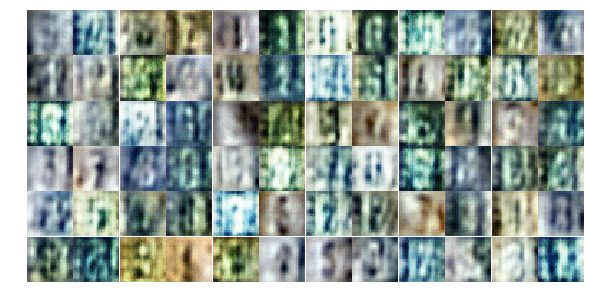

Epoch 2/25... Discriminator Loss: 1.3889... Generator Loss: 0.7126
Epoch 2/25... Discriminator Loss: 0.9175... Generator Loss: 1.0853
Epoch 2/25... Discriminator Loss: 1.3251... Generator Loss: 0.9090
Epoch 2/25... Discriminator Loss: 0.9508... Generator Loss: 0.8634
Epoch 2/25... Discriminator Loss: 1.0024... Generator Loss: 1.4782
Epoch 2/25... Discriminator Loss: 0.9238... Generator Loss: 0.9598
Epoch 2/25... Discriminator Loss: 0.8330... Generator Loss: 1.3159
Epoch 2/25... Discriminator Loss: 1.0505... Generator Loss: 0.8123
Epoch 2/25... Discriminator Loss: 1.0103... Generator Loss: 0.9234
Epoch 2/25... Discriminator Loss: 0.8850... Generator Loss: 1.2293


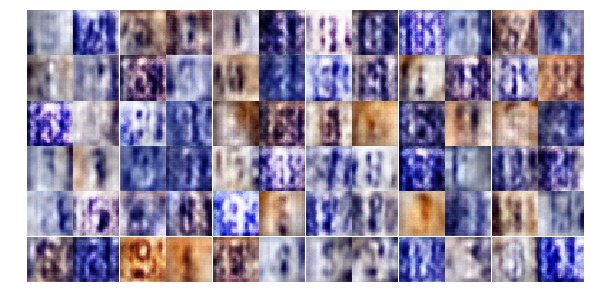

Epoch 2/25... Discriminator Loss: 1.0338... Generator Loss: 1.1751
Epoch 2/25... Discriminator Loss: 1.0527... Generator Loss: 0.9214
Epoch 2/25... Discriminator Loss: 1.2109... Generator Loss: 0.8663
Epoch 2/25... Discriminator Loss: 1.0834... Generator Loss: 0.9356
Epoch 2/25... Discriminator Loss: 1.0472... Generator Loss: 1.0423
Epoch 2/25... Discriminator Loss: 0.9177... Generator Loss: 1.0751
Epoch 2/25... Discriminator Loss: 1.0380... Generator Loss: 0.9533
Epoch 2/25... Discriminator Loss: 1.2859... Generator Loss: 1.0204
Epoch 2/25... Discriminator Loss: 1.0368... Generator Loss: 1.0695
Epoch 2/25... Discriminator Loss: 1.2137... Generator Loss: 0.8175


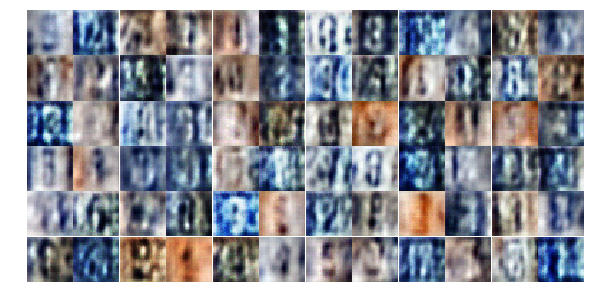

Epoch 2/25... Discriminator Loss: 1.6280... Generator Loss: 0.7537
Epoch 2/25... Discriminator Loss: 1.2335... Generator Loss: 1.0159
Epoch 2/25... Discriminator Loss: 1.0355... Generator Loss: 0.9851
Epoch 2/25... Discriminator Loss: 1.1563... Generator Loss: 0.9943
Epoch 2/25... Discriminator Loss: 1.0059... Generator Loss: 1.4572
Epoch 2/25... Discriminator Loss: 1.0255... Generator Loss: 0.8460
Epoch 2/25... Discriminator Loss: 0.9990... Generator Loss: 1.2935
Epoch 2/25... Discriminator Loss: 0.9288... Generator Loss: 1.1301
Epoch 2/25... Discriminator Loss: 0.6265... Generator Loss: 1.4961
Epoch 2/25... Discriminator Loss: 0.9107... Generator Loss: 1.0383


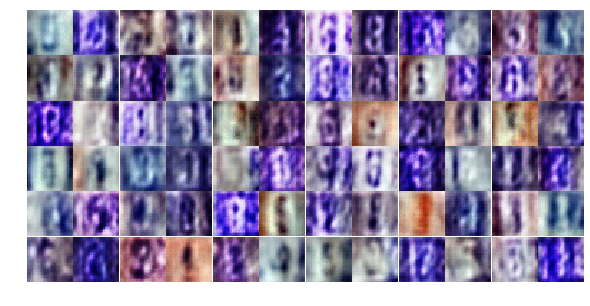

Epoch 2/25... Discriminator Loss: 0.9730... Generator Loss: 0.9607
Epoch 2/25... Discriminator Loss: 0.9582... Generator Loss: 1.0884
Epoch 2/25... Discriminator Loss: 1.2938... Generator Loss: 0.5216
Epoch 2/25... Discriminator Loss: 0.8753... Generator Loss: 1.1903
Epoch 3/25... Discriminator Loss: 1.0866... Generator Loss: 1.7881
Epoch 3/25... Discriminator Loss: 0.8941... Generator Loss: 0.9673
Epoch 3/25... Discriminator Loss: 0.8009... Generator Loss: 1.0807
Epoch 3/25... Discriminator Loss: 1.1654... Generator Loss: 0.8894
Epoch 3/25... Discriminator Loss: 0.6360... Generator Loss: 1.1268
Epoch 3/25... Discriminator Loss: 0.9903... Generator Loss: 0.9088


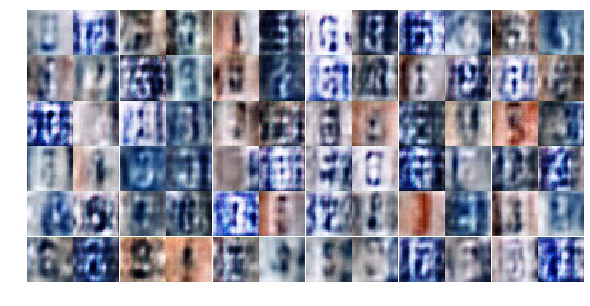

Epoch 3/25... Discriminator Loss: 0.7600... Generator Loss: 1.9761
Epoch 3/25... Discriminator Loss: 0.9823... Generator Loss: 1.3343
Epoch 3/25... Discriminator Loss: 0.9140... Generator Loss: 0.7638
Epoch 3/25... Discriminator Loss: 0.8219... Generator Loss: 0.9775
Epoch 3/25... Discriminator Loss: 0.7822... Generator Loss: 1.1068
Epoch 3/25... Discriminator Loss: 1.0450... Generator Loss: 0.8857
Epoch 3/25... Discriminator Loss: 1.0903... Generator Loss: 1.0443
Epoch 3/25... Discriminator Loss: 0.6652... Generator Loss: 1.4423
Epoch 3/25... Discriminator Loss: 0.9028... Generator Loss: 0.7285
Epoch 3/25... Discriminator Loss: 0.6255... Generator Loss: 1.4171


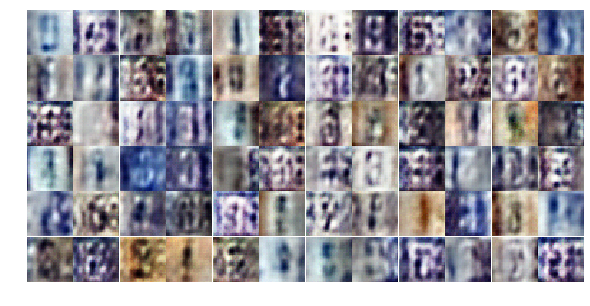

Epoch 3/25... Discriminator Loss: 0.5855... Generator Loss: 1.3233
Epoch 3/25... Discriminator Loss: 0.5353... Generator Loss: 1.4720
Epoch 3/25... Discriminator Loss: 0.7161... Generator Loss: 1.3783
Epoch 3/25... Discriminator Loss: 0.7651... Generator Loss: 1.2017
Epoch 3/25... Discriminator Loss: 0.8702... Generator Loss: 0.8807
Epoch 3/25... Discriminator Loss: 0.5299... Generator Loss: 1.5330
Epoch 3/25... Discriminator Loss: 1.1478... Generator Loss: 0.5053
Epoch 3/25... Discriminator Loss: 0.8358... Generator Loss: 1.6173
Epoch 3/25... Discriminator Loss: 0.8534... Generator Loss: 1.8230
Epoch 3/25... Discriminator Loss: 0.9343... Generator Loss: 0.8284


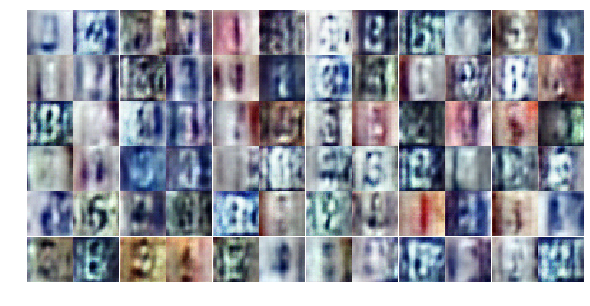

Epoch 3/25... Discriminator Loss: 0.8153... Generator Loss: 1.0041
Epoch 3/25... Discriminator Loss: 0.8442... Generator Loss: 0.9414
Epoch 3/25... Discriminator Loss: 0.8281... Generator Loss: 0.9368
Epoch 3/25... Discriminator Loss: 0.6278... Generator Loss: 1.1358
Epoch 3/25... Discriminator Loss: 1.1268... Generator Loss: 0.9754
Epoch 3/25... Discriminator Loss: 0.8869... Generator Loss: 0.9718
Epoch 3/25... Discriminator Loss: 1.1836... Generator Loss: 0.6670
Epoch 3/25... Discriminator Loss: 0.6067... Generator Loss: 1.6677
Epoch 3/25... Discriminator Loss: 0.6036... Generator Loss: 1.8516
Epoch 3/25... Discriminator Loss: 0.7261... Generator Loss: 1.0682


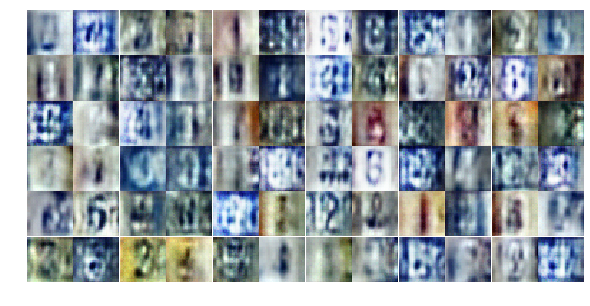

Epoch 3/25... Discriminator Loss: 0.5137... Generator Loss: 2.4394
Epoch 3/25... Discriminator Loss: 0.4620... Generator Loss: 2.1463
Epoch 3/25... Discriminator Loss: 0.4654... Generator Loss: 1.6860
Epoch 3/25... Discriminator Loss: 0.8472... Generator Loss: 0.9089
Epoch 3/25... Discriminator Loss: 0.5133... Generator Loss: 2.1165
Epoch 3/25... Discriminator Loss: 0.9075... Generator Loss: 1.3675
Epoch 3/25... Discriminator Loss: 0.8785... Generator Loss: 1.2866
Epoch 3/25... Discriminator Loss: 0.6742... Generator Loss: 1.7202
Epoch 3/25... Discriminator Loss: 0.8470... Generator Loss: 3.1388
Epoch 3/25... Discriminator Loss: 0.9703... Generator Loss: 1.9949


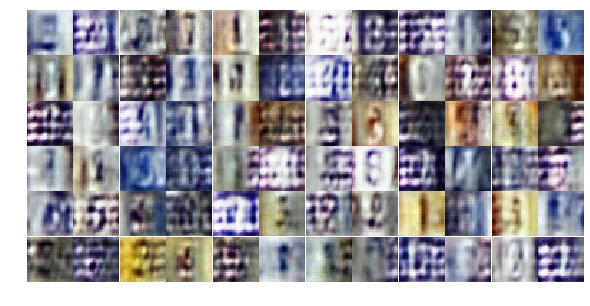

Epoch 3/25... Discriminator Loss: 1.7372... Generator Loss: 0.4305
Epoch 3/25... Discriminator Loss: 1.1338... Generator Loss: 0.7632
Epoch 3/25... Discriminator Loss: 0.6406... Generator Loss: 1.1508
Epoch 3/25... Discriminator Loss: 0.4609... Generator Loss: 1.9131
Epoch 3/25... Discriminator Loss: 1.9175... Generator Loss: 2.5974
Epoch 3/25... Discriminator Loss: 0.5240... Generator Loss: 1.6543
Epoch 3/25... Discriminator Loss: 0.5647... Generator Loss: 1.7179
Epoch 3/25... Discriminator Loss: 0.8872... Generator Loss: 2.0791
Epoch 3/25... Discriminator Loss: 0.8709... Generator Loss: 1.3494
Epoch 3/25... Discriminator Loss: 0.8130... Generator Loss: 0.9049


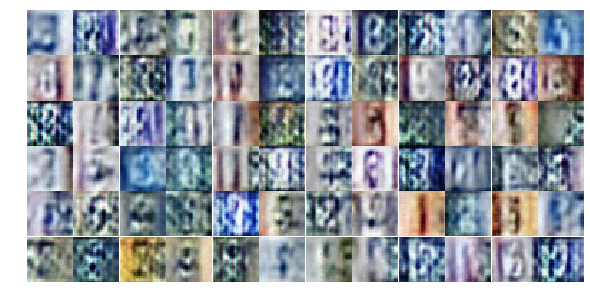

Epoch 3/25... Discriminator Loss: 0.8206... Generator Loss: 1.0210
Epoch 4/25... Discriminator Loss: 1.0548... Generator Loss: 0.6372
Epoch 4/25... Discriminator Loss: 0.7052... Generator Loss: 1.2194
Epoch 4/25... Discriminator Loss: 0.8654... Generator Loss: 0.7867
Epoch 4/25... Discriminator Loss: 0.6100... Generator Loss: 1.4026
Epoch 4/25... Discriminator Loss: 0.5656... Generator Loss: 2.2066
Epoch 4/25... Discriminator Loss: 0.6787... Generator Loss: 1.4422
Epoch 4/25... Discriminator Loss: 0.7946... Generator Loss: 0.9724
Epoch 4/25... Discriminator Loss: 0.8275... Generator Loss: 2.1319
Epoch 4/25... Discriminator Loss: 0.5494... Generator Loss: 1.3106


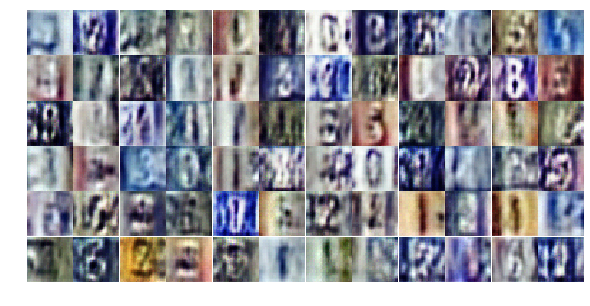

Epoch 4/25... Discriminator Loss: 0.4173... Generator Loss: 2.1874
Epoch 4/25... Discriminator Loss: 0.5804... Generator Loss: 1.6763
Epoch 4/25... Discriminator Loss: 0.8251... Generator Loss: 1.3554
Epoch 4/25... Discriminator Loss: 0.6915... Generator Loss: 1.0434
Epoch 4/25... Discriminator Loss: 0.8126... Generator Loss: 1.8565
Epoch 4/25... Discriminator Loss: 1.1306... Generator Loss: 0.5540
Epoch 4/25... Discriminator Loss: 1.0097... Generator Loss: 0.6941
Epoch 4/25... Discriminator Loss: 0.6420... Generator Loss: 1.2016
Epoch 4/25... Discriminator Loss: 0.7896... Generator Loss: 1.5300
Epoch 4/25... Discriminator Loss: 0.4661... Generator Loss: 1.6268


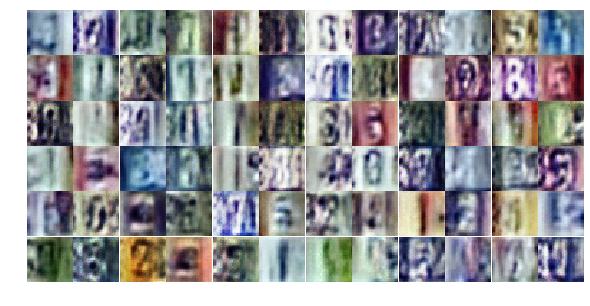

Epoch 4/25... Discriminator Loss: 0.9417... Generator Loss: 0.7468
Epoch 4/25... Discriminator Loss: 0.3840... Generator Loss: 1.9854
Epoch 4/25... Discriminator Loss: 0.5396... Generator Loss: 1.2686
Epoch 4/25... Discriminator Loss: 0.5543... Generator Loss: 1.5952
Epoch 4/25... Discriminator Loss: 0.5054... Generator Loss: 1.2221
Epoch 4/25... Discriminator Loss: 1.1731... Generator Loss: 1.4338
Epoch 4/25... Discriminator Loss: 2.2273... Generator Loss: 0.2137
Epoch 4/25... Discriminator Loss: 0.7702... Generator Loss: 1.1290
Epoch 4/25... Discriminator Loss: 0.4515... Generator Loss: 1.6806
Epoch 4/25... Discriminator Loss: 0.5513... Generator Loss: 1.2605


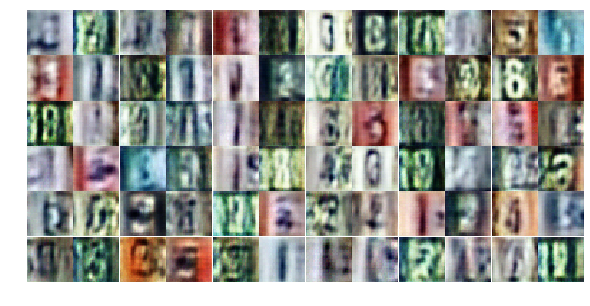

Epoch 4/25... Discriminator Loss: 0.4819... Generator Loss: 1.6584
Epoch 4/25... Discriminator Loss: 0.6258... Generator Loss: 1.8172
Epoch 4/25... Discriminator Loss: 0.6204... Generator Loss: 1.3905
Epoch 4/25... Discriminator Loss: 0.4854... Generator Loss: 2.0620
Epoch 4/25... Discriminator Loss: 0.3655... Generator Loss: 1.9469
Epoch 4/25... Discriminator Loss: 0.4760... Generator Loss: 1.3482
Epoch 4/25... Discriminator Loss: 0.5097... Generator Loss: 1.4176
Epoch 4/25... Discriminator Loss: 0.4627... Generator Loss: 1.7787
Epoch 4/25... Discriminator Loss: 1.2773... Generator Loss: 0.4898
Epoch 4/25... Discriminator Loss: 1.0278... Generator Loss: 0.6442


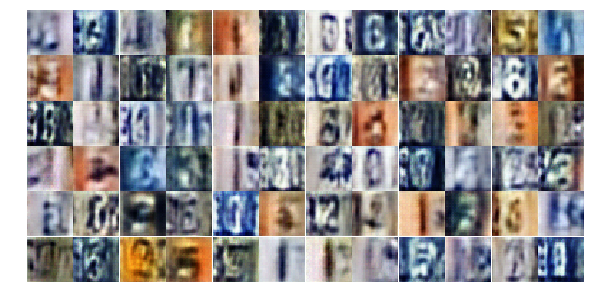

Epoch 4/25... Discriminator Loss: 0.4189... Generator Loss: 1.7938
Epoch 4/25... Discriminator Loss: 0.5359... Generator Loss: 1.2204
Epoch 4/25... Discriminator Loss: 0.6275... Generator Loss: 1.9263
Epoch 4/25... Discriminator Loss: 0.4966... Generator Loss: 1.8974
Epoch 4/25... Discriminator Loss: 0.4050... Generator Loss: 1.7436
Epoch 4/25... Discriminator Loss: 1.3774... Generator Loss: 1.9431
Epoch 4/25... Discriminator Loss: 0.9145... Generator Loss: 0.9471
Epoch 4/25... Discriminator Loss: 0.5877... Generator Loss: 1.7537
Epoch 4/25... Discriminator Loss: 0.4778... Generator Loss: 1.5314
Epoch 4/25... Discriminator Loss: 0.4195... Generator Loss: 2.0928


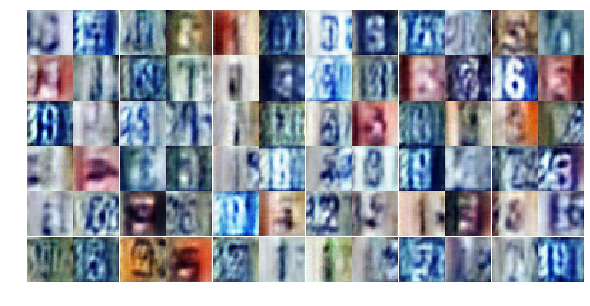

Epoch 4/25... Discriminator Loss: 0.5578... Generator Loss: 1.2427
Epoch 4/25... Discriminator Loss: 0.3910... Generator Loss: 1.7527
Epoch 4/25... Discriminator Loss: 0.3839... Generator Loss: 1.8922
Epoch 4/25... Discriminator Loss: 0.6642... Generator Loss: 1.1610
Epoch 4/25... Discriminator Loss: 0.5676... Generator Loss: 1.3087
Epoch 4/25... Discriminator Loss: 1.1054... Generator Loss: 0.5486
Epoch 4/25... Discriminator Loss: 0.5085... Generator Loss: 1.2094
Epoch 4/25... Discriminator Loss: 0.5569... Generator Loss: 1.4273
Epoch 4/25... Discriminator Loss: 0.5942... Generator Loss: 2.8932
Epoch 5/25... Discriminator Loss: 0.5456... Generator Loss: 1.4811


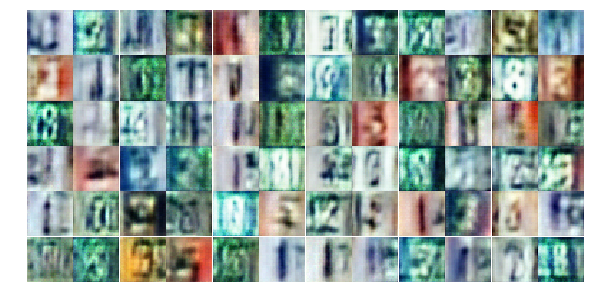

Epoch 5/25... Discriminator Loss: 0.4504... Generator Loss: 1.5461
Epoch 5/25... Discriminator Loss: 0.4107... Generator Loss: 1.7769
Epoch 5/25... Discriminator Loss: 0.6336... Generator Loss: 1.1336
Epoch 5/25... Discriminator Loss: 1.8533... Generator Loss: 4.7464
Epoch 5/25... Discriminator Loss: 0.5107... Generator Loss: 1.4592
Epoch 5/25... Discriminator Loss: 0.4786... Generator Loss: 1.4111
Epoch 5/25... Discriminator Loss: 0.4988... Generator Loss: 1.3681
Epoch 5/25... Discriminator Loss: 0.4218... Generator Loss: 1.6335
Epoch 5/25... Discriminator Loss: 0.7729... Generator Loss: 0.8278
Epoch 5/25... Discriminator Loss: 0.5353... Generator Loss: 1.2694


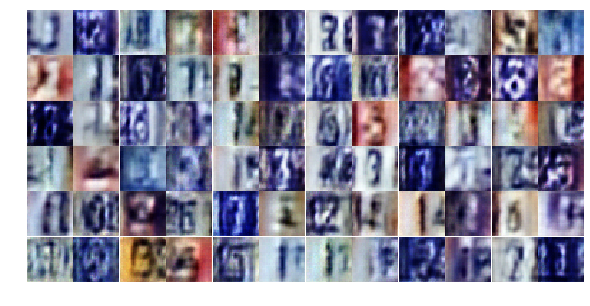

Epoch 5/25... Discriminator Loss: 0.5769... Generator Loss: 1.2574
Epoch 5/25... Discriminator Loss: 0.4377... Generator Loss: 1.5460
Epoch 5/25... Discriminator Loss: 0.3426... Generator Loss: 2.3152
Epoch 5/25... Discriminator Loss: 1.7741... Generator Loss: 0.3169
Epoch 5/25... Discriminator Loss: 1.1788... Generator Loss: 2.1386
Epoch 5/25... Discriminator Loss: 0.4803... Generator Loss: 1.4706
Epoch 5/25... Discriminator Loss: 0.6463... Generator Loss: 1.2135
Epoch 5/25... Discriminator Loss: 0.4708... Generator Loss: 1.8367
Epoch 5/25... Discriminator Loss: 0.6381... Generator Loss: 1.1466
Epoch 5/25... Discriminator Loss: 0.6624... Generator Loss: 1.0512


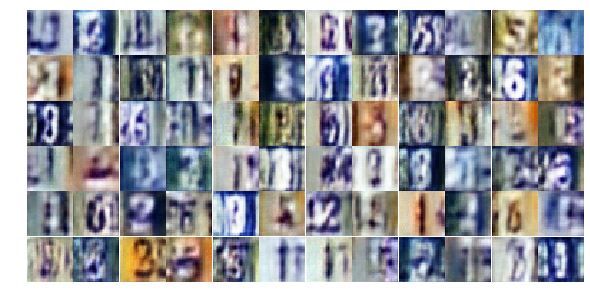

Epoch 5/25... Discriminator Loss: 0.6178... Generator Loss: 1.0181
Epoch 5/25... Discriminator Loss: 0.7756... Generator Loss: 0.8933
Epoch 5/25... Discriminator Loss: 0.4176... Generator Loss: 2.2593
Epoch 5/25... Discriminator Loss: 0.5726... Generator Loss: 1.5746
Epoch 5/25... Discriminator Loss: 0.8806... Generator Loss: 0.7999
Epoch 5/25... Discriminator Loss: 0.5977... Generator Loss: 1.1555
Epoch 5/25... Discriminator Loss: 0.6779... Generator Loss: 0.9652
Epoch 5/25... Discriminator Loss: 0.3847... Generator Loss: 1.7715
Epoch 5/25... Discriminator Loss: 0.7542... Generator Loss: 0.9661
Epoch 5/25... Discriminator Loss: 0.5636... Generator Loss: 2.7816


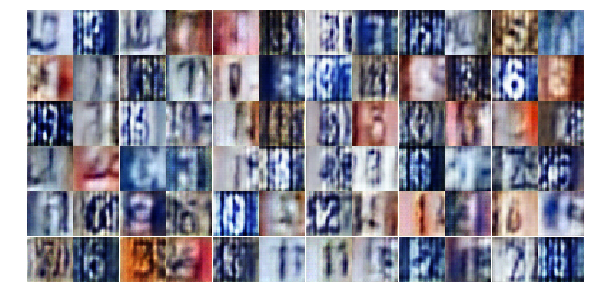

Epoch 5/25... Discriminator Loss: 0.6697... Generator Loss: 1.1209
Epoch 5/25... Discriminator Loss: 0.4960... Generator Loss: 1.6453
Epoch 5/25... Discriminator Loss: 0.5076... Generator Loss: 1.8969
Epoch 5/25... Discriminator Loss: 0.4548... Generator Loss: 1.4401
Epoch 5/25... Discriminator Loss: 1.7035... Generator Loss: 0.2839
Epoch 5/25... Discriminator Loss: 0.6980... Generator Loss: 1.8204
Epoch 5/25... Discriminator Loss: 0.9582... Generator Loss: 0.7631
Epoch 5/25... Discriminator Loss: 0.7872... Generator Loss: 0.8220
Epoch 5/25... Discriminator Loss: 0.6272... Generator Loss: 1.0128
Epoch 5/25... Discriminator Loss: 0.5475... Generator Loss: 1.5485


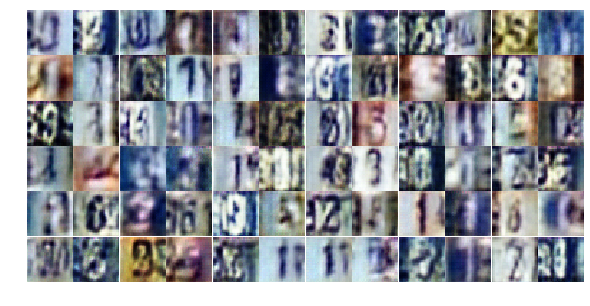

Epoch 5/25... Discriminator Loss: 0.5265... Generator Loss: 1.2996
Epoch 5/25... Discriminator Loss: 0.7340... Generator Loss: 0.8589
Epoch 5/25... Discriminator Loss: 0.8070... Generator Loss: 0.9543
Epoch 5/25... Discriminator Loss: 0.5163... Generator Loss: 1.1992
Epoch 5/25... Discriminator Loss: 1.3414... Generator Loss: 3.2455
Epoch 5/25... Discriminator Loss: 0.6247... Generator Loss: 1.3149
Epoch 5/25... Discriminator Loss: 0.7125... Generator Loss: 0.9902
Epoch 5/25... Discriminator Loss: 0.5346... Generator Loss: 1.9500
Epoch 5/25... Discriminator Loss: 0.7409... Generator Loss: 0.9146
Epoch 5/25... Discriminator Loss: 0.5770... Generator Loss: 1.7769


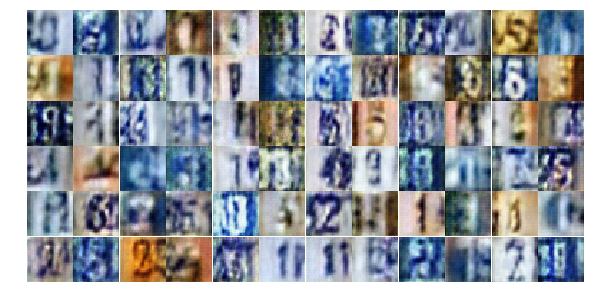

Epoch 5/25... Discriminator Loss: 2.0823... Generator Loss: 0.1825
Epoch 5/25... Discriminator Loss: 0.5471... Generator Loss: 1.5197
Epoch 5/25... Discriminator Loss: 0.7973... Generator Loss: 1.0514
Epoch 5/25... Discriminator Loss: 0.7552... Generator Loss: 0.9339
Epoch 5/25... Discriminator Loss: 0.5387... Generator Loss: 1.2448
Epoch 5/25... Discriminator Loss: 0.5838... Generator Loss: 1.3271
Epoch 6/25... Discriminator Loss: 0.6437... Generator Loss: 1.0365
Epoch 6/25... Discriminator Loss: 0.5640... Generator Loss: 2.4337
Epoch 6/25... Discriminator Loss: 0.3690... Generator Loss: 1.9395
Epoch 6/25... Discriminator Loss: 0.7276... Generator Loss: 0.9042


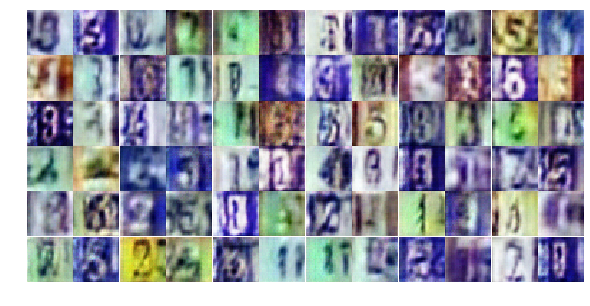

Epoch 6/25... Discriminator Loss: 0.6519... Generator Loss: 2.4864
Epoch 6/25... Discriminator Loss: 0.5435... Generator Loss: 1.4827
Epoch 6/25... Discriminator Loss: 0.5451... Generator Loss: 1.4321
Epoch 6/25... Discriminator Loss: 0.6642... Generator Loss: 1.2771
Epoch 6/25... Discriminator Loss: 1.2300... Generator Loss: 0.5090
Epoch 6/25... Discriminator Loss: 0.6382... Generator Loss: 1.0348
Epoch 6/25... Discriminator Loss: 0.5525... Generator Loss: 1.3649
Epoch 6/25... Discriminator Loss: 0.6683... Generator Loss: 1.1167
Epoch 6/25... Discriminator Loss: 0.9689... Generator Loss: 0.7206
Epoch 6/25... Discriminator Loss: 0.8966... Generator Loss: 3.4687


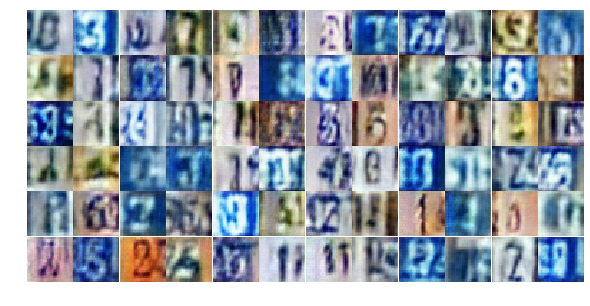

Epoch 6/25... Discriminator Loss: 1.0029... Generator Loss: 0.6781
Epoch 6/25... Discriminator Loss: 0.7645... Generator Loss: 1.3197
Epoch 6/25... Discriminator Loss: 0.7864... Generator Loss: 0.8384
Epoch 6/25... Discriminator Loss: 0.4796... Generator Loss: 1.3742
Epoch 6/25... Discriminator Loss: 0.3922... Generator Loss: 1.7790
Epoch 6/25... Discriminator Loss: 0.5696... Generator Loss: 1.1914
Epoch 6/25... Discriminator Loss: 0.5109... Generator Loss: 1.8854
Epoch 6/25... Discriminator Loss: 0.6400... Generator Loss: 1.0730
Epoch 6/25... Discriminator Loss: 0.6066... Generator Loss: 2.6257
Epoch 6/25... Discriminator Loss: 0.7678... Generator Loss: 1.2152


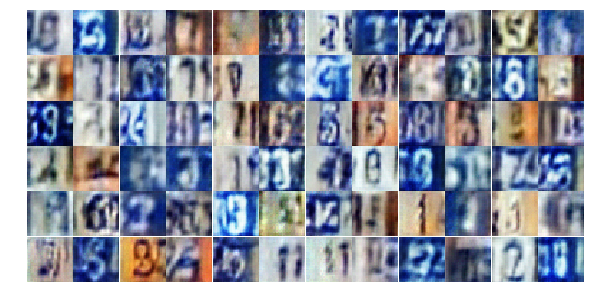

Epoch 6/25... Discriminator Loss: 1.0482... Generator Loss: 0.5942
Epoch 6/25... Discriminator Loss: 0.6485... Generator Loss: 1.1506
Epoch 6/25... Discriminator Loss: 0.7595... Generator Loss: 1.1095
Epoch 6/25... Discriminator Loss: 0.6949... Generator Loss: 0.9473
Epoch 6/25... Discriminator Loss: 0.4336... Generator Loss: 1.5538
Epoch 6/25... Discriminator Loss: 0.6758... Generator Loss: 1.1860
Epoch 6/25... Discriminator Loss: 0.6106... Generator Loss: 1.3184
Epoch 6/25... Discriminator Loss: 0.4448... Generator Loss: 1.3773
Epoch 6/25... Discriminator Loss: 0.5208... Generator Loss: 1.3432
Epoch 6/25... Discriminator Loss: 0.3566... Generator Loss: 1.7524


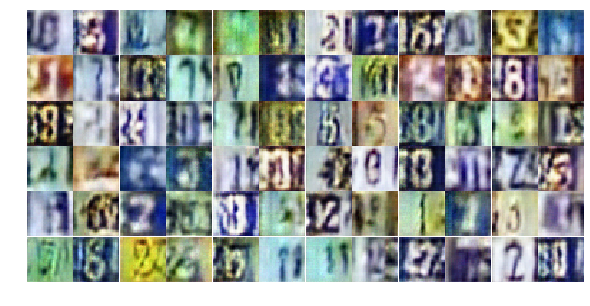

Epoch 6/25... Discriminator Loss: 0.6899... Generator Loss: 1.4285
Epoch 6/25... Discriminator Loss: 0.9623... Generator Loss: 2.9907
Epoch 6/25... Discriminator Loss: 0.9728... Generator Loss: 0.7307
Epoch 6/25... Discriminator Loss: 0.6573... Generator Loss: 1.1309
Epoch 6/25... Discriminator Loss: 0.5840... Generator Loss: 1.0606
Epoch 6/25... Discriminator Loss: 1.1004... Generator Loss: 0.5766
Epoch 6/25... Discriminator Loss: 0.4688... Generator Loss: 1.5538
Epoch 6/25... Discriminator Loss: 1.1727... Generator Loss: 0.5065
Epoch 6/25... Discriminator Loss: 0.6882... Generator Loss: 1.4425
Epoch 6/25... Discriminator Loss: 0.9475... Generator Loss: 0.6499


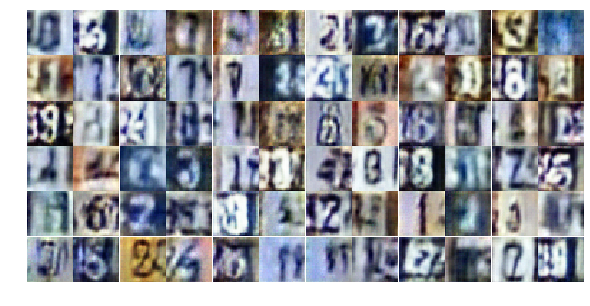

Epoch 6/25... Discriminator Loss: 0.7283... Generator Loss: 1.1964
Epoch 6/25... Discriminator Loss: 0.8158... Generator Loss: 0.8604
Epoch 6/25... Discriminator Loss: 0.8323... Generator Loss: 0.8563
Epoch 6/25... Discriminator Loss: 0.5196... Generator Loss: 1.7330
Epoch 6/25... Discriminator Loss: 0.4648... Generator Loss: 1.6364
Epoch 6/25... Discriminator Loss: 0.6479... Generator Loss: 0.9947
Epoch 6/25... Discriminator Loss: 1.1487... Generator Loss: 0.5398
Epoch 6/25... Discriminator Loss: 0.9095... Generator Loss: 0.8130
Epoch 6/25... Discriminator Loss: 0.4323... Generator Loss: 1.6099
Epoch 6/25... Discriminator Loss: 1.4413... Generator Loss: 0.3924


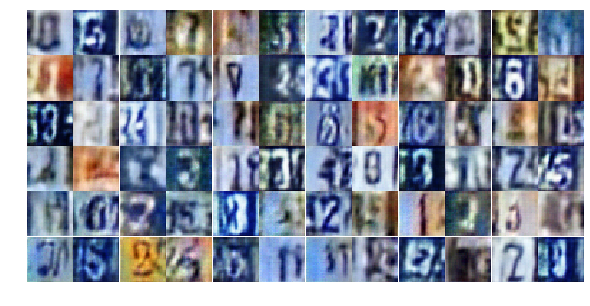

Epoch 6/25... Discriminator Loss: 0.5747... Generator Loss: 1.7977
Epoch 6/25... Discriminator Loss: 0.4402... Generator Loss: 1.5287
Epoch 6/25... Discriminator Loss: 0.6366... Generator Loss: 1.1758
Epoch 7/25... Discriminator Loss: 0.5261... Generator Loss: 2.3762
Epoch 7/25... Discriminator Loss: 0.9492... Generator Loss: 0.6812
Epoch 7/25... Discriminator Loss: 0.5627... Generator Loss: 1.6222
Epoch 7/25... Discriminator Loss: 1.0669... Generator Loss: 0.6114
Epoch 7/25... Discriminator Loss: 0.4135... Generator Loss: 1.7874
Epoch 7/25... Discriminator Loss: 0.5035... Generator Loss: 1.8818
Epoch 7/25... Discriminator Loss: 0.5642... Generator Loss: 1.5697


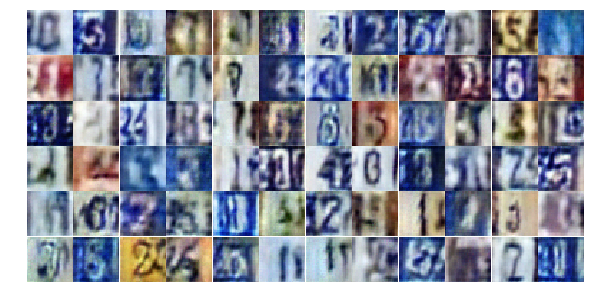

Epoch 7/25... Discriminator Loss: 0.5931... Generator Loss: 1.1784
Epoch 7/25... Discriminator Loss: 0.6830... Generator Loss: 1.0058
Epoch 7/25... Discriminator Loss: 0.7386... Generator Loss: 0.9394
Epoch 7/25... Discriminator Loss: 0.8849... Generator Loss: 1.9776
Epoch 7/25... Discriminator Loss: 0.4322... Generator Loss: 1.5392
Epoch 7/25... Discriminator Loss: 0.4559... Generator Loss: 1.4581
Epoch 7/25... Discriminator Loss: 1.1503... Generator Loss: 2.9998
Epoch 7/25... Discriminator Loss: 0.9704... Generator Loss: 1.8480
Epoch 7/25... Discriminator Loss: 0.6835... Generator Loss: 2.2185
Epoch 7/25... Discriminator Loss: 0.6908... Generator Loss: 1.0276


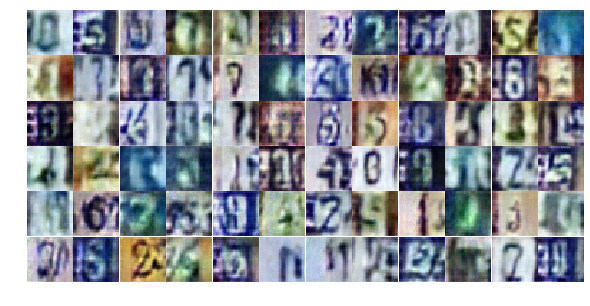

Epoch 7/25... Discriminator Loss: 0.5679... Generator Loss: 1.3210
Epoch 7/25... Discriminator Loss: 0.4104... Generator Loss: 1.7107
Epoch 7/25... Discriminator Loss: 0.8423... Generator Loss: 0.8215
Epoch 7/25... Discriminator Loss: 0.6011... Generator Loss: 1.3778
Epoch 7/25... Discriminator Loss: 0.4534... Generator Loss: 1.5176
Epoch 7/25... Discriminator Loss: 0.4170... Generator Loss: 1.6502
Epoch 7/25... Discriminator Loss: 0.7388... Generator Loss: 0.8840
Epoch 7/25... Discriminator Loss: 1.0086... Generator Loss: 0.6228
Epoch 7/25... Discriminator Loss: 0.3834... Generator Loss: 1.6516
Epoch 7/25... Discriminator Loss: 0.7560... Generator Loss: 1.8974


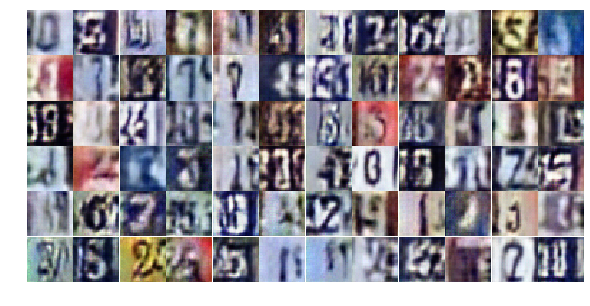

Epoch 7/25... Discriminator Loss: 0.9192... Generator Loss: 0.8289
Epoch 7/25... Discriminator Loss: 1.1013... Generator Loss: 0.5768
Epoch 7/25... Discriminator Loss: 0.7505... Generator Loss: 1.0220
Epoch 7/25... Discriminator Loss: 0.5005... Generator Loss: 1.3466
Epoch 7/25... Discriminator Loss: 0.6244... Generator Loss: 2.3025
Epoch 7/25... Discriminator Loss: 1.5361... Generator Loss: 0.3214
Epoch 7/25... Discriminator Loss: 0.6182... Generator Loss: 1.1448
Epoch 7/25... Discriminator Loss: 0.6100... Generator Loss: 1.1984
Epoch 7/25... Discriminator Loss: 0.9113... Generator Loss: 0.8143
Epoch 7/25... Discriminator Loss: 0.4491... Generator Loss: 2.0360


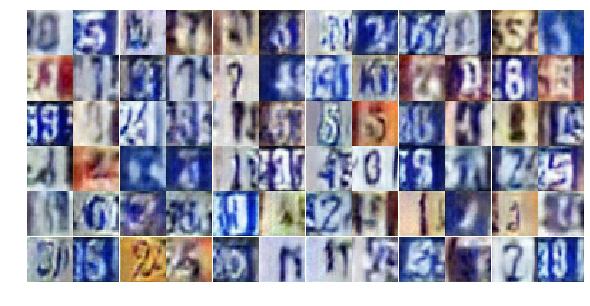

Epoch 7/25... Discriminator Loss: 0.9220... Generator Loss: 0.8197
Epoch 7/25... Discriminator Loss: 0.6445... Generator Loss: 1.0742
Epoch 7/25... Discriminator Loss: 0.3905... Generator Loss: 1.5998
Epoch 7/25... Discriminator Loss: 0.6079... Generator Loss: 1.1702
Epoch 7/25... Discriminator Loss: 0.7773... Generator Loss: 0.8813
Epoch 7/25... Discriminator Loss: 0.5398... Generator Loss: 1.1241
Epoch 7/25... Discriminator Loss: 0.6264... Generator Loss: 1.1157
Epoch 7/25... Discriminator Loss: 1.6181... Generator Loss: 2.6661
Epoch 7/25... Discriminator Loss: 0.6212... Generator Loss: 2.9500
Epoch 7/25... Discriminator Loss: 0.6808... Generator Loss: 1.2036


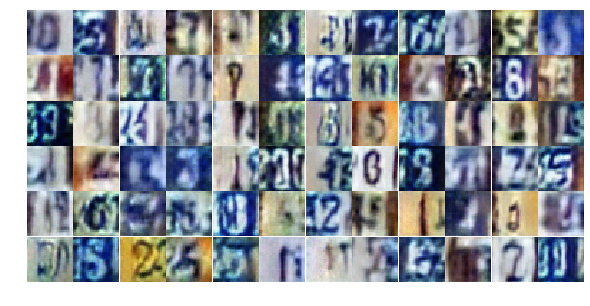

Epoch 7/25... Discriminator Loss: 0.3540... Generator Loss: 1.6563
Epoch 7/25... Discriminator Loss: 0.5772... Generator Loss: 1.2129
Epoch 7/25... Discriminator Loss: 0.6552... Generator Loss: 1.0772
Epoch 7/25... Discriminator Loss: 0.5810... Generator Loss: 1.2441
Epoch 7/25... Discriminator Loss: 0.5194... Generator Loss: 1.2919
Epoch 7/25... Discriminator Loss: 1.8417... Generator Loss: 0.2906
Epoch 7/25... Discriminator Loss: 1.3816... Generator Loss: 0.4006
Epoch 7/25... Discriminator Loss: 0.7806... Generator Loss: 1.2007
Epoch 7/25... Discriminator Loss: 0.9150... Generator Loss: 0.7394
Epoch 7/25... Discriminator Loss: 0.4028... Generator Loss: 1.5037


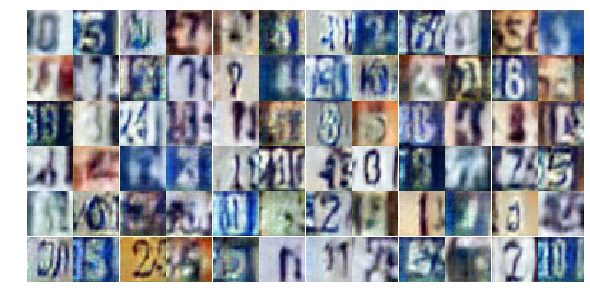

Epoch 7/25... Discriminator Loss: 0.5079... Generator Loss: 2.1451
Epoch 8/25... Discriminator Loss: 0.8008... Generator Loss: 0.8021
Epoch 8/25... Discriminator Loss: 0.7812... Generator Loss: 0.8140
Epoch 8/25... Discriminator Loss: 0.9810... Generator Loss: 0.6830
Epoch 8/25... Discriminator Loss: 0.4821... Generator Loss: 1.5570
Epoch 8/25... Discriminator Loss: 1.3110... Generator Loss: 0.4463
Epoch 8/25... Discriminator Loss: 0.5825... Generator Loss: 1.2317
Epoch 8/25... Discriminator Loss: 1.0466... Generator Loss: 2.9320
Epoch 8/25... Discriminator Loss: 0.8468... Generator Loss: 1.1726
Epoch 8/25... Discriminator Loss: 0.8283... Generator Loss: 0.7422


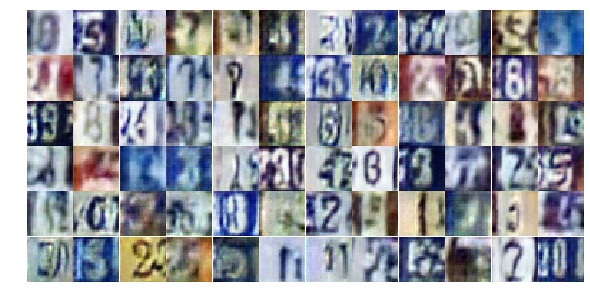

Epoch 8/25... Discriminator Loss: 0.5184... Generator Loss: 1.5880
Epoch 8/25... Discriminator Loss: 0.6398... Generator Loss: 1.0420
Epoch 8/25... Discriminator Loss: 0.9170... Generator Loss: 0.7320
Epoch 8/25... Discriminator Loss: 0.5138... Generator Loss: 1.4159
Epoch 8/25... Discriminator Loss: 0.9376... Generator Loss: 0.6932
Epoch 8/25... Discriminator Loss: 0.7615... Generator Loss: 3.1458
Epoch 8/25... Discriminator Loss: 0.5402... Generator Loss: 1.6364
Epoch 8/25... Discriminator Loss: 0.5271... Generator Loss: 1.5833
Epoch 8/25... Discriminator Loss: 0.8807... Generator Loss: 0.7519
Epoch 8/25... Discriminator Loss: 1.4003... Generator Loss: 0.3654


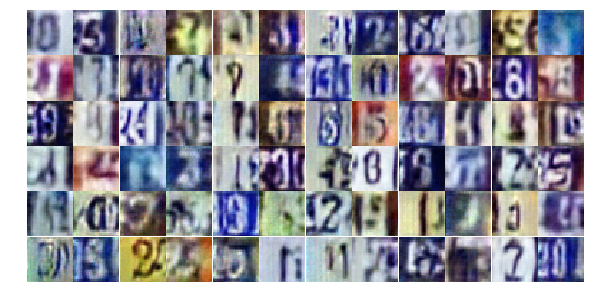

Epoch 8/25... Discriminator Loss: 0.4409... Generator Loss: 1.5732
Epoch 8/25... Discriminator Loss: 0.5396... Generator Loss: 1.3752
Epoch 8/25... Discriminator Loss: 0.7025... Generator Loss: 1.4984
Epoch 8/25... Discriminator Loss: 0.6127... Generator Loss: 1.6224
Epoch 8/25... Discriminator Loss: 0.4605... Generator Loss: 1.5205
Epoch 8/25... Discriminator Loss: 0.5126... Generator Loss: 1.4040
Epoch 8/25... Discriminator Loss: 0.7208... Generator Loss: 1.0000
Epoch 8/25... Discriminator Loss: 0.4253... Generator Loss: 1.7719
Epoch 8/25... Discriminator Loss: 0.6828... Generator Loss: 2.2072
Epoch 8/25... Discriminator Loss: 0.6546... Generator Loss: 1.1685


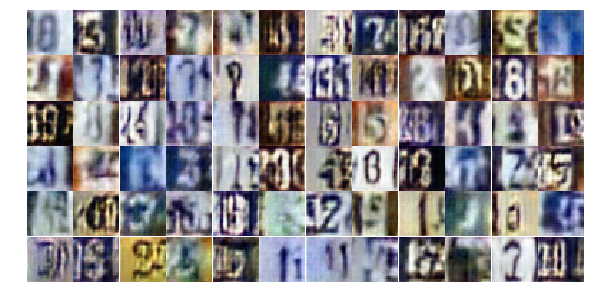

Epoch 8/25... Discriminator Loss: 0.8595... Generator Loss: 0.8053
Epoch 8/25... Discriminator Loss: 1.2996... Generator Loss: 0.5004
Epoch 8/25... Discriminator Loss: 0.6116... Generator Loss: 1.3493
Epoch 8/25... Discriminator Loss: 0.7200... Generator Loss: 0.9390
Epoch 8/25... Discriminator Loss: 0.9542... Generator Loss: 0.7019
Epoch 8/25... Discriminator Loss: 0.6304... Generator Loss: 1.0518
Epoch 8/25... Discriminator Loss: 0.4247... Generator Loss: 1.7200
Epoch 8/25... Discriminator Loss: 0.3198... Generator Loss: 2.0037
Epoch 8/25... Discriminator Loss: 0.6019... Generator Loss: 1.5800
Epoch 8/25... Discriminator Loss: 0.5760... Generator Loss: 1.2975


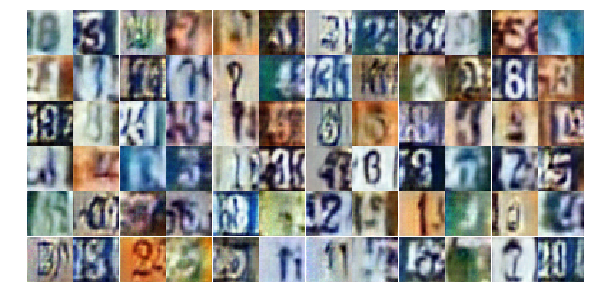

Epoch 8/25... Discriminator Loss: 0.3996... Generator Loss: 1.9558
Epoch 8/25... Discriminator Loss: 1.2074... Generator Loss: 0.4938
Epoch 8/25... Discriminator Loss: 0.5810... Generator Loss: 1.1239
Epoch 8/25... Discriminator Loss: 0.7203... Generator Loss: 0.8757
Epoch 8/25... Discriminator Loss: 1.1556... Generator Loss: 2.4785
Epoch 8/25... Discriminator Loss: 1.4060... Generator Loss: 0.4682
Epoch 8/25... Discriminator Loss: 0.6402... Generator Loss: 1.1794
Epoch 8/25... Discriminator Loss: 0.6399... Generator Loss: 1.0659
Epoch 8/25... Discriminator Loss: 0.5408... Generator Loss: 1.4265
Epoch 8/25... Discriminator Loss: 0.7217... Generator Loss: 1.0479


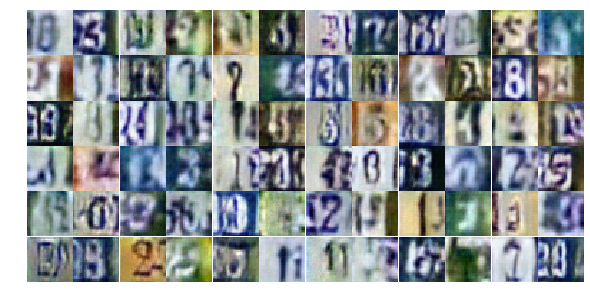

Epoch 8/25... Discriminator Loss: 0.4662... Generator Loss: 2.6799
Epoch 8/25... Discriminator Loss: 0.6229... Generator Loss: 1.1980
Epoch 8/25... Discriminator Loss: 0.6164... Generator Loss: 2.8166
Epoch 8/25... Discriminator Loss: 1.6104... Generator Loss: 0.3181
Epoch 8/25... Discriminator Loss: 0.4370... Generator Loss: 2.2733
Epoch 8/25... Discriminator Loss: 1.3030... Generator Loss: 0.4739
Epoch 8/25... Discriminator Loss: 0.6528... Generator Loss: 1.1057
Epoch 8/25... Discriminator Loss: 0.5946... Generator Loss: 1.4958
Epoch 9/25... Discriminator Loss: 1.0369... Generator Loss: 0.6644
Epoch 9/25... Discriminator Loss: 0.7496... Generator Loss: 0.8980


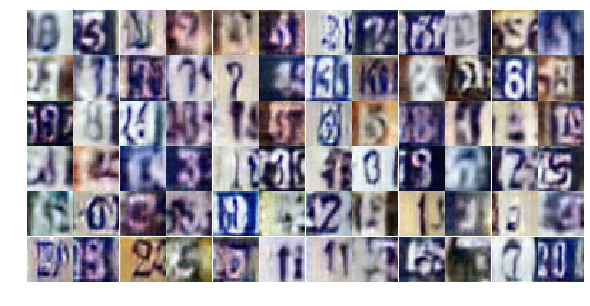

Epoch 9/25... Discriminator Loss: 0.6070... Generator Loss: 1.2005
Epoch 9/25... Discriminator Loss: 0.7099... Generator Loss: 1.0518
Epoch 9/25... Discriminator Loss: 1.2170... Generator Loss: 0.5076
Epoch 9/25... Discriminator Loss: 0.4355... Generator Loss: 1.8561
Epoch 9/25... Discriminator Loss: 2.1323... Generator Loss: 0.1888
Epoch 9/25... Discriminator Loss: 0.8258... Generator Loss: 2.0226
Epoch 9/25... Discriminator Loss: 0.9596... Generator Loss: 0.7707
Epoch 9/25... Discriminator Loss: 0.6186... Generator Loss: 1.1905
Epoch 9/25... Discriminator Loss: 0.8632... Generator Loss: 0.8835
Epoch 9/25... Discriminator Loss: 0.7177... Generator Loss: 1.0224


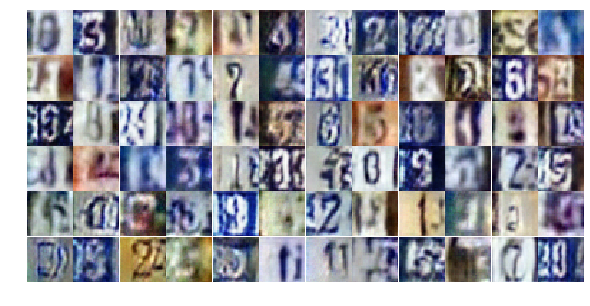

Epoch 9/25... Discriminator Loss: 0.8165... Generator Loss: 0.8473
Epoch 9/25... Discriminator Loss: 0.7580... Generator Loss: 0.9826
Epoch 9/25... Discriminator Loss: 0.7640... Generator Loss: 0.9472
Epoch 9/25... Discriminator Loss: 0.6167... Generator Loss: 1.0641
Epoch 9/25... Discriminator Loss: 0.5698... Generator Loss: 1.2205
Epoch 9/25... Discriminator Loss: 0.6004... Generator Loss: 2.1710
Epoch 9/25... Discriminator Loss: 0.9046... Generator Loss: 0.7546
Epoch 9/25... Discriminator Loss: 0.3086... Generator Loss: 2.0652
Epoch 9/25... Discriminator Loss: 1.4473... Generator Loss: 0.3767
Epoch 9/25... Discriminator Loss: 0.8551... Generator Loss: 0.8346


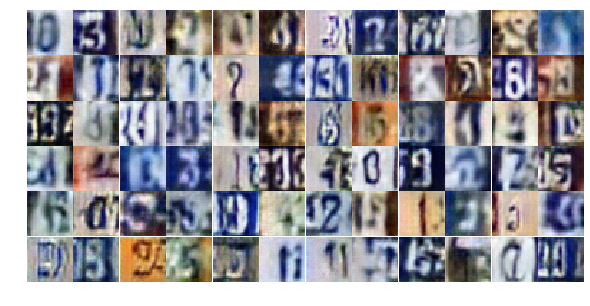

Epoch 9/25... Discriminator Loss: 0.9224... Generator Loss: 0.8209
Epoch 9/25... Discriminator Loss: 0.3804... Generator Loss: 1.7757
Epoch 9/25... Discriminator Loss: 0.6595... Generator Loss: 1.2482
Epoch 9/25... Discriminator Loss: 0.5602... Generator Loss: 1.2221
Epoch 9/25... Discriminator Loss: 0.5063... Generator Loss: 1.2910
Epoch 9/25... Discriminator Loss: 0.5086... Generator Loss: 1.4489
Epoch 9/25... Discriminator Loss: 1.7997... Generator Loss: 0.2880
Epoch 9/25... Discriminator Loss: 0.5129... Generator Loss: 1.5394
Epoch 9/25... Discriminator Loss: 0.9156... Generator Loss: 0.8332
Epoch 9/25... Discriminator Loss: 0.5913... Generator Loss: 1.1355


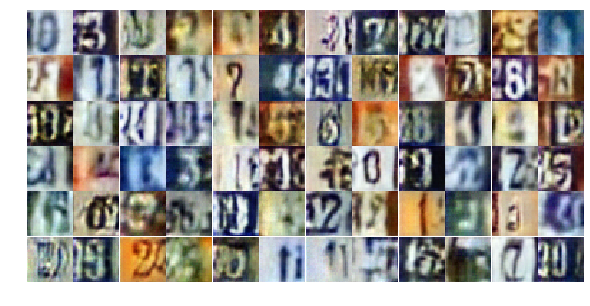

Epoch 9/25... Discriminator Loss: 0.7180... Generator Loss: 0.9096
Epoch 9/25... Discriminator Loss: 0.6755... Generator Loss: 1.0914
Epoch 9/25... Discriminator Loss: 0.7367... Generator Loss: 0.9066
Epoch 9/25... Discriminator Loss: 0.4965... Generator Loss: 1.3124
Epoch 9/25... Discriminator Loss: 0.6188... Generator Loss: 1.2308
Epoch 9/25... Discriminator Loss: 0.7980... Generator Loss: 0.8851
Epoch 9/25... Discriminator Loss: 0.5411... Generator Loss: 1.1913
Epoch 9/25... Discriminator Loss: 0.3543... Generator Loss: 1.6204
Epoch 9/25... Discriminator Loss: 0.9434... Generator Loss: 0.7293
Epoch 9/25... Discriminator Loss: 0.7702... Generator Loss: 0.8505


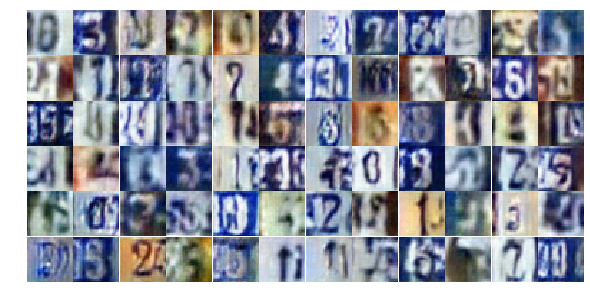

Epoch 9/25... Discriminator Loss: 0.4442... Generator Loss: 1.4601
Epoch 9/25... Discriminator Loss: 0.4786... Generator Loss: 1.7584
Epoch 9/25... Discriminator Loss: 0.5471... Generator Loss: 1.3120
Epoch 9/25... Discriminator Loss: 0.8321... Generator Loss: 1.2601
Epoch 9/25... Discriminator Loss: 0.5012... Generator Loss: 2.3572
Epoch 9/25... Discriminator Loss: 0.8133... Generator Loss: 0.8382
Epoch 9/25... Discriminator Loss: 0.5122... Generator Loss: 1.4408
Epoch 9/25... Discriminator Loss: 0.6431... Generator Loss: 1.0348
Epoch 9/25... Discriminator Loss: 0.6914... Generator Loss: 1.1807
Epoch 9/25... Discriminator Loss: 0.6714... Generator Loss: 2.1976


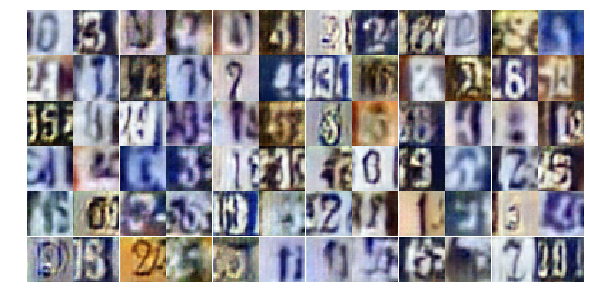

Epoch 9/25... Discriminator Loss: 0.6301... Generator Loss: 1.3540
Epoch 9/25... Discriminator Loss: 1.2510... Generator Loss: 3.8632
Epoch 9/25... Discriminator Loss: 0.7679... Generator Loss: 0.9720
Epoch 9/25... Discriminator Loss: 0.9989... Generator Loss: 0.6954
Epoch 9/25... Discriminator Loss: 0.5701... Generator Loss: 1.4463
Epoch 10/25... Discriminator Loss: 0.6576... Generator Loss: 1.2160
Epoch 10/25... Discriminator Loss: 0.6051... Generator Loss: 1.3135
Epoch 10/25... Discriminator Loss: 0.7337... Generator Loss: 0.9258
Epoch 10/25... Discriminator Loss: 0.8965... Generator Loss: 0.7736
Epoch 10/25... Discriminator Loss: 1.1681... Generator Loss: 0.5081


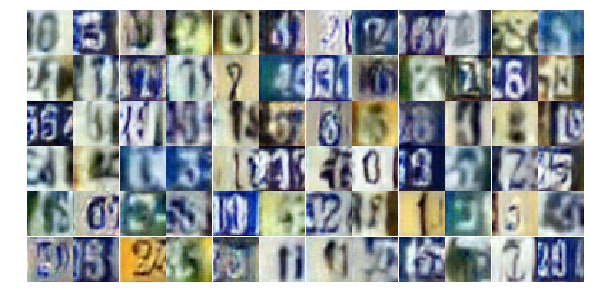

Epoch 10/25... Discriminator Loss: 0.7499... Generator Loss: 0.9941
Epoch 10/25... Discriminator Loss: 0.5826... Generator Loss: 1.1120
Epoch 10/25... Discriminator Loss: 0.4981... Generator Loss: 1.3580
Epoch 10/25... Discriminator Loss: 0.5945... Generator Loss: 1.6342
Epoch 10/25... Discriminator Loss: 0.6751... Generator Loss: 2.0128
Epoch 10/25... Discriminator Loss: 0.6269... Generator Loss: 1.2167
Epoch 10/25... Discriminator Loss: 0.4799... Generator Loss: 1.3388
Epoch 10/25... Discriminator Loss: 1.3670... Generator Loss: 0.3919
Epoch 10/25... Discriminator Loss: 2.0894... Generator Loss: 0.2093
Epoch 10/25... Discriminator Loss: 0.6977... Generator Loss: 1.2079


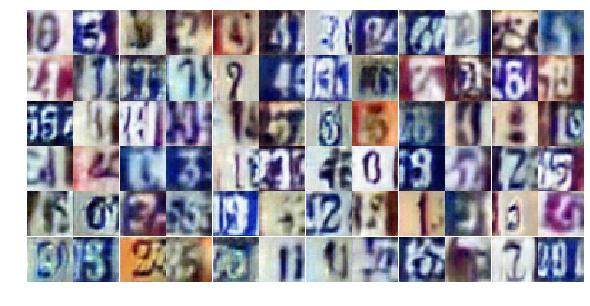

Epoch 10/25... Discriminator Loss: 0.6105... Generator Loss: 1.5634
Epoch 10/25... Discriminator Loss: 0.8235... Generator Loss: 0.7958
Epoch 10/25... Discriminator Loss: 0.6630... Generator Loss: 1.0327
Epoch 10/25... Discriminator Loss: 1.3451... Generator Loss: 0.4110
Epoch 10/25... Discriminator Loss: 0.7416... Generator Loss: 1.0777
Epoch 10/25... Discriminator Loss: 0.6100... Generator Loss: 1.1982
Epoch 10/25... Discriminator Loss: 0.6846... Generator Loss: 1.1542
Epoch 10/25... Discriminator Loss: 0.5402... Generator Loss: 1.5879
Epoch 10/25... Discriminator Loss: 0.6214... Generator Loss: 1.1131
Epoch 10/25... Discriminator Loss: 0.3929... Generator Loss: 2.0730


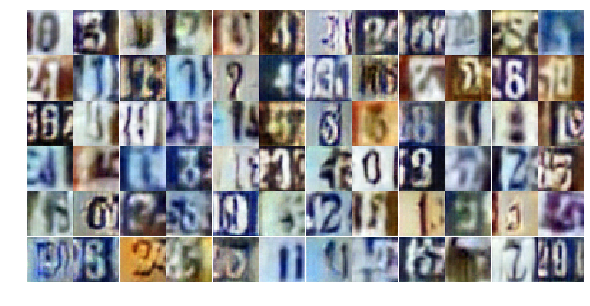

Epoch 10/25... Discriminator Loss: 1.1073... Generator Loss: 0.5283
Epoch 10/25... Discriminator Loss: 0.9592... Generator Loss: 0.7742
Epoch 10/25... Discriminator Loss: 0.4616... Generator Loss: 1.2895
Epoch 10/25... Discriminator Loss: 0.5345... Generator Loss: 1.5009
Epoch 10/25... Discriminator Loss: 1.5163... Generator Loss: 0.3132
Epoch 10/25... Discriminator Loss: 0.7757... Generator Loss: 0.9407
Epoch 10/25... Discriminator Loss: 0.4234... Generator Loss: 1.4384
Epoch 10/25... Discriminator Loss: 0.9608... Generator Loss: 0.9751
Epoch 10/25... Discriminator Loss: 0.7309... Generator Loss: 0.8768
Epoch 10/25... Discriminator Loss: 0.6554... Generator Loss: 1.1019


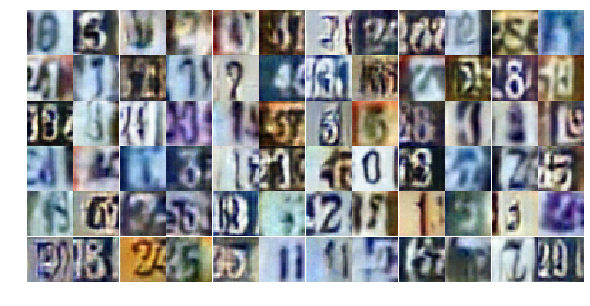

Epoch 10/25... Discriminator Loss: 0.5745... Generator Loss: 2.1879
Epoch 10/25... Discriminator Loss: 0.8484... Generator Loss: 0.8628
Epoch 10/25... Discriminator Loss: 0.4189... Generator Loss: 1.7096
Epoch 10/25... Discriminator Loss: 0.6450... Generator Loss: 1.5720
Epoch 10/25... Discriminator Loss: 0.7191... Generator Loss: 0.9465
Epoch 10/25... Discriminator Loss: 0.8347... Generator Loss: 0.8256
Epoch 10/25... Discriminator Loss: 2.4200... Generator Loss: 0.1690
Epoch 10/25... Discriminator Loss: 1.4896... Generator Loss: 0.3589
Epoch 10/25... Discriminator Loss: 0.6538... Generator Loss: 1.1085
Epoch 10/25... Discriminator Loss: 0.9898... Generator Loss: 2.4001


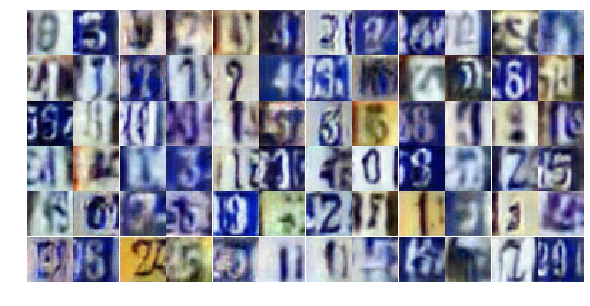

Epoch 10/25... Discriminator Loss: 0.7718... Generator Loss: 0.8792
Epoch 10/25... Discriminator Loss: 0.8168... Generator Loss: 0.9198
Epoch 10/25... Discriminator Loss: 0.7641... Generator Loss: 0.8992
Epoch 10/25... Discriminator Loss: 0.7562... Generator Loss: 0.9131
Epoch 10/25... Discriminator Loss: 0.3901... Generator Loss: 1.8251
Epoch 10/25... Discriminator Loss: 0.6778... Generator Loss: 1.0174
Epoch 10/25... Discriminator Loss: 0.5488... Generator Loss: 1.2438
Epoch 10/25... Discriminator Loss: 0.3979... Generator Loss: 1.8884
Epoch 10/25... Discriminator Loss: 0.8087... Generator Loss: 2.1352
Epoch 10/25... Discriminator Loss: 0.6670... Generator Loss: 1.2017


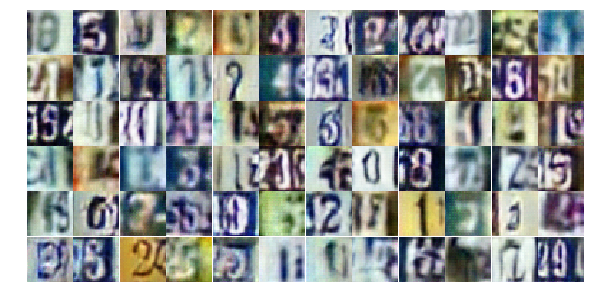

Epoch 10/25... Discriminator Loss: 0.8047... Generator Loss: 1.1620
Epoch 10/25... Discriminator Loss: 0.5256... Generator Loss: 1.2414
Epoch 10/25... Discriminator Loss: 0.5089... Generator Loss: 1.3265
Epoch 11/25... Discriminator Loss: 0.7271... Generator Loss: 0.9246
Epoch 11/25... Discriminator Loss: 0.4359... Generator Loss: 1.8558
Epoch 11/25... Discriminator Loss: 1.5394... Generator Loss: 0.3414
Epoch 11/25... Discriminator Loss: 0.7848... Generator Loss: 0.9412
Epoch 11/25... Discriminator Loss: 0.5670... Generator Loss: 1.6685
Epoch 11/25... Discriminator Loss: 1.3214... Generator Loss: 0.4625
Epoch 11/25... Discriminator Loss: 0.5633... Generator Loss: 1.4988


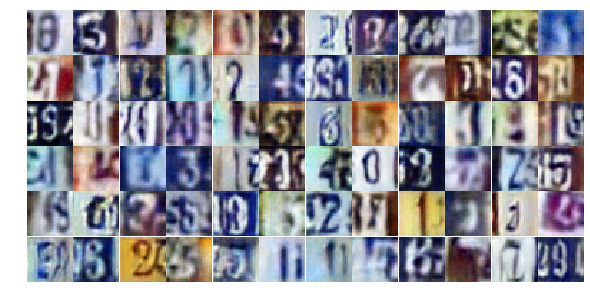

Epoch 11/25... Discriminator Loss: 0.4380... Generator Loss: 1.4302
Epoch 11/25... Discriminator Loss: 0.6808... Generator Loss: 1.0538
Epoch 11/25... Discriminator Loss: 0.4893... Generator Loss: 1.3643
Epoch 11/25... Discriminator Loss: 0.6233... Generator Loss: 1.1373
Epoch 11/25... Discriminator Loss: 1.0721... Generator Loss: 0.5923
Epoch 11/25... Discriminator Loss: 0.4239... Generator Loss: 1.6126
Epoch 11/25... Discriminator Loss: 0.6081... Generator Loss: 1.5445
Epoch 11/25... Discriminator Loss: 0.4145... Generator Loss: 1.9866
Epoch 11/25... Discriminator Loss: 1.0414... Generator Loss: 0.6389
Epoch 11/25... Discriminator Loss: 1.7195... Generator Loss: 0.3076


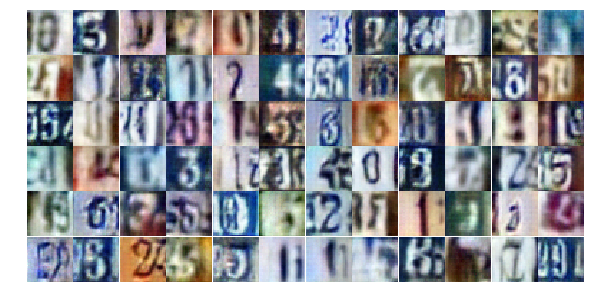

Epoch 11/25... Discriminator Loss: 0.7575... Generator Loss: 1.0171
Epoch 11/25... Discriminator Loss: 0.5232... Generator Loss: 2.0913
Epoch 11/25... Discriminator Loss: 0.9504... Generator Loss: 0.6702
Epoch 11/25... Discriminator Loss: 0.7795... Generator Loss: 0.9090
Epoch 11/25... Discriminator Loss: 0.3451... Generator Loss: 1.9541
Epoch 11/25... Discriminator Loss: 0.3712... Generator Loss: 1.9035
Epoch 11/25... Discriminator Loss: 0.8030... Generator Loss: 0.9099
Epoch 11/25... Discriminator Loss: 1.7853... Generator Loss: 0.2573
Epoch 11/25... Discriminator Loss: 0.6310... Generator Loss: 2.8863
Epoch 11/25... Discriminator Loss: 0.9907... Generator Loss: 0.6342


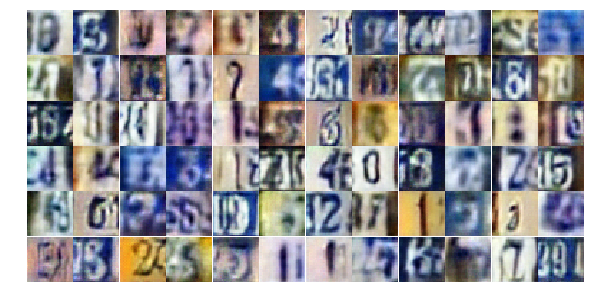

Epoch 11/25... Discriminator Loss: 0.9280... Generator Loss: 0.7123
Epoch 11/25... Discriminator Loss: 0.7418... Generator Loss: 0.9865
Epoch 11/25... Discriminator Loss: 0.7493... Generator Loss: 0.9510
Epoch 11/25... Discriminator Loss: 0.4510... Generator Loss: 1.5807
Epoch 11/25... Discriminator Loss: 0.6547... Generator Loss: 1.0572
Epoch 11/25... Discriminator Loss: 1.0590... Generator Loss: 0.6158
Epoch 11/25... Discriminator Loss: 1.2656... Generator Loss: 0.5000
Epoch 11/25... Discriminator Loss: 0.8235... Generator Loss: 0.8009
Epoch 11/25... Discriminator Loss: 0.5208... Generator Loss: 1.2545
Epoch 11/25... Discriminator Loss: 1.3720... Generator Loss: 0.4320


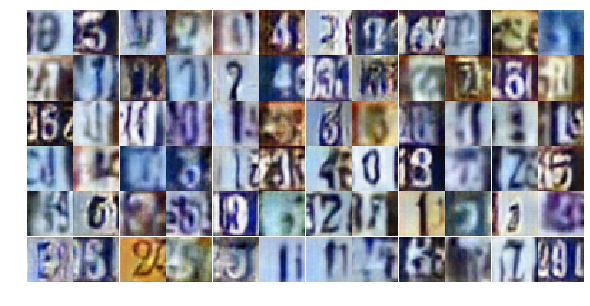

Epoch 11/25... Discriminator Loss: 0.5225... Generator Loss: 1.4892
Epoch 11/25... Discriminator Loss: 0.6745... Generator Loss: 0.9658
Epoch 11/25... Discriminator Loss: 0.6916... Generator Loss: 0.9675
Epoch 11/25... Discriminator Loss: 0.7689... Generator Loss: 1.1438
Epoch 11/25... Discriminator Loss: 0.7861... Generator Loss: 0.8260
Epoch 11/25... Discriminator Loss: 0.6785... Generator Loss: 1.1571
Epoch 11/25... Discriminator Loss: 0.2356... Generator Loss: 3.1330
Epoch 11/25... Discriminator Loss: 0.5628... Generator Loss: 1.5285
Epoch 11/25... Discriminator Loss: 1.2327... Generator Loss: 0.5241
Epoch 11/25... Discriminator Loss: 0.3570... Generator Loss: 1.7209


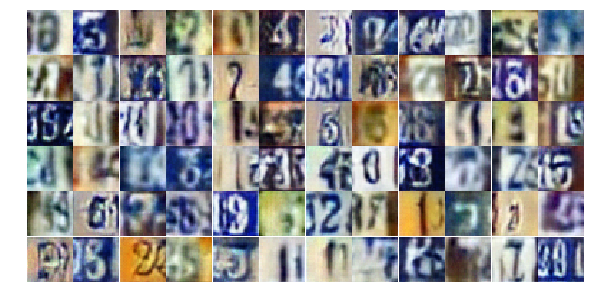

Epoch 11/25... Discriminator Loss: 0.8437... Generator Loss: 0.8099
Epoch 11/25... Discriminator Loss: 0.3862... Generator Loss: 1.8032
Epoch 11/25... Discriminator Loss: 1.2208... Generator Loss: 0.5187
Epoch 11/25... Discriminator Loss: 0.5979... Generator Loss: 1.1510
Epoch 11/25... Discriminator Loss: 1.2536... Generator Loss: 0.4572
Epoch 11/25... Discriminator Loss: 0.6817... Generator Loss: 1.0343
Epoch 11/25... Discriminator Loss: 1.6775... Generator Loss: 0.2993
Epoch 11/25... Discriminator Loss: 0.5813... Generator Loss: 1.5603
Epoch 11/25... Discriminator Loss: 0.9580... Generator Loss: 0.6753
Epoch 11/25... Discriminator Loss: 0.7014... Generator Loss: 1.1440


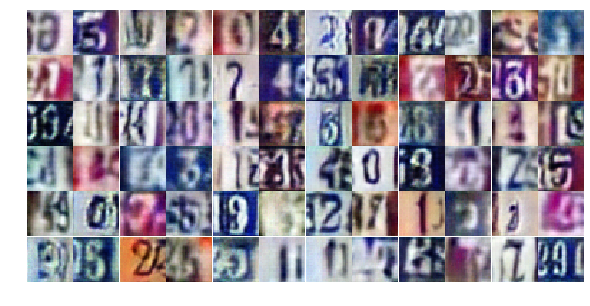

Epoch 12/25... Discriminator Loss: 0.6741... Generator Loss: 1.2431
Epoch 12/25... Discriminator Loss: 0.6946... Generator Loss: 1.2164
Epoch 12/25... Discriminator Loss: 1.3879... Generator Loss: 0.3872
Epoch 12/25... Discriminator Loss: 0.4548... Generator Loss: 1.6886
Epoch 12/25... Discriminator Loss: 0.4994... Generator Loss: 1.3289
Epoch 12/25... Discriminator Loss: 1.5826... Generator Loss: 0.3721
Epoch 12/25... Discriminator Loss: 0.5976... Generator Loss: 1.1674
Epoch 12/25... Discriminator Loss: 0.5488... Generator Loss: 1.8643
Epoch 12/25... Discriminator Loss: 0.7339... Generator Loss: 1.1102
Epoch 12/25... Discriminator Loss: 1.2767... Generator Loss: 0.4722


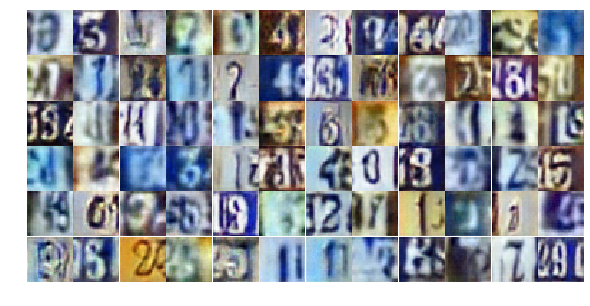

Epoch 12/25... Discriminator Loss: 0.5244... Generator Loss: 1.4041
Epoch 12/25... Discriminator Loss: 0.7956... Generator Loss: 0.8736
Epoch 12/25... Discriminator Loss: 0.5890... Generator Loss: 1.6263
Epoch 12/25... Discriminator Loss: 0.6613... Generator Loss: 1.8700
Epoch 12/25... Discriminator Loss: 0.5311... Generator Loss: 1.5308
Epoch 12/25... Discriminator Loss: 0.8221... Generator Loss: 0.7984
Epoch 12/25... Discriminator Loss: 1.6164... Generator Loss: 0.2855
Epoch 12/25... Discriminator Loss: 0.5503... Generator Loss: 2.1151
Epoch 12/25... Discriminator Loss: 0.4358... Generator Loss: 1.3922
Epoch 12/25... Discriminator Loss: 0.8226... Generator Loss: 0.8437


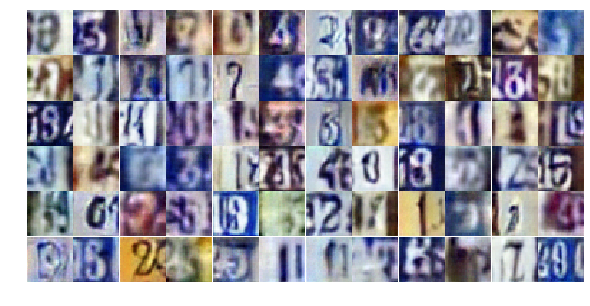

Epoch 12/25... Discriminator Loss: 0.4635... Generator Loss: 1.2602
Epoch 12/25... Discriminator Loss: 0.5093... Generator Loss: 1.2806
Epoch 12/25... Discriminator Loss: 0.5225... Generator Loss: 1.4863
Epoch 12/25... Discriminator Loss: 0.4465... Generator Loss: 1.8014
Epoch 12/25... Discriminator Loss: 0.4048... Generator Loss: 1.8848
Epoch 12/25... Discriminator Loss: 0.4717... Generator Loss: 1.6758
Epoch 12/25... Discriminator Loss: 0.5893... Generator Loss: 1.3143
Epoch 12/25... Discriminator Loss: 0.3692... Generator Loss: 1.7094
Epoch 12/25... Discriminator Loss: 0.5597... Generator Loss: 1.6029
Epoch 12/25... Discriminator Loss: 0.6814... Generator Loss: 0.9492


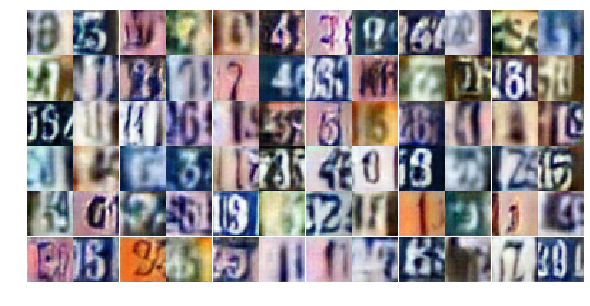

Epoch 12/25... Discriminator Loss: 0.6825... Generator Loss: 0.9673
Epoch 12/25... Discriminator Loss: 0.6319... Generator Loss: 1.1203
Epoch 12/25... Discriminator Loss: 0.9846... Generator Loss: 0.6500
Epoch 12/25... Discriminator Loss: 1.4675... Generator Loss: 0.3540
Epoch 12/25... Discriminator Loss: 0.5493... Generator Loss: 2.1963
Epoch 12/25... Discriminator Loss: 0.8663... Generator Loss: 0.8859
Epoch 12/25... Discriminator Loss: 1.0318... Generator Loss: 0.5911
Epoch 12/25... Discriminator Loss: 0.7409... Generator Loss: 1.1508
Epoch 12/25... Discriminator Loss: 0.4928... Generator Loss: 1.6575
Epoch 12/25... Discriminator Loss: 0.3152... Generator Loss: 1.6786


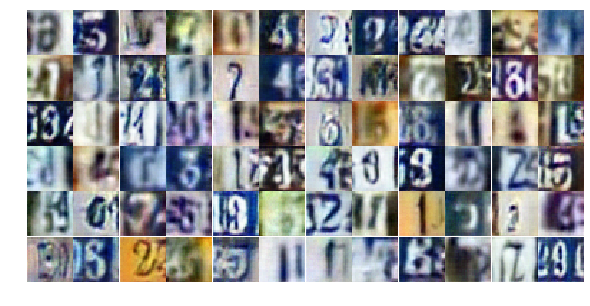

Epoch 12/25... Discriminator Loss: 0.5709... Generator Loss: 1.1292
Epoch 12/25... Discriminator Loss: 0.3618... Generator Loss: 1.9502
Epoch 12/25... Discriminator Loss: 0.5070... Generator Loss: 1.1982
Epoch 12/25... Discriminator Loss: 0.8438... Generator Loss: 0.7978
Epoch 12/25... Discriminator Loss: 0.6899... Generator Loss: 0.9988
Epoch 12/25... Discriminator Loss: 0.9194... Generator Loss: 0.6652
Epoch 12/25... Discriminator Loss: 0.8421... Generator Loss: 0.7967
Epoch 12/25... Discriminator Loss: 1.0583... Generator Loss: 0.5882
Epoch 12/25... Discriminator Loss: 1.6658... Generator Loss: 0.6982
Epoch 12/25... Discriminator Loss: 0.6063... Generator Loss: 1.8981


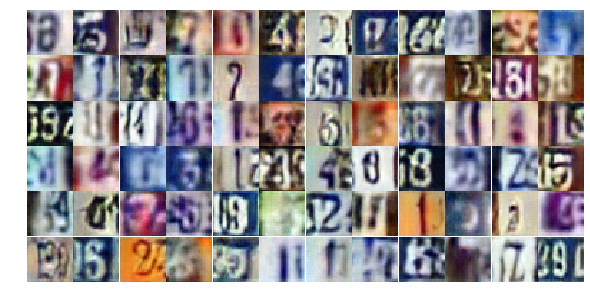

Epoch 12/25... Discriminator Loss: 0.8969... Generator Loss: 0.9102
Epoch 12/25... Discriminator Loss: 0.6033... Generator Loss: 1.1767
Epoch 12/25... Discriminator Loss: 0.8978... Generator Loss: 0.7637
Epoch 12/25... Discriminator Loss: 2.0559... Generator Loss: 0.2226
Epoch 12/25... Discriminator Loss: 0.7751... Generator Loss: 1.0399
Epoch 12/25... Discriminator Loss: 0.6761... Generator Loss: 2.0091
Epoch 12/25... Discriminator Loss: 0.6821... Generator Loss: 1.0418
Epoch 13/25... Discriminator Loss: 0.8528... Generator Loss: 0.7800
Epoch 13/25... Discriminator Loss: 0.4342... Generator Loss: 1.7184
Epoch 13/25... Discriminator Loss: 0.9889... Generator Loss: 0.6459


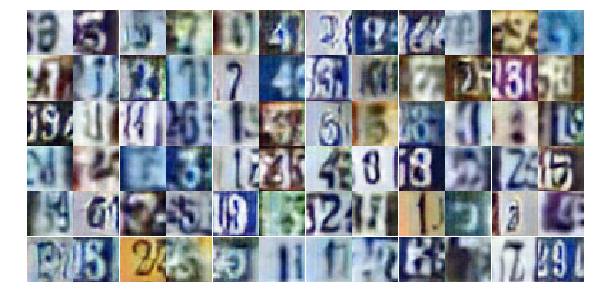

Epoch 13/25... Discriminator Loss: 0.5200... Generator Loss: 1.3021
Epoch 13/25... Discriminator Loss: 0.7639... Generator Loss: 2.3912
Epoch 13/25... Discriminator Loss: 1.4323... Generator Loss: 0.4023
Epoch 13/25... Discriminator Loss: 1.1842... Generator Loss: 0.5306
Epoch 13/25... Discriminator Loss: 0.5206... Generator Loss: 1.4033
Epoch 13/25... Discriminator Loss: 0.5850... Generator Loss: 1.2627
Epoch 13/25... Discriminator Loss: 0.4357... Generator Loss: 1.3577
Epoch 13/25... Discriminator Loss: 0.7465... Generator Loss: 0.9711
Epoch 13/25... Discriminator Loss: 0.6708... Generator Loss: 0.9869
Epoch 13/25... Discriminator Loss: 0.4986... Generator Loss: 1.8469


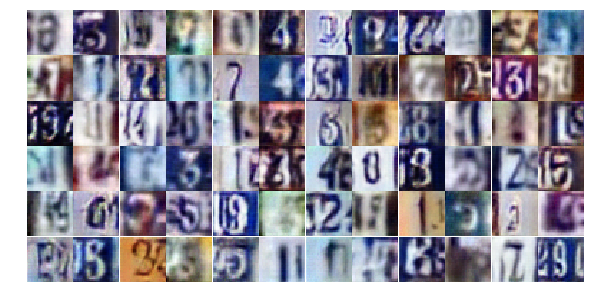

Epoch 13/25... Discriminator Loss: 0.7423... Generator Loss: 0.9575
Epoch 13/25... Discriminator Loss: 0.4634... Generator Loss: 1.5359
Epoch 13/25... Discriminator Loss: 1.1380... Generator Loss: 0.5966
Epoch 13/25... Discriminator Loss: 1.1266... Generator Loss: 0.5593
Epoch 13/25... Discriminator Loss: 0.4303... Generator Loss: 1.6545
Epoch 13/25... Discriminator Loss: 0.6930... Generator Loss: 1.0621
Epoch 13/25... Discriminator Loss: 0.6791... Generator Loss: 0.9921
Epoch 13/25... Discriminator Loss: 1.1298... Generator Loss: 0.5595
Epoch 13/25... Discriminator Loss: 0.6648... Generator Loss: 0.9813
Epoch 13/25... Discriminator Loss: 0.7627... Generator Loss: 0.8532


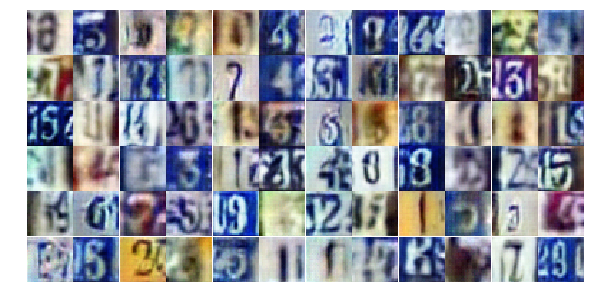

Epoch 13/25... Discriminator Loss: 0.7330... Generator Loss: 0.9107
Epoch 13/25... Discriminator Loss: 0.4936... Generator Loss: 1.5667
Epoch 13/25... Discriminator Loss: 0.6668... Generator Loss: 1.1547
Epoch 13/25... Discriminator Loss: 0.6961... Generator Loss: 0.9716
Epoch 13/25... Discriminator Loss: 0.7916... Generator Loss: 0.8853
Epoch 13/25... Discriminator Loss: 0.7153... Generator Loss: 0.9496
Epoch 13/25... Discriminator Loss: 0.7847... Generator Loss: 1.9624
Epoch 13/25... Discriminator Loss: 0.5724... Generator Loss: 1.3596
Epoch 13/25... Discriminator Loss: 0.6517... Generator Loss: 1.0412
Epoch 13/25... Discriminator Loss: 0.5193... Generator Loss: 1.4030


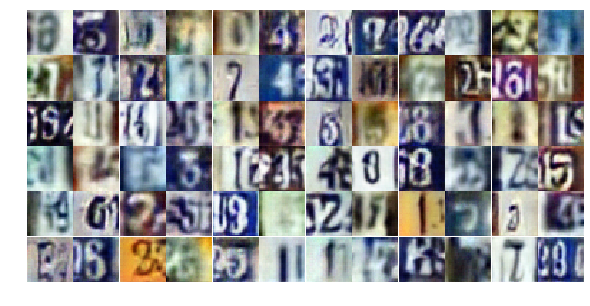

Epoch 13/25... Discriminator Loss: 1.1960... Generator Loss: 0.5454
Epoch 13/25... Discriminator Loss: 0.8291... Generator Loss: 0.8338
Epoch 13/25... Discriminator Loss: 1.5175... Generator Loss: 0.3603
Epoch 13/25... Discriminator Loss: 1.2130... Generator Loss: 0.4680
Epoch 13/25... Discriminator Loss: 0.7172... Generator Loss: 0.9831
Epoch 13/25... Discriminator Loss: 0.4714... Generator Loss: 1.5789
Epoch 13/25... Discriminator Loss: 0.3880... Generator Loss: 1.7947
Epoch 13/25... Discriminator Loss: 0.9036... Generator Loss: 0.7932
Epoch 13/25... Discriminator Loss: 0.6651... Generator Loss: 1.2966
Epoch 13/25... Discriminator Loss: 0.8225... Generator Loss: 0.8185


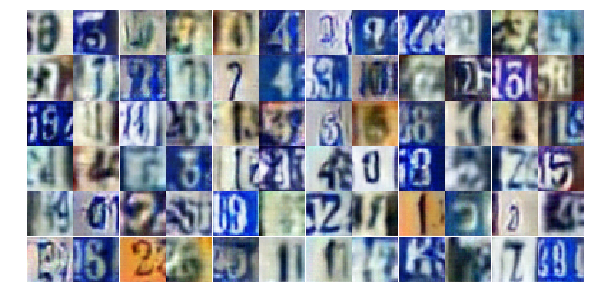

Epoch 13/25... Discriminator Loss: 0.7987... Generator Loss: 1.9430
Epoch 13/25... Discriminator Loss: 1.3953... Generator Loss: 0.4973
Epoch 13/25... Discriminator Loss: 0.9767... Generator Loss: 0.6836
Epoch 13/25... Discriminator Loss: 0.6644... Generator Loss: 0.9816
Epoch 13/25... Discriminator Loss: 1.0383... Generator Loss: 0.5956
Epoch 13/25... Discriminator Loss: 0.7343... Generator Loss: 0.9261
Epoch 13/25... Discriminator Loss: 0.7030... Generator Loss: 1.0346
Epoch 13/25... Discriminator Loss: 0.6870... Generator Loss: 1.0447
Epoch 13/25... Discriminator Loss: 1.4225... Generator Loss: 0.4165
Epoch 13/25... Discriminator Loss: 1.4372... Generator Loss: 0.3639


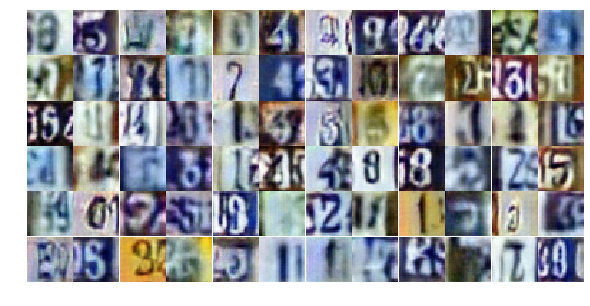

Epoch 13/25... Discriminator Loss: 0.3861... Generator Loss: 2.4287
Epoch 13/25... Discriminator Loss: 1.5735... Generator Loss: 0.3082
Epoch 13/25... Discriminator Loss: 0.6915... Generator Loss: 1.0355
Epoch 13/25... Discriminator Loss: 0.7889... Generator Loss: 0.8302
Epoch 14/25... Discriminator Loss: 0.9102... Generator Loss: 0.6947
Epoch 14/25... Discriminator Loss: 0.7038... Generator Loss: 1.0690
Epoch 14/25... Discriminator Loss: 0.8878... Generator Loss: 0.7648
Epoch 14/25... Discriminator Loss: 0.4571... Generator Loss: 1.6725
Epoch 14/25... Discriminator Loss: 0.4696... Generator Loss: 1.3444
Epoch 14/25... Discriminator Loss: 0.9329... Generator Loss: 0.7215


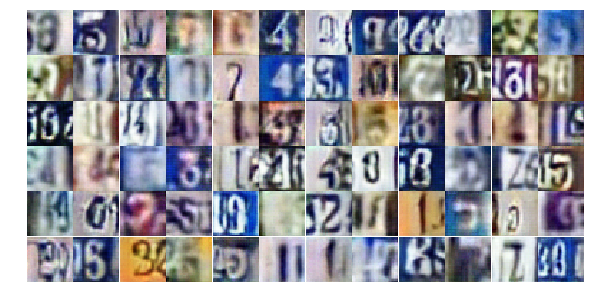

Epoch 14/25... Discriminator Loss: 0.7397... Generator Loss: 1.3582
Epoch 14/25... Discriminator Loss: 0.9555... Generator Loss: 0.7004
Epoch 14/25... Discriminator Loss: 0.7089... Generator Loss: 0.9017
Epoch 14/25... Discriminator Loss: 0.5503... Generator Loss: 1.1790
Epoch 14/25... Discriminator Loss: 0.9098... Generator Loss: 0.6823
Epoch 14/25... Discriminator Loss: 0.3945... Generator Loss: 1.5619
Epoch 14/25... Discriminator Loss: 0.4512... Generator Loss: 1.3777
Epoch 14/25... Discriminator Loss: 1.2649... Generator Loss: 0.4634
Epoch 14/25... Discriminator Loss: 1.1012... Generator Loss: 0.5908
Epoch 14/25... Discriminator Loss: 1.4712... Generator Loss: 0.4914


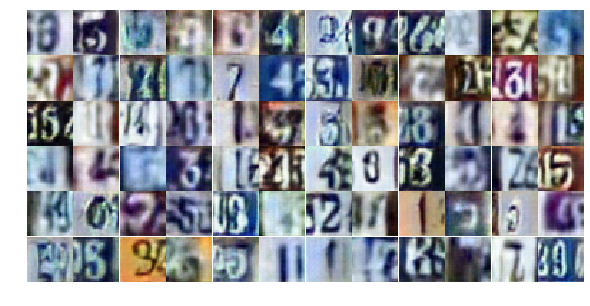

Epoch 14/25... Discriminator Loss: 0.5296... Generator Loss: 1.1046
Epoch 14/25... Discriminator Loss: 0.4613... Generator Loss: 1.8070
Epoch 14/25... Discriminator Loss: 0.8350... Generator Loss: 0.8106
Epoch 14/25... Discriminator Loss: 0.6134... Generator Loss: 1.1186
Epoch 14/25... Discriminator Loss: 0.6928... Generator Loss: 1.1930
Epoch 14/25... Discriminator Loss: 0.7104... Generator Loss: 0.9458
Epoch 14/25... Discriminator Loss: 0.6976... Generator Loss: 0.9533
Epoch 14/25... Discriminator Loss: 0.6109... Generator Loss: 1.0725
Epoch 14/25... Discriminator Loss: 0.6256... Generator Loss: 1.1237
Epoch 14/25... Discriminator Loss: 0.8233... Generator Loss: 3.3342


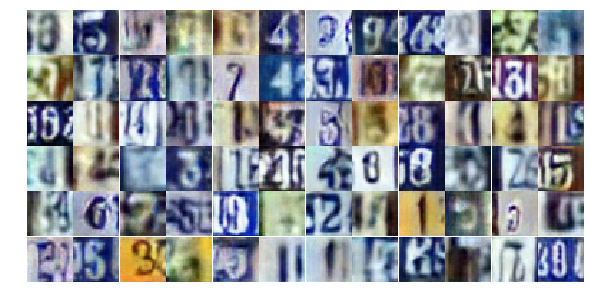

Epoch 14/25... Discriminator Loss: 4.9744... Generator Loss: 0.0983
Epoch 14/25... Discriminator Loss: 0.6292... Generator Loss: 1.2762
Epoch 14/25... Discriminator Loss: 0.6715... Generator Loss: 1.0964
Epoch 14/25... Discriminator Loss: 0.4969... Generator Loss: 1.4309
Epoch 14/25... Discriminator Loss: 0.6801... Generator Loss: 1.0952
Epoch 14/25... Discriminator Loss: 0.7326... Generator Loss: 0.9861
Epoch 14/25... Discriminator Loss: 0.9509... Generator Loss: 0.7277
Epoch 14/25... Discriminator Loss: 0.4555... Generator Loss: 1.6896
Epoch 14/25... Discriminator Loss: 0.5399... Generator Loss: 1.1956
Epoch 14/25... Discriminator Loss: 0.9982... Generator Loss: 0.7316


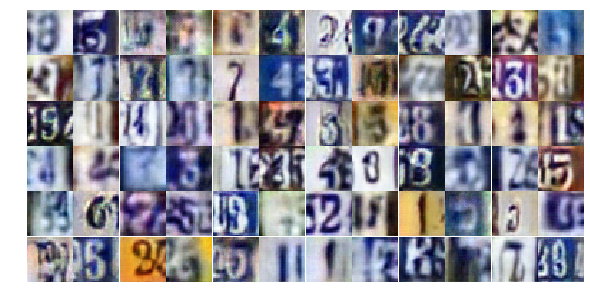

Epoch 14/25... Discriminator Loss: 1.3215... Generator Loss: 0.4588
Epoch 14/25... Discriminator Loss: 1.1372... Generator Loss: 0.5693
Epoch 14/25... Discriminator Loss: 0.7170... Generator Loss: 0.9766
Epoch 14/25... Discriminator Loss: 0.7437... Generator Loss: 0.8721
Epoch 14/25... Discriminator Loss: 0.8938... Generator Loss: 0.7665
Epoch 14/25... Discriminator Loss: 0.6441... Generator Loss: 1.3383
Epoch 14/25... Discriminator Loss: 0.6431... Generator Loss: 1.3918
Epoch 14/25... Discriminator Loss: 0.5437... Generator Loss: 1.2182
Epoch 14/25... Discriminator Loss: 0.9789... Generator Loss: 0.7396
Epoch 14/25... Discriminator Loss: 1.3892... Generator Loss: 0.3886


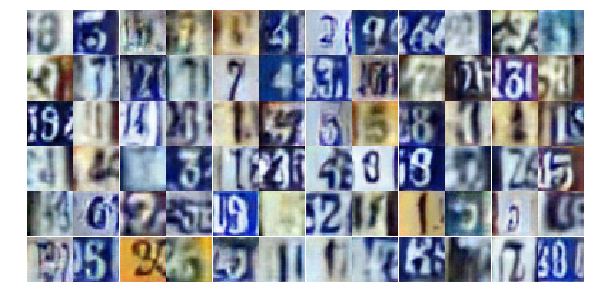

Epoch 14/25... Discriminator Loss: 0.8654... Generator Loss: 0.9987
Epoch 14/25... Discriminator Loss: 1.6901... Generator Loss: 0.3168
Epoch 14/25... Discriminator Loss: 0.5591... Generator Loss: 1.2650
Epoch 14/25... Discriminator Loss: 0.6356... Generator Loss: 1.0582
Epoch 14/25... Discriminator Loss: 0.6879... Generator Loss: 1.0462
Epoch 14/25... Discriminator Loss: 0.6843... Generator Loss: 1.1856
Epoch 14/25... Discriminator Loss: 0.7067... Generator Loss: 1.0715
Epoch 14/25... Discriminator Loss: 0.5278... Generator Loss: 1.2540
Epoch 14/25... Discriminator Loss: 1.2124... Generator Loss: 0.5062
Epoch 14/25... Discriminator Loss: 1.1955... Generator Loss: 0.4664


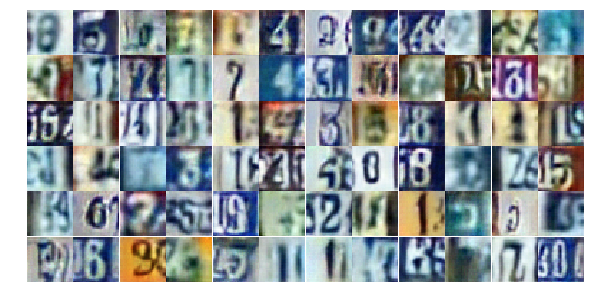

Epoch 14/25... Discriminator Loss: 0.7497... Generator Loss: 1.0205
Epoch 14/25... Discriminator Loss: 0.7690... Generator Loss: 0.9386
Epoch 15/25... Discriminator Loss: 0.9255... Generator Loss: 0.7349
Epoch 15/25... Discriminator Loss: 0.5834... Generator Loss: 1.2807
Epoch 15/25... Discriminator Loss: 0.5498... Generator Loss: 1.3676
Epoch 15/25... Discriminator Loss: 1.0445... Generator Loss: 0.6373
Epoch 15/25... Discriminator Loss: 0.8550... Generator Loss: 0.8175
Epoch 15/25... Discriminator Loss: 0.6118... Generator Loss: 1.0779
Epoch 15/25... Discriminator Loss: 1.4874... Generator Loss: 0.3624
Epoch 15/25... Discriminator Loss: 0.6725... Generator Loss: 1.0704


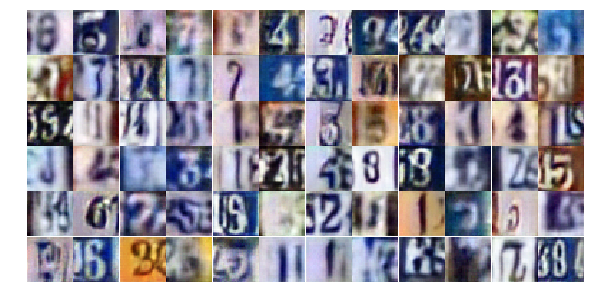

Epoch 15/25... Discriminator Loss: 1.2512... Generator Loss: 0.4825
Epoch 15/25... Discriminator Loss: 0.7345... Generator Loss: 1.2746
Epoch 15/25... Discriminator Loss: 0.6768... Generator Loss: 0.9841
Epoch 15/25... Discriminator Loss: 0.6427... Generator Loss: 1.0232
Epoch 15/25... Discriminator Loss: 0.7826... Generator Loss: 0.9072
Epoch 15/25... Discriminator Loss: 0.3041... Generator Loss: 1.8934
Epoch 15/25... Discriminator Loss: 1.0841... Generator Loss: 0.5763
Epoch 15/25... Discriminator Loss: 0.6316... Generator Loss: 1.6670
Epoch 15/25... Discriminator Loss: 0.7981... Generator Loss: 3.8941
Epoch 15/25... Discriminator Loss: 1.1576... Generator Loss: 0.6269


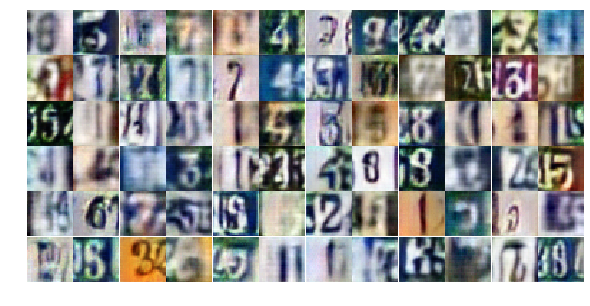

Epoch 15/25... Discriminator Loss: 1.4450... Generator Loss: 0.3948
Epoch 15/25... Discriminator Loss: 0.5701... Generator Loss: 1.1267
Epoch 15/25... Discriminator Loss: 0.5111... Generator Loss: 1.3865
Epoch 15/25... Discriminator Loss: 1.0266... Generator Loss: 0.6416
Epoch 15/25... Discriminator Loss: 0.9140... Generator Loss: 0.7869
Epoch 15/25... Discriminator Loss: 0.4976... Generator Loss: 1.4963
Epoch 15/25... Discriminator Loss: 1.2970... Generator Loss: 0.5164
Epoch 15/25... Discriminator Loss: 0.7702... Generator Loss: 0.9261
Epoch 15/25... Discriminator Loss: 0.8611... Generator Loss: 0.7346
Epoch 15/25... Discriminator Loss: 1.1976... Generator Loss: 0.5372


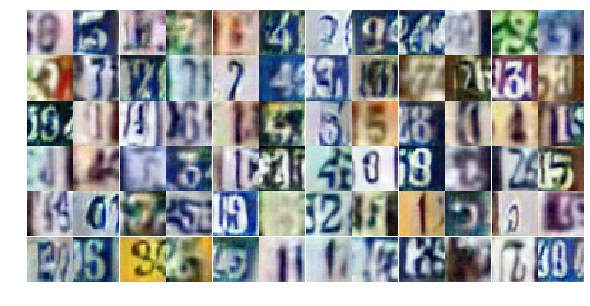

Epoch 15/25... Discriminator Loss: 0.7000... Generator Loss: 1.0102
Epoch 15/25... Discriminator Loss: 1.5615... Generator Loss: 0.3513
Epoch 15/25... Discriminator Loss: 0.6173... Generator Loss: 1.3674
Epoch 15/25... Discriminator Loss: 0.7236... Generator Loss: 1.6594
Epoch 15/25... Discriminator Loss: 0.4617... Generator Loss: 1.5469
Epoch 15/25... Discriminator Loss: 0.6766... Generator Loss: 1.0337
Epoch 15/25... Discriminator Loss: 0.4601... Generator Loss: 1.5240
Epoch 15/25... Discriminator Loss: 0.7930... Generator Loss: 0.7675
Epoch 15/25... Discriminator Loss: 0.5544... Generator Loss: 1.0653
Epoch 15/25... Discriminator Loss: 0.9593... Generator Loss: 0.6813


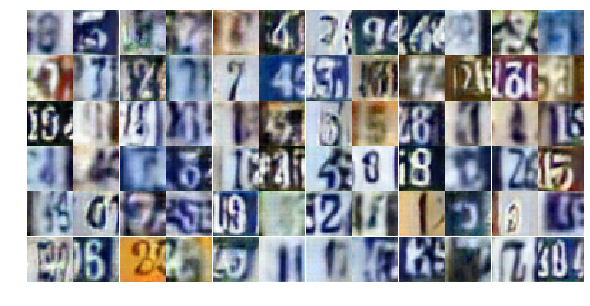

Epoch 15/25... Discriminator Loss: 0.6825... Generator Loss: 1.0041
Epoch 15/25... Discriminator Loss: 1.1889... Generator Loss: 0.5286
Epoch 15/25... Discriminator Loss: 0.5253... Generator Loss: 1.7426
Epoch 15/25... Discriminator Loss: 0.4836... Generator Loss: 1.5964
Epoch 15/25... Discriminator Loss: 0.4385... Generator Loss: 1.4200
Epoch 15/25... Discriminator Loss: 1.7025... Generator Loss: 0.2952
Epoch 15/25... Discriminator Loss: 0.5773... Generator Loss: 2.4628
Epoch 15/25... Discriminator Loss: 0.9370... Generator Loss: 2.1305
Epoch 15/25... Discriminator Loss: 1.0799... Generator Loss: 0.7026
Epoch 15/25... Discriminator Loss: 0.8204... Generator Loss: 0.8276


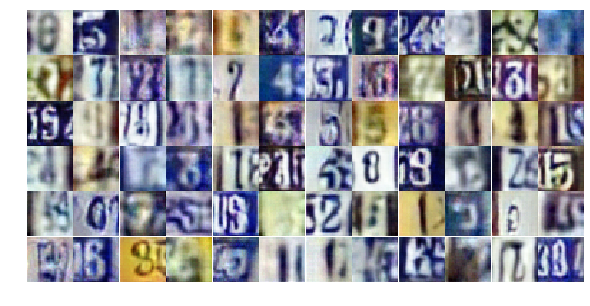

Epoch 15/25... Discriminator Loss: 0.9429... Generator Loss: 0.7024
Epoch 15/25... Discriminator Loss: 0.9187... Generator Loss: 0.7332
Epoch 15/25... Discriminator Loss: 0.6340... Generator Loss: 1.0392
Epoch 15/25... Discriminator Loss: 0.8448... Generator Loss: 0.9317
Epoch 15/25... Discriminator Loss: 0.5850... Generator Loss: 1.1642
Epoch 15/25... Discriminator Loss: 0.9482... Generator Loss: 2.1513
Epoch 15/25... Discriminator Loss: 1.3877... Generator Loss: 0.5176
Epoch 15/25... Discriminator Loss: 0.6306... Generator Loss: 1.2946
Epoch 15/25... Discriminator Loss: 1.3325... Generator Loss: 0.4254
Epoch 16/25... Discriminator Loss: 1.7869... Generator Loss: 0.2699


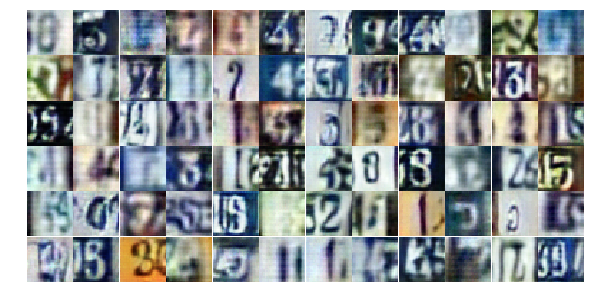

Epoch 16/25... Discriminator Loss: 0.6562... Generator Loss: 1.0537
Epoch 16/25... Discriminator Loss: 1.0612... Generator Loss: 0.6061
Epoch 16/25... Discriminator Loss: 1.0961... Generator Loss: 0.5908
Epoch 16/25... Discriminator Loss: 0.7976... Generator Loss: 0.9885
Epoch 16/25... Discriminator Loss: 0.5832... Generator Loss: 1.3530
Epoch 16/25... Discriminator Loss: 0.8676... Generator Loss: 0.8420
Epoch 16/25... Discriminator Loss: 1.5622... Generator Loss: 0.3316
Epoch 16/25... Discriminator Loss: 0.8034... Generator Loss: 0.9008
Epoch 16/25... Discriminator Loss: 0.4061... Generator Loss: 1.5338
Epoch 16/25... Discriminator Loss: 0.4903... Generator Loss: 1.9258


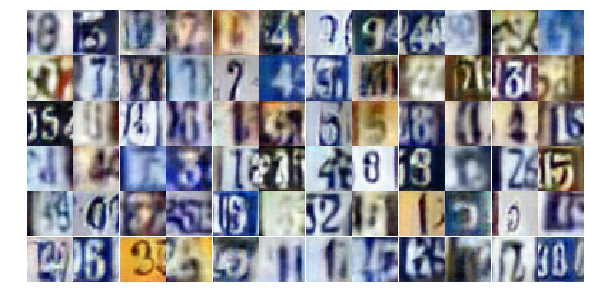

Epoch 16/25... Discriminator Loss: 1.7928... Generator Loss: 0.2629
Epoch 16/25... Discriminator Loss: 0.5438... Generator Loss: 1.3229
Epoch 16/25... Discriminator Loss: 0.5083... Generator Loss: 1.3778
Epoch 16/25... Discriminator Loss: 0.8841... Generator Loss: 0.7696
Epoch 16/25... Discriminator Loss: 0.4096... Generator Loss: 1.6020
Epoch 16/25... Discriminator Loss: 0.9558... Generator Loss: 0.6560
Epoch 16/25... Discriminator Loss: 2.9230... Generator Loss: 5.2346
Epoch 16/25... Discriminator Loss: 2.1521... Generator Loss: 0.7449
Epoch 16/25... Discriminator Loss: 1.6820... Generator Loss: 0.5527
Epoch 16/25... Discriminator Loss: 1.8936... Generator Loss: 0.4854


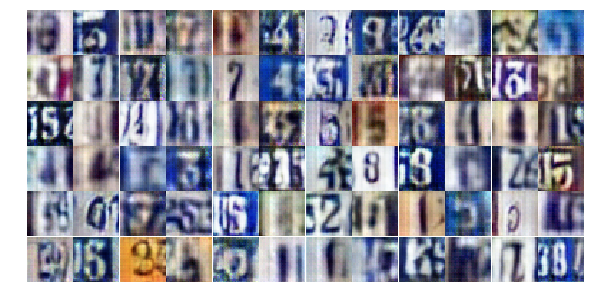

Epoch 16/25... Discriminator Loss: 1.8298... Generator Loss: 1.5913
Epoch 16/25... Discriminator Loss: 1.3559... Generator Loss: 1.3388
Epoch 16/25... Discriminator Loss: 1.4328... Generator Loss: 0.4615
Epoch 16/25... Discriminator Loss: 0.9977... Generator Loss: 1.6251
Epoch 16/25... Discriminator Loss: 0.8079... Generator Loss: 1.5406
Epoch 16/25... Discriminator Loss: 0.9897... Generator Loss: 0.6839
Epoch 16/25... Discriminator Loss: 0.7828... Generator Loss: 0.9014
Epoch 16/25... Discriminator Loss: 0.7621... Generator Loss: 0.9447
Epoch 16/25... Discriminator Loss: 0.8008... Generator Loss: 1.1268
Epoch 16/25... Discriminator Loss: 0.6840... Generator Loss: 1.0337


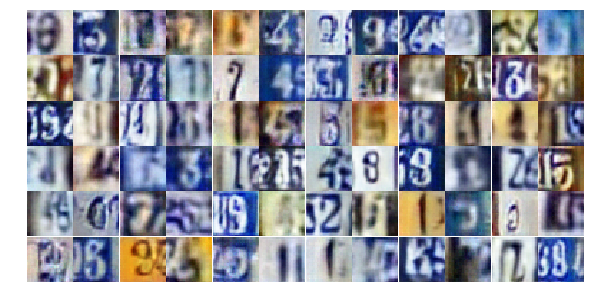

Epoch 16/25... Discriminator Loss: 0.8014... Generator Loss: 0.8284
Epoch 16/25... Discriminator Loss: 0.6737... Generator Loss: 1.0097
Epoch 16/25... Discriminator Loss: 0.7211... Generator Loss: 0.9760
Epoch 16/25... Discriminator Loss: 0.6193... Generator Loss: 1.4907
Epoch 16/25... Discriminator Loss: 0.9050... Generator Loss: 0.7987
Epoch 16/25... Discriminator Loss: 0.7077... Generator Loss: 1.5790
Epoch 16/25... Discriminator Loss: 0.8440... Generator Loss: 0.7646
Epoch 16/25... Discriminator Loss: 1.1361... Generator Loss: 0.5369
Epoch 16/25... Discriminator Loss: 0.6395... Generator Loss: 1.0245
Epoch 16/25... Discriminator Loss: 0.4810... Generator Loss: 1.4165


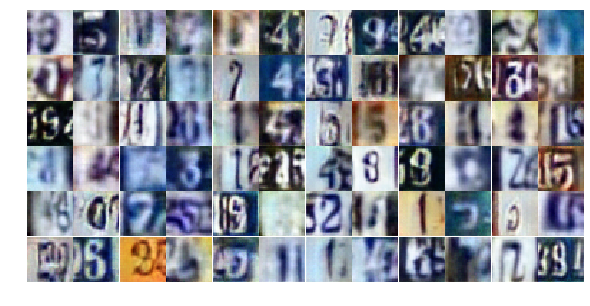

Epoch 16/25... Discriminator Loss: 0.5880... Generator Loss: 1.6132
Epoch 16/25... Discriminator Loss: 0.7342... Generator Loss: 0.8976
Epoch 16/25... Discriminator Loss: 0.9006... Generator Loss: 0.7322
Epoch 16/25... Discriminator Loss: 1.1718... Generator Loss: 0.5614
Epoch 16/25... Discriminator Loss: 0.7874... Generator Loss: 0.8881
Epoch 16/25... Discriminator Loss: 1.4142... Generator Loss: 0.4269
Epoch 16/25... Discriminator Loss: 0.4246... Generator Loss: 1.6037
Epoch 16/25... Discriminator Loss: 0.9575... Generator Loss: 0.6879
Epoch 16/25... Discriminator Loss: 0.6017... Generator Loss: 1.0491
Epoch 16/25... Discriminator Loss: 0.9502... Generator Loss: 0.6606


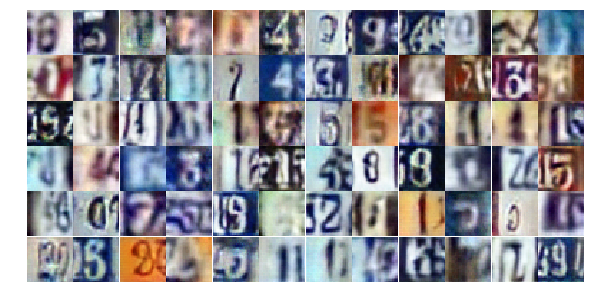

Epoch 16/25... Discriminator Loss: 1.6482... Generator Loss: 0.3382
Epoch 16/25... Discriminator Loss: 0.7691... Generator Loss: 1.2770
Epoch 16/25... Discriminator Loss: 1.0932... Generator Loss: 0.6419
Epoch 16/25... Discriminator Loss: 0.5788... Generator Loss: 1.1840
Epoch 16/25... Discriminator Loss: 0.6572... Generator Loss: 1.0232
Epoch 16/25... Discriminator Loss: 0.9215... Generator Loss: 0.7179
Epoch 17/25... Discriminator Loss: 0.8441... Generator Loss: 0.7690
Epoch 17/25... Discriminator Loss: 0.9782... Generator Loss: 0.6977
Epoch 17/25... Discriminator Loss: 0.7144... Generator Loss: 0.9867
Epoch 17/25... Discriminator Loss: 0.7505... Generator Loss: 1.0489


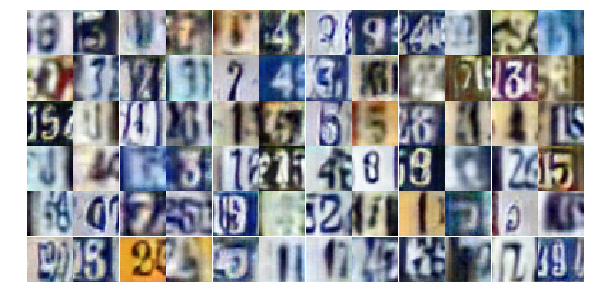

Epoch 17/25... Discriminator Loss: 0.4825... Generator Loss: 1.4012
Epoch 17/25... Discriminator Loss: 0.6680... Generator Loss: 0.9701
Epoch 17/25... Discriminator Loss: 0.7394... Generator Loss: 1.3071
Epoch 17/25... Discriminator Loss: 0.8892... Generator Loss: 0.7334
Epoch 17/25... Discriminator Loss: 1.1875... Generator Loss: 0.5052
Epoch 17/25... Discriminator Loss: 1.0948... Generator Loss: 0.5777
Epoch 17/25... Discriminator Loss: 0.8612... Generator Loss: 0.7854
Epoch 17/25... Discriminator Loss: 0.5911... Generator Loss: 1.0684
Epoch 17/25... Discriminator Loss: 0.5599... Generator Loss: 1.3678
Epoch 17/25... Discriminator Loss: 0.5986... Generator Loss: 2.0843


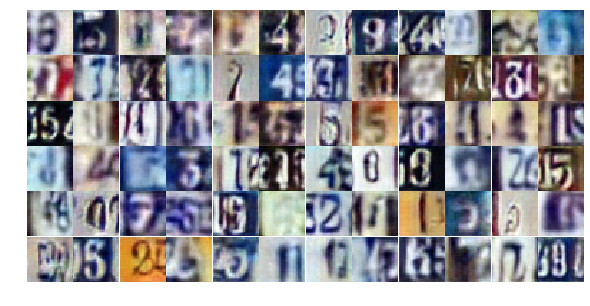

Epoch 17/25... Discriminator Loss: 0.6578... Generator Loss: 2.0759
Epoch 17/25... Discriminator Loss: 0.8147... Generator Loss: 0.8318
Epoch 17/25... Discriminator Loss: 0.5093... Generator Loss: 1.3015
Epoch 17/25... Discriminator Loss: 0.8816... Generator Loss: 2.4272
Epoch 17/25... Discriminator Loss: 0.4079... Generator Loss: 1.5765
Epoch 17/25... Discriminator Loss: 0.9267... Generator Loss: 0.6977
Epoch 17/25... Discriminator Loss: 0.6666... Generator Loss: 1.1137
Epoch 17/25... Discriminator Loss: 0.5924... Generator Loss: 1.1377
Epoch 17/25... Discriminator Loss: 0.9101... Generator Loss: 0.6949
Epoch 17/25... Discriminator Loss: 0.5206... Generator Loss: 1.2140


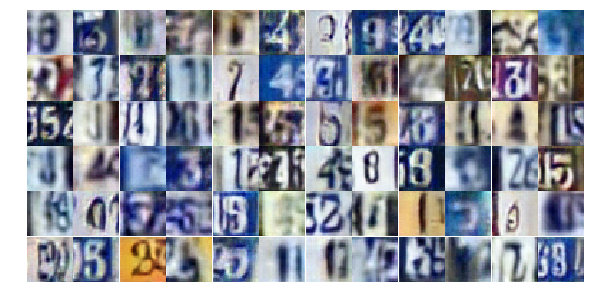

Epoch 17/25... Discriminator Loss: 2.0129... Generator Loss: 0.2613
Epoch 17/25... Discriminator Loss: 0.5387... Generator Loss: 1.7303
Epoch 17/25... Discriminator Loss: 0.6145... Generator Loss: 1.0679
Epoch 17/25... Discriminator Loss: 0.8953... Generator Loss: 0.7874
Epoch 17/25... Discriminator Loss: 1.0438... Generator Loss: 0.7196
Epoch 17/25... Discriminator Loss: 0.7596... Generator Loss: 0.8914
Epoch 17/25... Discriminator Loss: 0.6012... Generator Loss: 1.1091
Epoch 17/25... Discriminator Loss: 0.9295... Generator Loss: 0.7360
Epoch 17/25... Discriminator Loss: 0.9585... Generator Loss: 0.7706
Epoch 17/25... Discriminator Loss: 0.3327... Generator Loss: 2.0230


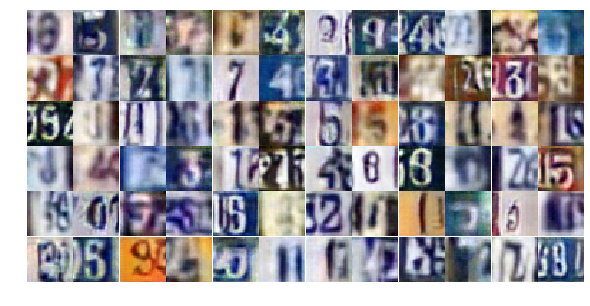

Epoch 17/25... Discriminator Loss: 0.8262... Generator Loss: 0.7781
Epoch 17/25... Discriminator Loss: 0.9823... Generator Loss: 0.6796
Epoch 17/25... Discriminator Loss: 0.5687... Generator Loss: 1.8770
Epoch 17/25... Discriminator Loss: 0.8258... Generator Loss: 0.8804
Epoch 17/25... Discriminator Loss: 0.8120... Generator Loss: 0.8287
Epoch 17/25... Discriminator Loss: 0.6333... Generator Loss: 1.0720
Epoch 17/25... Discriminator Loss: 0.7684... Generator Loss: 0.9790
Epoch 17/25... Discriminator Loss: 0.5719... Generator Loss: 1.5146
Epoch 17/25... Discriminator Loss: 0.4492... Generator Loss: 1.5214
Epoch 17/25... Discriminator Loss: 1.1716... Generator Loss: 0.5120


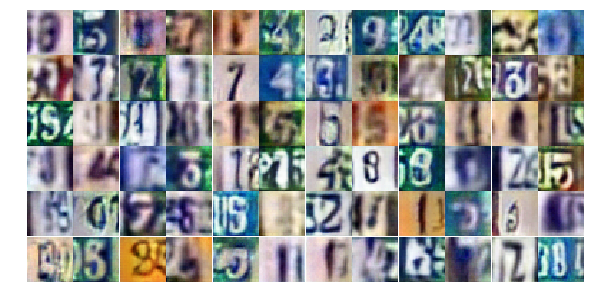

Epoch 17/25... Discriminator Loss: 0.7607... Generator Loss: 1.2243
Epoch 17/25... Discriminator Loss: 0.3013... Generator Loss: 1.7803
Epoch 17/25... Discriminator Loss: 2.0343... Generator Loss: 0.2930
Epoch 17/25... Discriminator Loss: 0.6969... Generator Loss: 3.3291
Epoch 17/25... Discriminator Loss: 0.8199... Generator Loss: 0.8671
Epoch 17/25... Discriminator Loss: 0.8685... Generator Loss: 0.7673
Epoch 17/25... Discriminator Loss: 1.1621... Generator Loss: 0.5595
Epoch 17/25... Discriminator Loss: 0.6302... Generator Loss: 1.1094
Epoch 17/25... Discriminator Loss: 0.6982... Generator Loss: 1.1730
Epoch 17/25... Discriminator Loss: 1.3725... Generator Loss: 0.4439


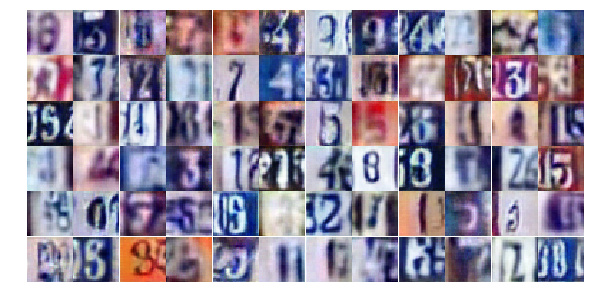

Epoch 17/25... Discriminator Loss: 1.1804... Generator Loss: 0.5126
Epoch 17/25... Discriminator Loss: 1.1807... Generator Loss: 0.5200
Epoch 17/25... Discriminator Loss: 0.5171... Generator Loss: 1.3992
Epoch 17/25... Discriminator Loss: 0.6133... Generator Loss: 1.4955
Epoch 18/25... Discriminator Loss: 1.0732... Generator Loss: 0.6113
Epoch 18/25... Discriminator Loss: 0.8192... Generator Loss: 0.8216
Epoch 18/25... Discriminator Loss: 0.6414... Generator Loss: 1.2390
Epoch 18/25... Discriminator Loss: 0.8099... Generator Loss: 0.8022
Epoch 18/25... Discriminator Loss: 0.9524... Generator Loss: 0.6850
Epoch 18/25... Discriminator Loss: 0.7343... Generator Loss: 1.0704


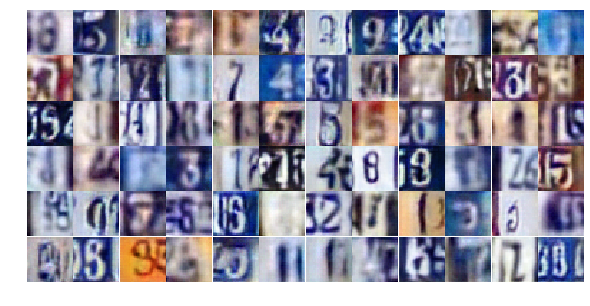

Epoch 18/25... Discriminator Loss: 0.5173... Generator Loss: 1.2056
Epoch 18/25... Discriminator Loss: 1.0135... Generator Loss: 0.6655
Epoch 18/25... Discriminator Loss: 0.9119... Generator Loss: 0.7364
Epoch 18/25... Discriminator Loss: 0.3514... Generator Loss: 2.1385
Epoch 18/25... Discriminator Loss: 0.5193... Generator Loss: 1.5864
Epoch 18/25... Discriminator Loss: 0.9664... Generator Loss: 0.7024
Epoch 18/25... Discriminator Loss: 0.5855... Generator Loss: 1.1260
Epoch 18/25... Discriminator Loss: 0.8851... Generator Loss: 0.7522
Epoch 18/25... Discriminator Loss: 0.5639... Generator Loss: 1.6789
Epoch 18/25... Discriminator Loss: 0.4236... Generator Loss: 1.9390


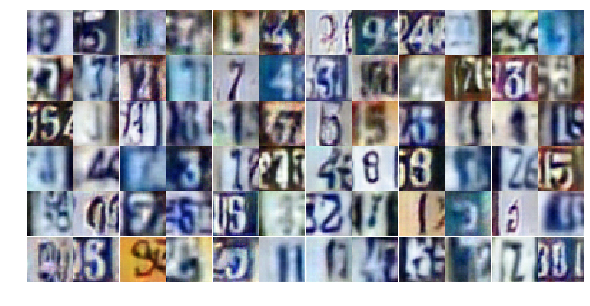

Epoch 18/25... Discriminator Loss: 0.6423... Generator Loss: 1.2043
Epoch 18/25... Discriminator Loss: 0.5624... Generator Loss: 1.5920
Epoch 18/25... Discriminator Loss: 1.2716... Generator Loss: 0.5254
Epoch 18/25... Discriminator Loss: 0.5123... Generator Loss: 1.3071
Epoch 18/25... Discriminator Loss: 0.9519... Generator Loss: 0.7339
Epoch 18/25... Discriminator Loss: 1.1258... Generator Loss: 0.6272
Epoch 18/25... Discriminator Loss: 0.8380... Generator Loss: 0.9046
Epoch 18/25... Discriminator Loss: 0.9718... Generator Loss: 0.6901
Epoch 18/25... Discriminator Loss: 1.2395... Generator Loss: 0.4915
Epoch 18/25... Discriminator Loss: 0.4593... Generator Loss: 1.3074


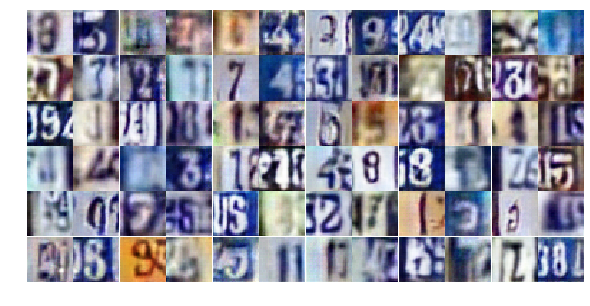

Epoch 18/25... Discriminator Loss: 0.5221... Generator Loss: 1.9102
Epoch 18/25... Discriminator Loss: 0.6383... Generator Loss: 1.3810
Epoch 18/25... Discriminator Loss: 0.7530... Generator Loss: 0.8516
Epoch 18/25... Discriminator Loss: 0.6932... Generator Loss: 1.2966
Epoch 18/25... Discriminator Loss: 1.0567... Generator Loss: 0.6329
Epoch 18/25... Discriminator Loss: 0.6492... Generator Loss: 1.1110
Epoch 18/25... Discriminator Loss: 0.6888... Generator Loss: 1.1670
Epoch 18/25... Discriminator Loss: 0.4625... Generator Loss: 1.6548
Epoch 18/25... Discriminator Loss: 0.5004... Generator Loss: 1.2731
Epoch 18/25... Discriminator Loss: 0.9509... Generator Loss: 0.7321


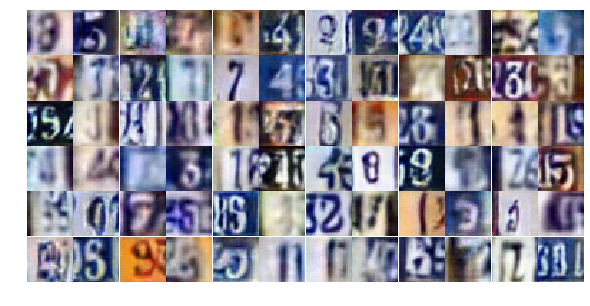

Epoch 18/25... Discriminator Loss: 0.6523... Generator Loss: 1.1323
Epoch 18/25... Discriminator Loss: 0.7957... Generator Loss: 0.8286
Epoch 18/25... Discriminator Loss: 0.6979... Generator Loss: 1.0483
Epoch 18/25... Discriminator Loss: 0.7666... Generator Loss: 0.9436
Epoch 18/25... Discriminator Loss: 0.8201... Generator Loss: 1.0169
Epoch 18/25... Discriminator Loss: 0.5168... Generator Loss: 1.2807
Epoch 18/25... Discriminator Loss: 0.4926... Generator Loss: 1.2786
Epoch 18/25... Discriminator Loss: 1.0365... Generator Loss: 2.1665
Epoch 18/25... Discriminator Loss: 0.7513... Generator Loss: 1.2897
Epoch 18/25... Discriminator Loss: 0.3625... Generator Loss: 2.0003


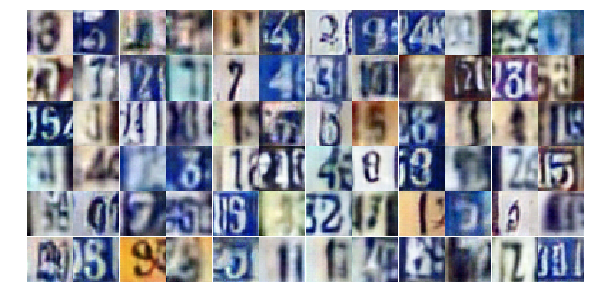

Epoch 18/25... Discriminator Loss: 0.9656... Generator Loss: 0.6702
Epoch 18/25... Discriminator Loss: 0.6622... Generator Loss: 1.0419
Epoch 18/25... Discriminator Loss: 0.5714... Generator Loss: 1.1646
Epoch 18/25... Discriminator Loss: 0.9323... Generator Loss: 0.7110
Epoch 18/25... Discriminator Loss: 1.1329... Generator Loss: 0.5321
Epoch 18/25... Discriminator Loss: 2.8200... Generator Loss: 0.1090
Epoch 18/25... Discriminator Loss: 0.7234... Generator Loss: 2.0518
Epoch 18/25... Discriminator Loss: 0.5065... Generator Loss: 1.5385
Epoch 18/25... Discriminator Loss: 0.9084... Generator Loss: 0.8537
Epoch 18/25... Discriminator Loss: 0.7666... Generator Loss: 0.9088


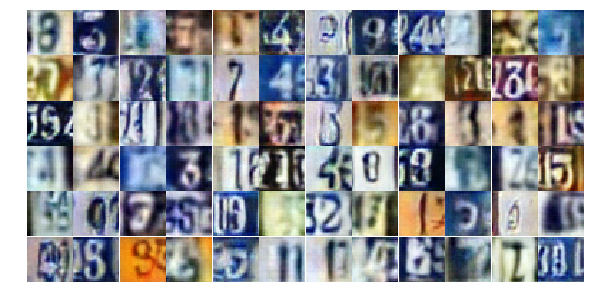

Epoch 18/25... Discriminator Loss: 0.5328... Generator Loss: 1.4400
Epoch 19/25... Discriminator Loss: 0.8630... Generator Loss: 0.9563
Epoch 19/25... Discriminator Loss: 1.1628... Generator Loss: 0.5253
Epoch 19/25... Discriminator Loss: 0.8337... Generator Loss: 0.9484
Epoch 19/25... Discriminator Loss: 0.6685... Generator Loss: 1.0975
Epoch 19/25... Discriminator Loss: 0.9998... Generator Loss: 0.7165
Epoch 19/25... Discriminator Loss: 0.4477... Generator Loss: 1.7422
Epoch 19/25... Discriminator Loss: 1.0281... Generator Loss: 0.6989
Epoch 19/25... Discriminator Loss: 0.5990... Generator Loss: 1.3828
Epoch 19/25... Discriminator Loss: 0.9761... Generator Loss: 0.7294


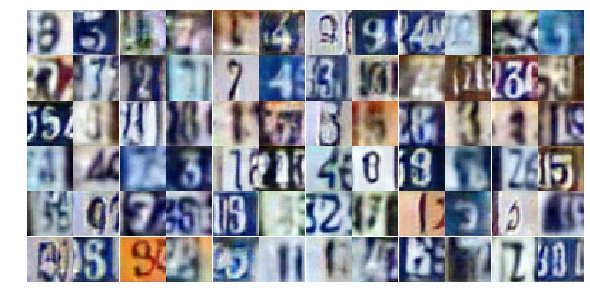

Epoch 19/25... Discriminator Loss: 0.6615... Generator Loss: 1.0509
Epoch 19/25... Discriminator Loss: 1.3838... Generator Loss: 0.4059
Epoch 19/25... Discriminator Loss: 0.6759... Generator Loss: 1.3471
Epoch 19/25... Discriminator Loss: 0.9936... Generator Loss: 0.6280
Epoch 19/25... Discriminator Loss: 0.9720... Generator Loss: 0.6431
Epoch 19/25... Discriminator Loss: 0.7173... Generator Loss: 0.9666
Epoch 19/25... Discriminator Loss: 0.8602... Generator Loss: 0.8077
Epoch 19/25... Discriminator Loss: 0.6838... Generator Loss: 0.9987
Epoch 19/25... Discriminator Loss: 0.5399... Generator Loss: 1.9673
Epoch 19/25... Discriminator Loss: 0.9498... Generator Loss: 0.7531


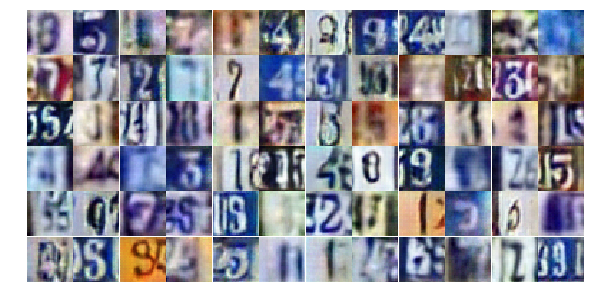

Epoch 19/25... Discriminator Loss: 0.8977... Generator Loss: 0.7467
Epoch 19/25... Discriminator Loss: 1.0416... Generator Loss: 0.6859
Epoch 19/25... Discriminator Loss: 1.4568... Generator Loss: 0.4395
Epoch 19/25... Discriminator Loss: 1.6217... Generator Loss: 0.4151
Epoch 19/25... Discriminator Loss: 1.1053... Generator Loss: 0.6526
Epoch 19/25... Discriminator Loss: 0.9951... Generator Loss: 0.6692
Epoch 19/25... Discriminator Loss: 0.5542... Generator Loss: 1.3047
Epoch 19/25... Discriminator Loss: 0.7190... Generator Loss: 1.1166
Epoch 19/25... Discriminator Loss: 0.8418... Generator Loss: 0.7580
Epoch 19/25... Discriminator Loss: 1.1318... Generator Loss: 0.5820


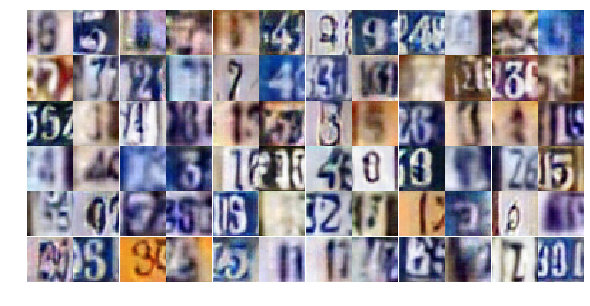

Epoch 19/25... Discriminator Loss: 0.8975... Generator Loss: 0.8056
Epoch 19/25... Discriminator Loss: 0.7392... Generator Loss: 0.8699
Epoch 19/25... Discriminator Loss: 0.8387... Generator Loss: 0.8063
Epoch 19/25... Discriminator Loss: 0.7092... Generator Loss: 0.9851
Epoch 19/25... Discriminator Loss: 0.7447... Generator Loss: 1.3063
Epoch 19/25... Discriminator Loss: 1.4110... Generator Loss: 0.4091
Epoch 19/25... Discriminator Loss: 0.5721... Generator Loss: 1.5895
Epoch 19/25... Discriminator Loss: 0.5704... Generator Loss: 1.1745
Epoch 19/25... Discriminator Loss: 0.9104... Generator Loss: 0.9637
Epoch 19/25... Discriminator Loss: 0.4602... Generator Loss: 1.6108


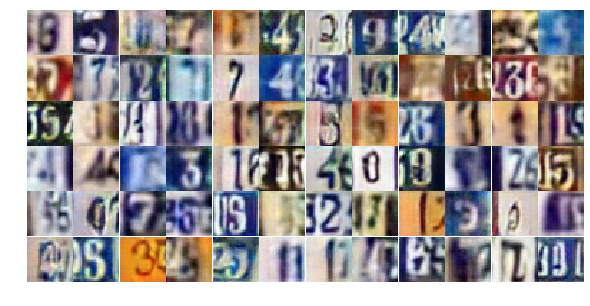

Epoch 19/25... Discriminator Loss: 0.6321... Generator Loss: 1.0666
Epoch 19/25... Discriminator Loss: 0.9339... Generator Loss: 0.7662
Epoch 19/25... Discriminator Loss: 1.0732... Generator Loss: 0.5628
Epoch 19/25... Discriminator Loss: 0.6569... Generator Loss: 1.0191
Epoch 19/25... Discriminator Loss: 0.6315... Generator Loss: 1.0518
Epoch 19/25... Discriminator Loss: 0.5298... Generator Loss: 1.6771
Epoch 19/25... Discriminator Loss: 0.8820... Generator Loss: 0.7776
Epoch 19/25... Discriminator Loss: 0.4607... Generator Loss: 1.6415
Epoch 19/25... Discriminator Loss: 0.6868... Generator Loss: 1.1283
Epoch 19/25... Discriminator Loss: 0.7097... Generator Loss: 1.1092


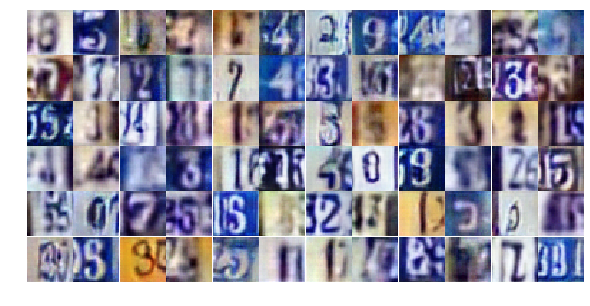

Epoch 19/25... Discriminator Loss: 0.6917... Generator Loss: 0.9462
Epoch 19/25... Discriminator Loss: 0.5830... Generator Loss: 1.3504
Epoch 19/25... Discriminator Loss: 0.5907... Generator Loss: 2.0063
Epoch 19/25... Discriminator Loss: 0.9528... Generator Loss: 0.6949
Epoch 19/25... Discriminator Loss: 0.8369... Generator Loss: 0.8810
Epoch 19/25... Discriminator Loss: 0.6529... Generator Loss: 1.1291
Epoch 19/25... Discriminator Loss: 1.4400... Generator Loss: 0.4207
Epoch 19/25... Discriminator Loss: 0.6595... Generator Loss: 1.0036
Epoch 20/25... Discriminator Loss: 1.0459... Generator Loss: 0.6576
Epoch 20/25... Discriminator Loss: 0.5791... Generator Loss: 1.3649


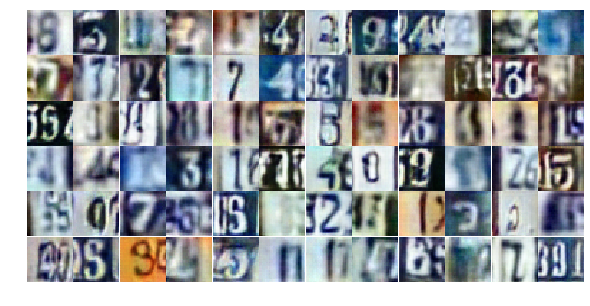

Epoch 20/25... Discriminator Loss: 0.6665... Generator Loss: 1.0891
Epoch 20/25... Discriminator Loss: 0.7032... Generator Loss: 1.1404
Epoch 20/25... Discriminator Loss: 1.5288... Generator Loss: 0.4332
Epoch 20/25... Discriminator Loss: 1.3348... Generator Loss: 0.4350
Epoch 20/25... Discriminator Loss: 0.5144... Generator Loss: 1.6195
Epoch 20/25... Discriminator Loss: 0.8495... Generator Loss: 0.8572
Epoch 20/25... Discriminator Loss: 0.6279... Generator Loss: 1.3456
Epoch 20/25... Discriminator Loss: 1.0429... Generator Loss: 0.6755
Epoch 20/25... Discriminator Loss: 0.9202... Generator Loss: 0.7067
Epoch 20/25... Discriminator Loss: 0.7120... Generator Loss: 0.9383


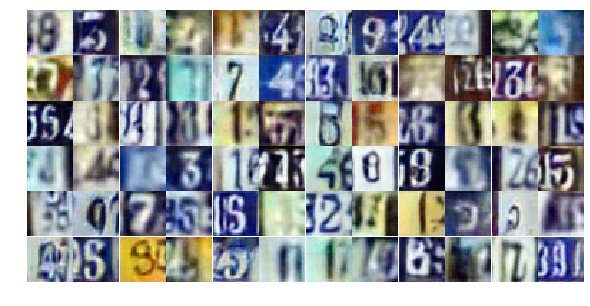

Epoch 20/25... Discriminator Loss: 1.3222... Generator Loss: 0.4223
Epoch 20/25... Discriminator Loss: 0.9379... Generator Loss: 0.7017
Epoch 20/25... Discriminator Loss: 0.5720... Generator Loss: 1.7076
Epoch 20/25... Discriminator Loss: 0.6513... Generator Loss: 1.1148
Epoch 20/25... Discriminator Loss: 1.3260... Generator Loss: 0.7796
Epoch 20/25... Discriminator Loss: 1.0222... Generator Loss: 0.6720
Epoch 20/25... Discriminator Loss: 0.9223... Generator Loss: 0.7752
Epoch 20/25... Discriminator Loss: 0.8604... Generator Loss: 0.7739
Epoch 20/25... Discriminator Loss: 0.7138... Generator Loss: 0.9459
Epoch 20/25... Discriminator Loss: 0.8482... Generator Loss: 0.8104


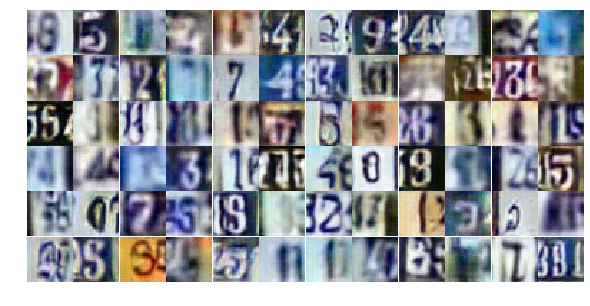

Epoch 20/25... Discriminator Loss: 0.8486... Generator Loss: 0.7955
Epoch 20/25... Discriminator Loss: 1.1158... Generator Loss: 0.6030
Epoch 20/25... Discriminator Loss: 0.2883... Generator Loss: 1.9153
Epoch 20/25... Discriminator Loss: 1.2480... Generator Loss: 0.5778
Epoch 20/25... Discriminator Loss: 1.3625... Generator Loss: 0.4966
Epoch 20/25... Discriminator Loss: 0.6076... Generator Loss: 1.1687
Epoch 20/25... Discriminator Loss: 0.5751... Generator Loss: 1.1196
Epoch 20/25... Discriminator Loss: 2.0129... Generator Loss: 0.2315
Epoch 20/25... Discriminator Loss: 1.0499... Generator Loss: 0.6154
Epoch 20/25... Discriminator Loss: 0.4393... Generator Loss: 1.4194


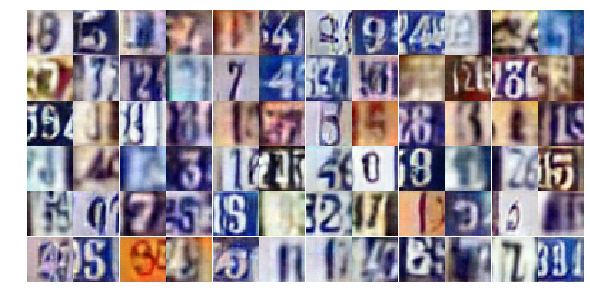

Epoch 20/25... Discriminator Loss: 0.8399... Generator Loss: 0.8189
Epoch 20/25... Discriminator Loss: 0.3909... Generator Loss: 1.7551
Epoch 20/25... Discriminator Loss: 0.6362... Generator Loss: 1.4171
Epoch 20/25... Discriminator Loss: 0.6575... Generator Loss: 1.1346
Epoch 20/25... Discriminator Loss: 0.4992... Generator Loss: 1.4452
Epoch 20/25... Discriminator Loss: 0.7269... Generator Loss: 0.9457
Epoch 20/25... Discriminator Loss: 0.6836... Generator Loss: 1.2979
Epoch 20/25... Discriminator Loss: 1.0724... Generator Loss: 0.6193
Epoch 20/25... Discriminator Loss: 0.9103... Generator Loss: 0.7535
Epoch 20/25... Discriminator Loss: 1.5561... Generator Loss: 0.3336


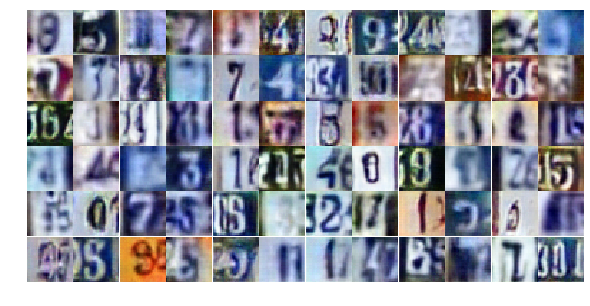

Epoch 20/25... Discriminator Loss: 0.7527... Generator Loss: 0.9349
Epoch 20/25... Discriminator Loss: 0.9145... Generator Loss: 0.7494
Epoch 20/25... Discriminator Loss: 0.6975... Generator Loss: 1.2201
Epoch 20/25... Discriminator Loss: 1.5746... Generator Loss: 1.6498
Epoch 20/25... Discriminator Loss: 0.9931... Generator Loss: 1.2824
Epoch 20/25... Discriminator Loss: 1.1467... Generator Loss: 0.5947
Epoch 20/25... Discriminator Loss: 0.7323... Generator Loss: 1.0930
Epoch 20/25... Discriminator Loss: 0.8129... Generator Loss: 0.8345
Epoch 20/25... Discriminator Loss: 0.7456... Generator Loss: 1.2974
Epoch 20/25... Discriminator Loss: 0.7507... Generator Loss: 0.9734


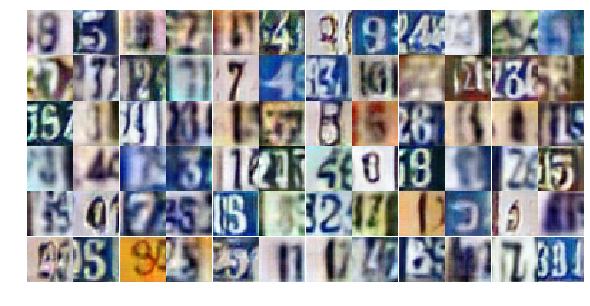

Epoch 20/25... Discriminator Loss: 0.8109... Generator Loss: 0.8839
Epoch 20/25... Discriminator Loss: 0.6912... Generator Loss: 1.8536
Epoch 20/25... Discriminator Loss: 0.5548... Generator Loss: 1.4698
Epoch 20/25... Discriminator Loss: 0.9947... Generator Loss: 1.7628
Epoch 20/25... Discriminator Loss: 0.6733... Generator Loss: 1.0675
Epoch 20/25... Discriminator Loss: 0.6214... Generator Loss: 1.0194
Epoch 21/25... Discriminator Loss: 1.0740... Generator Loss: 0.5756
Epoch 21/25... Discriminator Loss: 0.9945... Generator Loss: 0.6418
Epoch 21/25... Discriminator Loss: 0.9490... Generator Loss: 0.7477
Epoch 21/25... Discriminator Loss: 1.1224... Generator Loss: 0.5307


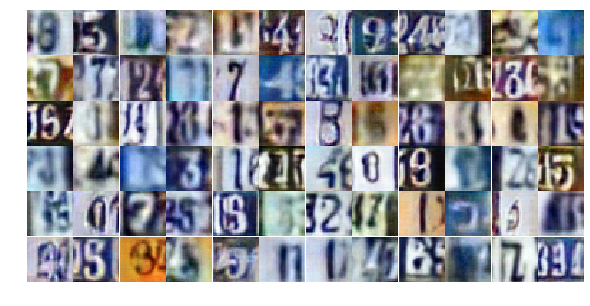

Epoch 21/25... Discriminator Loss: 0.7152... Generator Loss: 0.9936
Epoch 21/25... Discriminator Loss: 2.1499... Generator Loss: 0.2178
Epoch 21/25... Discriminator Loss: 0.6288... Generator Loss: 1.0946
Epoch 21/25... Discriminator Loss: 0.6888... Generator Loss: 0.9450
Epoch 21/25... Discriminator Loss: 1.1555... Generator Loss: 0.5465
Epoch 21/25... Discriminator Loss: 0.3599... Generator Loss: 1.7110
Epoch 21/25... Discriminator Loss: 0.6191... Generator Loss: 1.0901
Epoch 21/25... Discriminator Loss: 1.2644... Generator Loss: 0.5211
Epoch 21/25... Discriminator Loss: 0.7343... Generator Loss: 0.8792
Epoch 21/25... Discriminator Loss: 1.1595... Generator Loss: 0.5089


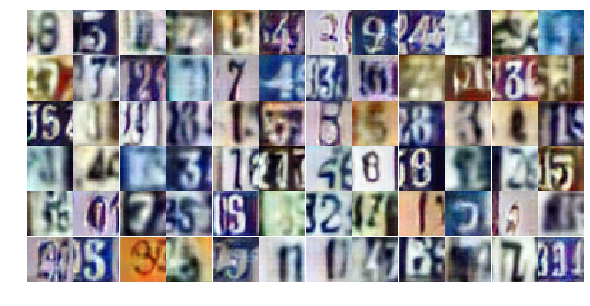

Epoch 21/25... Discriminator Loss: 0.4440... Generator Loss: 1.3089
Epoch 21/25... Discriminator Loss: 0.9077... Generator Loss: 0.8368
Epoch 21/25... Discriminator Loss: 1.2628... Generator Loss: 0.5196
Epoch 21/25... Discriminator Loss: 0.5304... Generator Loss: 1.8369
Epoch 21/25... Discriminator Loss: 0.4941... Generator Loss: 1.4874
Epoch 21/25... Discriminator Loss: 1.5852... Generator Loss: 0.3200
Epoch 21/25... Discriminator Loss: 1.1347... Generator Loss: 0.5546
Epoch 21/25... Discriminator Loss: 0.5001... Generator Loss: 1.2483
Epoch 21/25... Discriminator Loss: 0.5120... Generator Loss: 1.3019
Epoch 21/25... Discriminator Loss: 0.7266... Generator Loss: 0.9334


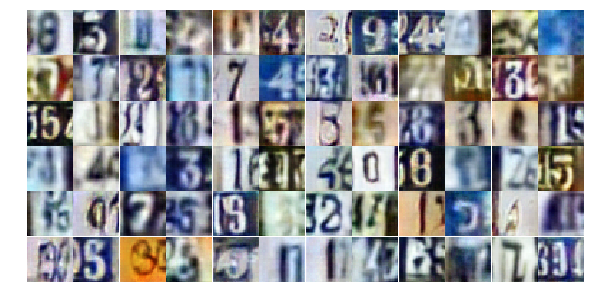

Epoch 21/25... Discriminator Loss: 1.2149... Generator Loss: 0.5398
Epoch 21/25... Discriminator Loss: 0.4756... Generator Loss: 1.5458
Epoch 21/25... Discriminator Loss: 0.8192... Generator Loss: 0.8954
Epoch 21/25... Discriminator Loss: 0.7664... Generator Loss: 0.9385
Epoch 21/25... Discriminator Loss: 0.9609... Generator Loss: 0.8685
Epoch 21/25... Discriminator Loss: 0.7767... Generator Loss: 0.9077
Epoch 21/25... Discriminator Loss: 0.8200... Generator Loss: 0.8488
Epoch 21/25... Discriminator Loss: 1.2829... Generator Loss: 0.4772
Epoch 21/25... Discriminator Loss: 0.9527... Generator Loss: 0.6644
Epoch 21/25... Discriminator Loss: 1.7523... Generator Loss: 0.3779


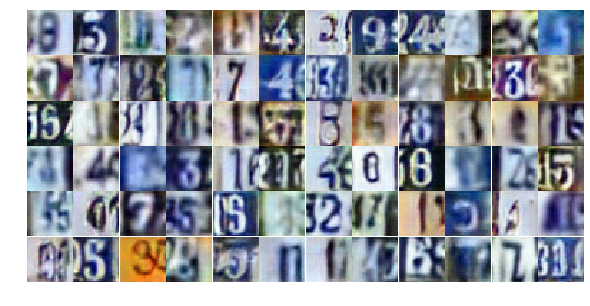

Epoch 21/25... Discriminator Loss: 1.2277... Generator Loss: 0.4955
Epoch 21/25... Discriminator Loss: 0.5889... Generator Loss: 1.1340
Epoch 21/25... Discriminator Loss: 1.2498... Generator Loss: 0.4642
Epoch 21/25... Discriminator Loss: 0.7209... Generator Loss: 0.8900
Epoch 21/25... Discriminator Loss: 0.4771... Generator Loss: 1.3189
Epoch 21/25... Discriminator Loss: 0.6523... Generator Loss: 1.1874
Epoch 21/25... Discriminator Loss: 0.9823... Generator Loss: 0.6331
Epoch 21/25... Discriminator Loss: 1.0879... Generator Loss: 0.5448
Epoch 21/25... Discriminator Loss: 0.7880... Generator Loss: 0.8708
Epoch 21/25... Discriminator Loss: 0.2890... Generator Loss: 2.2397


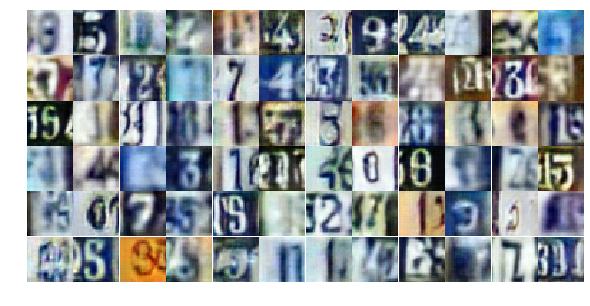

Epoch 21/25... Discriminator Loss: 1.4118... Generator Loss: 0.5469
Epoch 21/25... Discriminator Loss: 1.5672... Generator Loss: 0.3653
Epoch 21/25... Discriminator Loss: 0.5824... Generator Loss: 1.2523
Epoch 21/25... Discriminator Loss: 0.7180... Generator Loss: 1.0381
Epoch 21/25... Discriminator Loss: 0.3980... Generator Loss: 1.5829
Epoch 21/25... Discriminator Loss: 0.8156... Generator Loss: 1.4254
Epoch 21/25... Discriminator Loss: 1.0424... Generator Loss: 0.6774
Epoch 21/25... Discriminator Loss: 0.8970... Generator Loss: 0.7560
Epoch 21/25... Discriminator Loss: 0.9289... Generator Loss: 0.7417
Epoch 21/25... Discriminator Loss: 0.7226... Generator Loss: 0.9308


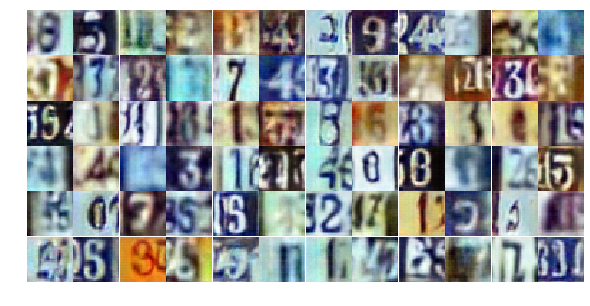

Epoch 21/25... Discriminator Loss: 0.5333... Generator Loss: 1.3823
Epoch 21/25... Discriminator Loss: 0.8044... Generator Loss: 0.8815
Epoch 21/25... Discriminator Loss: 1.0348... Generator Loss: 0.6827
Epoch 22/25... Discriminator Loss: 0.8447... Generator Loss: 0.9040
Epoch 22/25... Discriminator Loss: 1.0517... Generator Loss: 0.8460
Epoch 22/25... Discriminator Loss: 0.8319... Generator Loss: 0.8037
Epoch 22/25... Discriminator Loss: 0.4498... Generator Loss: 1.5006
Epoch 22/25... Discriminator Loss: 0.4353... Generator Loss: 1.3589
Epoch 22/25... Discriminator Loss: 1.2452... Generator Loss: 0.5214
Epoch 22/25... Discriminator Loss: 0.9266... Generator Loss: 0.7521


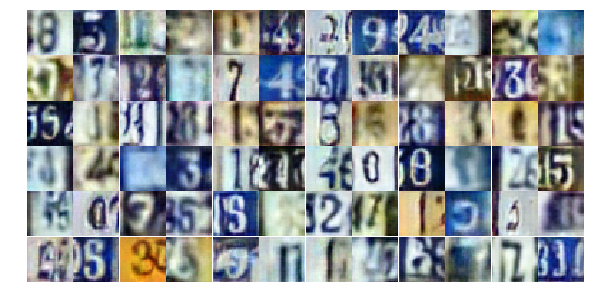

Epoch 22/25... Discriminator Loss: 0.4861... Generator Loss: 1.4272
Epoch 22/25... Discriminator Loss: 1.0077... Generator Loss: 0.6703
Epoch 22/25... Discriminator Loss: 1.4542... Generator Loss: 0.3913
Epoch 22/25... Discriminator Loss: 0.5822... Generator Loss: 1.3642
Epoch 22/25... Discriminator Loss: 0.7575... Generator Loss: 0.9844
Epoch 22/25... Discriminator Loss: 0.5389... Generator Loss: 1.4607
Epoch 22/25... Discriminator Loss: 0.8364... Generator Loss: 0.8522
Epoch 22/25... Discriminator Loss: 0.4398... Generator Loss: 1.4804
Epoch 22/25... Discriminator Loss: 1.3673... Generator Loss: 0.4183
Epoch 22/25... Discriminator Loss: 1.6761... Generator Loss: 0.3935


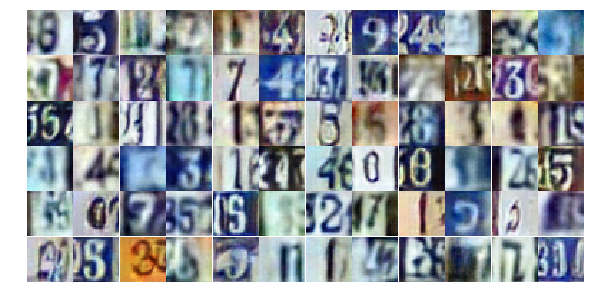

Epoch 22/25... Discriminator Loss: 0.4131... Generator Loss: 1.9110
Epoch 22/25... Discriminator Loss: 0.8867... Generator Loss: 0.7238
Epoch 22/25... Discriminator Loss: 0.8521... Generator Loss: 0.7800
Epoch 22/25... Discriminator Loss: 0.4527... Generator Loss: 1.5657
Epoch 22/25... Discriminator Loss: 0.5029... Generator Loss: 1.3177
Epoch 22/25... Discriminator Loss: 1.0101... Generator Loss: 0.6702
Epoch 22/25... Discriminator Loss: 0.5868... Generator Loss: 1.0963
Epoch 22/25... Discriminator Loss: 0.4455... Generator Loss: 1.5742
Epoch 22/25... Discriminator Loss: 0.5648... Generator Loss: 1.2463
Epoch 22/25... Discriminator Loss: 0.9470... Generator Loss: 0.6845


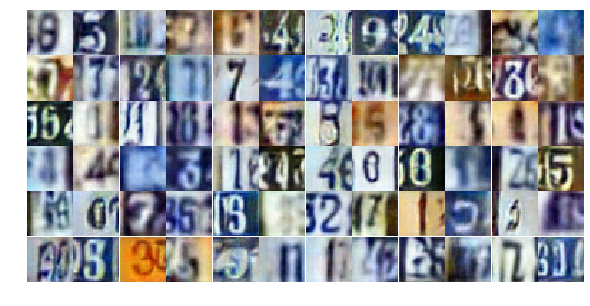

Epoch 22/25... Discriminator Loss: 0.4111... Generator Loss: 1.5671
Epoch 22/25... Discriminator Loss: 0.6581... Generator Loss: 0.9425
Epoch 22/25... Discriminator Loss: 1.1043... Generator Loss: 0.6301
Epoch 22/25... Discriminator Loss: 0.9041... Generator Loss: 0.7505
Epoch 22/25... Discriminator Loss: 0.9202... Generator Loss: 0.7441
Epoch 22/25... Discriminator Loss: 1.1964... Generator Loss: 0.5518
Epoch 22/25... Discriminator Loss: 1.3113... Generator Loss: 0.4562
Epoch 22/25... Discriminator Loss: 0.5735... Generator Loss: 1.3864
Epoch 22/25... Discriminator Loss: 1.0678... Generator Loss: 0.6829
Epoch 22/25... Discriminator Loss: 0.8333... Generator Loss: 0.8209


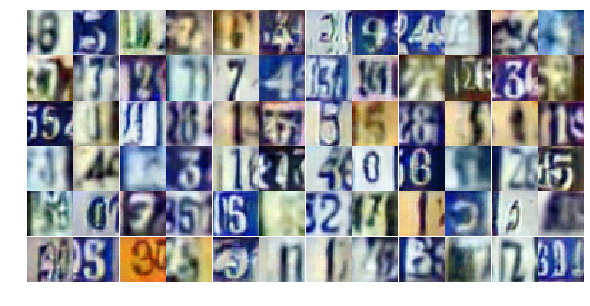

Epoch 22/25... Discriminator Loss: 0.6870... Generator Loss: 1.0137
Epoch 22/25... Discriminator Loss: 0.5108... Generator Loss: 1.5392
Epoch 22/25... Discriminator Loss: 0.3223... Generator Loss: 1.7640
Epoch 22/25... Discriminator Loss: 1.0445... Generator Loss: 0.6577
Epoch 22/25... Discriminator Loss: 0.4416... Generator Loss: 1.3899
Epoch 22/25... Discriminator Loss: 0.5396... Generator Loss: 1.1832
Epoch 22/25... Discriminator Loss: 0.7524... Generator Loss: 1.1478
Epoch 22/25... Discriminator Loss: 1.9517... Generator Loss: 0.3621
Epoch 22/25... Discriminator Loss: 1.4342... Generator Loss: 0.5786
Epoch 22/25... Discriminator Loss: 0.8838... Generator Loss: 0.8689


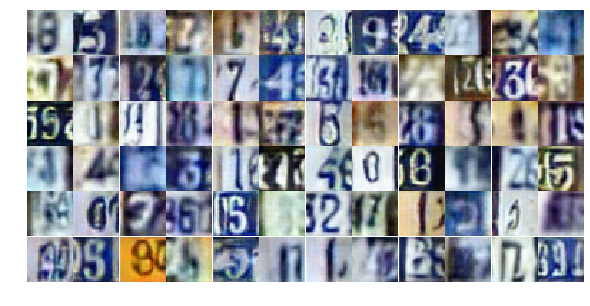

Epoch 22/25... Discriminator Loss: 1.1353... Generator Loss: 0.5849
Epoch 22/25... Discriminator Loss: 0.4896... Generator Loss: 1.4490
Epoch 22/25... Discriminator Loss: 0.7609... Generator Loss: 0.8892
Epoch 22/25... Discriminator Loss: 1.1908... Generator Loss: 0.5327
Epoch 22/25... Discriminator Loss: 1.1487... Generator Loss: 0.6442
Epoch 22/25... Discriminator Loss: 0.9442... Generator Loss: 0.7870
Epoch 22/25... Discriminator Loss: 1.3324... Generator Loss: 0.4565
Epoch 22/25... Discriminator Loss: 0.4426... Generator Loss: 1.4032
Epoch 22/25... Discriminator Loss: 0.9803... Generator Loss: 0.9227
Epoch 22/25... Discriminator Loss: 0.6427... Generator Loss: 1.1086


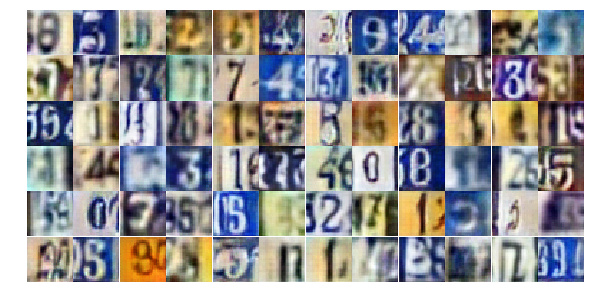

Epoch 23/25... Discriminator Loss: 0.5971... Generator Loss: 1.2729
Epoch 23/25... Discriminator Loss: 0.5276... Generator Loss: 1.1596
Epoch 23/25... Discriminator Loss: 0.8300... Generator Loss: 0.9042
Epoch 23/25... Discriminator Loss: 0.7817... Generator Loss: 1.1619
Epoch 23/25... Discriminator Loss: 0.6334... Generator Loss: 1.5292
Epoch 23/25... Discriminator Loss: 0.8741... Generator Loss: 0.8850
Epoch 23/25... Discriminator Loss: 1.3969... Generator Loss: 0.4752
Epoch 23/25... Discriminator Loss: 1.3650... Generator Loss: 0.4880
Epoch 23/25... Discriminator Loss: 0.5872... Generator Loss: 1.6382
Epoch 23/25... Discriminator Loss: 0.4408... Generator Loss: 1.4750


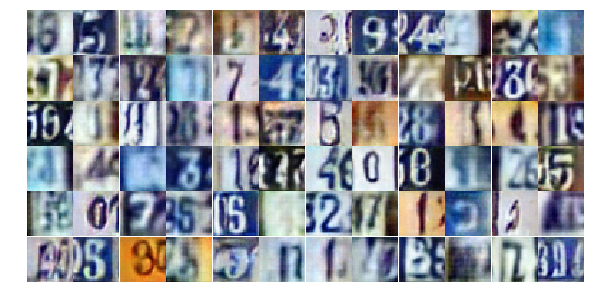

Epoch 23/25... Discriminator Loss: 0.5082... Generator Loss: 1.8348
Epoch 23/25... Discriminator Loss: 0.5883... Generator Loss: 1.1414
Epoch 23/25... Discriminator Loss: 0.8847... Generator Loss: 0.9722
Epoch 23/25... Discriminator Loss: 0.5874... Generator Loss: 1.2982
Epoch 23/25... Discriminator Loss: 0.6668... Generator Loss: 1.0216
Epoch 23/25... Discriminator Loss: 0.7584... Generator Loss: 0.8987
Epoch 23/25... Discriminator Loss: 0.8842... Generator Loss: 0.7553
Epoch 23/25... Discriminator Loss: 0.6296... Generator Loss: 1.4503
Epoch 23/25... Discriminator Loss: 0.6807... Generator Loss: 1.3635
Epoch 23/25... Discriminator Loss: 0.7601... Generator Loss: 1.0021


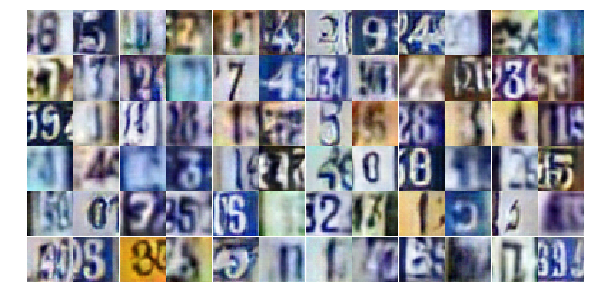

Epoch 23/25... Discriminator Loss: 1.1967... Generator Loss: 0.5061
Epoch 23/25... Discriminator Loss: 0.4265... Generator Loss: 1.5229
Epoch 23/25... Discriminator Loss: 1.2060... Generator Loss: 0.4841
Epoch 23/25... Discriminator Loss: 1.4238... Generator Loss: 0.4167
Epoch 23/25... Discriminator Loss: 0.6408... Generator Loss: 1.2708
Epoch 23/25... Discriminator Loss: 0.9313... Generator Loss: 0.6929
Epoch 23/25... Discriminator Loss: 1.0883... Generator Loss: 0.6027
Epoch 23/25... Discriminator Loss: 0.4936... Generator Loss: 1.3507
Epoch 23/25... Discriminator Loss: 0.8909... Generator Loss: 0.7430
Epoch 23/25... Discriminator Loss: 1.1253... Generator Loss: 0.5613


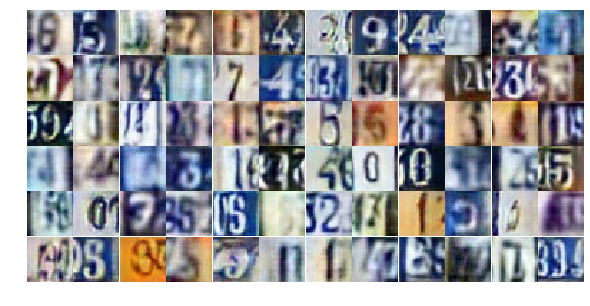

Epoch 23/25... Discriminator Loss: 0.6010... Generator Loss: 1.0977
Epoch 23/25... Discriminator Loss: 0.7326... Generator Loss: 0.9196
Epoch 23/25... Discriminator Loss: 0.6247... Generator Loss: 1.1872
Epoch 23/25... Discriminator Loss: 1.0630... Generator Loss: 0.6982
Epoch 23/25... Discriminator Loss: 1.3546... Generator Loss: 3.5149
Epoch 23/25... Discriminator Loss: 1.7842... Generator Loss: 0.3051
Epoch 23/25... Discriminator Loss: 0.9676... Generator Loss: 0.6753
Epoch 23/25... Discriminator Loss: 0.7644... Generator Loss: 0.9929
Epoch 23/25... Discriminator Loss: 0.4480... Generator Loss: 1.5671
Epoch 23/25... Discriminator Loss: 0.6092... Generator Loss: 1.1628


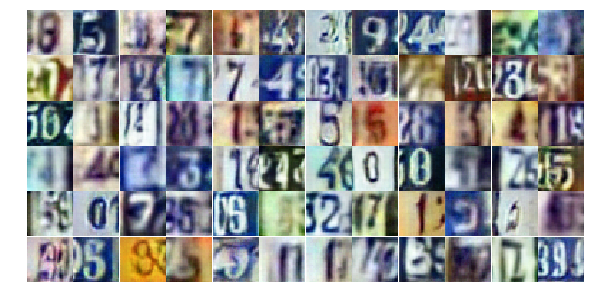

Epoch 23/25... Discriminator Loss: 1.0759... Generator Loss: 0.5796
Epoch 23/25... Discriminator Loss: 1.2139... Generator Loss: 0.5535
Epoch 23/25... Discriminator Loss: 1.5228... Generator Loss: 0.3401
Epoch 23/25... Discriminator Loss: 1.8322... Generator Loss: 0.2723
Epoch 23/25... Discriminator Loss: 0.5734... Generator Loss: 1.3703
Epoch 23/25... Discriminator Loss: 0.8003... Generator Loss: 0.7737
Epoch 23/25... Discriminator Loss: 0.4655... Generator Loss: 1.4348
Epoch 23/25... Discriminator Loss: 0.9610... Generator Loss: 0.7320
Epoch 23/25... Discriminator Loss: 0.7428... Generator Loss: 2.7111
Epoch 23/25... Discriminator Loss: 1.2447... Generator Loss: 0.6102


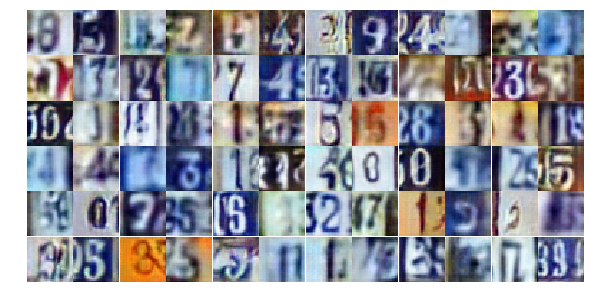

Epoch 23/25... Discriminator Loss: 0.7266... Generator Loss: 1.0101
Epoch 23/25... Discriminator Loss: 1.5065... Generator Loss: 0.4219
Epoch 23/25... Discriminator Loss: 0.8020... Generator Loss: 1.2185
Epoch 23/25... Discriminator Loss: 0.5951... Generator Loss: 1.1056
Epoch 23/25... Discriminator Loss: 1.6517... Generator Loss: 0.3634
Epoch 23/25... Discriminator Loss: 0.4020... Generator Loss: 1.5203
Epoch 23/25... Discriminator Loss: 1.4325... Generator Loss: 0.5379
Epoch 24/25... Discriminator Loss: 0.6175... Generator Loss: 1.2801
Epoch 24/25... Discriminator Loss: 0.9492... Generator Loss: 2.4733
Epoch 24/25... Discriminator Loss: 1.0169... Generator Loss: 0.7376


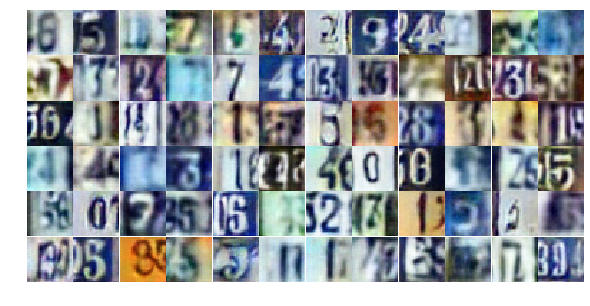

Epoch 24/25... Discriminator Loss: 0.6271... Generator Loss: 1.9862
Epoch 24/25... Discriminator Loss: 0.6393... Generator Loss: 1.2202
Epoch 24/25... Discriminator Loss: 0.9434... Generator Loss: 0.6682
Epoch 24/25... Discriminator Loss: 0.8853... Generator Loss: 1.1566
Epoch 24/25... Discriminator Loss: 0.5755... Generator Loss: 1.1083
Epoch 24/25... Discriminator Loss: 0.4831... Generator Loss: 1.5365
Epoch 24/25... Discriminator Loss: 0.9329... Generator Loss: 0.6612
Epoch 24/25... Discriminator Loss: 1.4003... Generator Loss: 0.4182
Epoch 24/25... Discriminator Loss: 0.2635... Generator Loss: 2.2234
Epoch 24/25... Discriminator Loss: 0.4618... Generator Loss: 1.4139


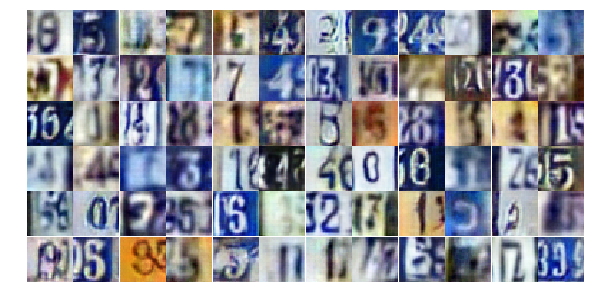

Epoch 24/25... Discriminator Loss: 1.2237... Generator Loss: 0.5867
Epoch 24/25... Discriminator Loss: 1.0314... Generator Loss: 0.6717
Epoch 24/25... Discriminator Loss: 1.2731... Generator Loss: 0.4702
Epoch 24/25... Discriminator Loss: 0.7525... Generator Loss: 0.9844
Epoch 24/25... Discriminator Loss: 0.4690... Generator Loss: 2.2600
Epoch 24/25... Discriminator Loss: 1.2433... Generator Loss: 0.5028
Epoch 24/25... Discriminator Loss: 0.4895... Generator Loss: 1.3296
Epoch 24/25... Discriminator Loss: 1.0717... Generator Loss: 0.6014
Epoch 24/25... Discriminator Loss: 0.5643... Generator Loss: 1.4054
Epoch 24/25... Discriminator Loss: 0.5813... Generator Loss: 1.1820


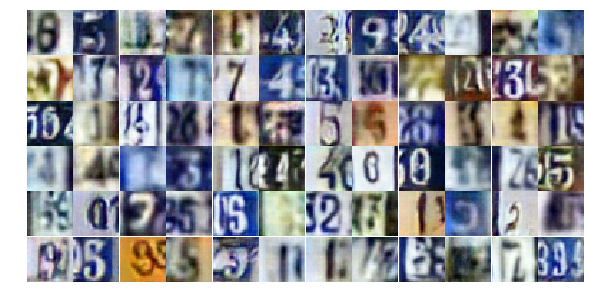

Epoch 24/25... Discriminator Loss: 0.8699... Generator Loss: 0.7959
Epoch 24/25... Discriminator Loss: 0.7417... Generator Loss: 0.9429
Epoch 24/25... Discriminator Loss: 0.7552... Generator Loss: 3.3855
Epoch 24/25... Discriminator Loss: 2.1105... Generator Loss: 0.2267
Epoch 24/25... Discriminator Loss: 0.5021... Generator Loss: 1.4686
Epoch 24/25... Discriminator Loss: 0.5631... Generator Loss: 1.1367
Epoch 24/25... Discriminator Loss: 0.4728... Generator Loss: 1.3283
Epoch 24/25... Discriminator Loss: 0.8115... Generator Loss: 0.8884
Epoch 24/25... Discriminator Loss: 0.6165... Generator Loss: 1.3302
Epoch 24/25... Discriminator Loss: 0.7477... Generator Loss: 1.1459


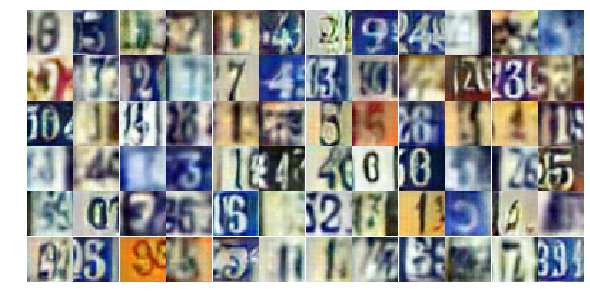

Epoch 24/25... Discriminator Loss: 0.5425... Generator Loss: 1.1843
Epoch 24/25... Discriminator Loss: 0.3872... Generator Loss: 1.7021
Epoch 24/25... Discriminator Loss: 0.8979... Generator Loss: 1.1194
Epoch 24/25... Discriminator Loss: 1.5341... Generator Loss: 0.3839
Epoch 24/25... Discriminator Loss: 1.4537... Generator Loss: 0.3562
Epoch 24/25... Discriminator Loss: 1.5709... Generator Loss: 0.3839
Epoch 24/25... Discriminator Loss: 1.1182... Generator Loss: 0.6136
Epoch 24/25... Discriminator Loss: 0.8690... Generator Loss: 0.9361
Epoch 24/25... Discriminator Loss: 0.7396... Generator Loss: 1.7436
Epoch 24/25... Discriminator Loss: 0.6105... Generator Loss: 1.3976


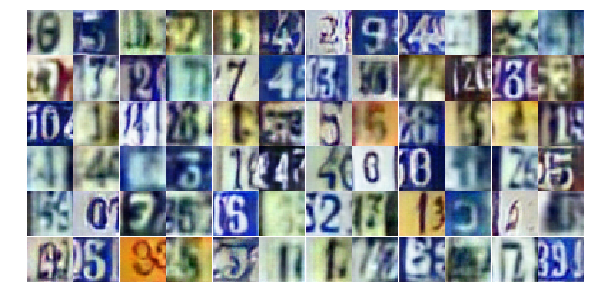

Epoch 24/25... Discriminator Loss: 1.1451... Generator Loss: 0.5898
Epoch 24/25... Discriminator Loss: 0.6309... Generator Loss: 1.3928
Epoch 24/25... Discriminator Loss: 1.4536... Generator Loss: 1.4268
Epoch 24/25... Discriminator Loss: 1.3107... Generator Loss: 2.8482
Epoch 24/25... Discriminator Loss: 1.5461... Generator Loss: 0.4236
Epoch 24/25... Discriminator Loss: 0.8919... Generator Loss: 0.8079
Epoch 24/25... Discriminator Loss: 1.2093... Generator Loss: 0.5553
Epoch 24/25... Discriminator Loss: 0.7950... Generator Loss: 0.9312
Epoch 24/25... Discriminator Loss: 1.0664... Generator Loss: 0.7396
Epoch 24/25... Discriminator Loss: 0.9176... Generator Loss: 0.9041


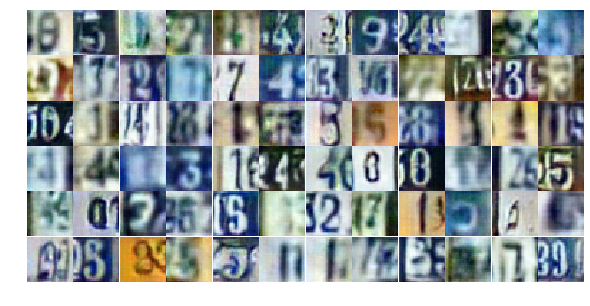

Epoch 24/25... Discriminator Loss: 1.0535... Generator Loss: 0.6575
Epoch 24/25... Discriminator Loss: 1.7676... Generator Loss: 0.3651
Epoch 24/25... Discriminator Loss: 0.9035... Generator Loss: 0.7471
Epoch 24/25... Discriminator Loss: 0.6428... Generator Loss: 1.2973
Epoch 24/25... Discriminator Loss: 0.7974... Generator Loss: 0.8930
Epoch 25/25... Discriminator Loss: 0.5945... Generator Loss: 1.2470
Epoch 25/25... Discriminator Loss: 0.4963... Generator Loss: 1.6914
Epoch 25/25... Discriminator Loss: 0.6770... Generator Loss: 1.0054
Epoch 25/25... Discriminator Loss: 0.6911... Generator Loss: 1.0329
Epoch 25/25... Discriminator Loss: 0.7700... Generator Loss: 0.8830


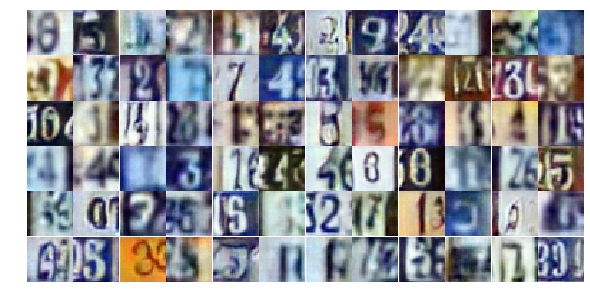

Epoch 25/25... Discriminator Loss: 1.0430... Generator Loss: 0.6133
Epoch 25/25... Discriminator Loss: 1.0645... Generator Loss: 0.7048
Epoch 25/25... Discriminator Loss: 0.6763... Generator Loss: 1.0796
Epoch 25/25... Discriminator Loss: 0.8295... Generator Loss: 0.8072
Epoch 25/25... Discriminator Loss: 0.9515... Generator Loss: 0.7776
Epoch 25/25... Discriminator Loss: 0.9799... Generator Loss: 0.7551
Epoch 25/25... Discriminator Loss: 0.6703... Generator Loss: 1.0068
Epoch 25/25... Discriminator Loss: 0.5017... Generator Loss: 1.3149
Epoch 25/25... Discriminator Loss: 0.5249... Generator Loss: 1.4909
Epoch 25/25... Discriminator Loss: 1.0161... Generator Loss: 0.6231


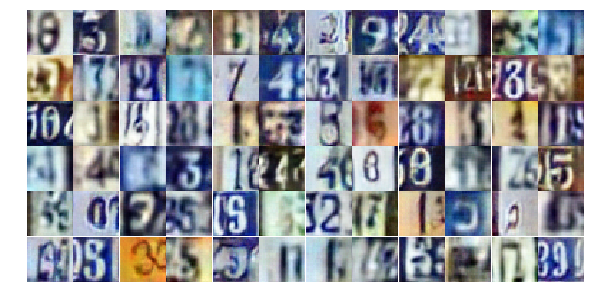

Epoch 25/25... Discriminator Loss: 0.5712... Generator Loss: 1.2718
Epoch 25/25... Discriminator Loss: 0.4784... Generator Loss: 1.9215
Epoch 25/25... Discriminator Loss: 1.0725... Generator Loss: 0.6174
Epoch 25/25... Discriminator Loss: 1.0885... Generator Loss: 0.6621
Epoch 25/25... Discriminator Loss: 0.6095... Generator Loss: 1.1992
Epoch 25/25... Discriminator Loss: 0.7330... Generator Loss: 0.9335
Epoch 25/25... Discriminator Loss: 0.8372... Generator Loss: 0.9729
Epoch 25/25... Discriminator Loss: 0.8194... Generator Loss: 1.2218
Epoch 25/25... Discriminator Loss: 0.5570... Generator Loss: 1.4188
Epoch 25/25... Discriminator Loss: 0.5879... Generator Loss: 1.1974


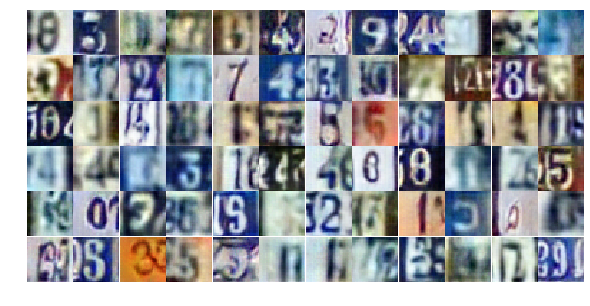

Epoch 25/25... Discriminator Loss: 1.3302... Generator Loss: 0.4738
Epoch 25/25... Discriminator Loss: 0.4458... Generator Loss: 1.4991
Epoch 25/25... Discriminator Loss: 1.5363... Generator Loss: 0.4725
Epoch 25/25... Discriminator Loss: 0.5424... Generator Loss: 1.2993
Epoch 25/25... Discriminator Loss: 0.8198... Generator Loss: 0.8255
Epoch 25/25... Discriminator Loss: 0.9212... Generator Loss: 0.6839
Epoch 25/25... Discriminator Loss: 0.9596... Generator Loss: 0.7584
Epoch 25/25... Discriminator Loss: 0.9931... Generator Loss: 0.6858
Epoch 25/25... Discriminator Loss: 0.7693... Generator Loss: 1.3391
Epoch 25/25... Discriminator Loss: 0.3188... Generator Loss: 1.8596


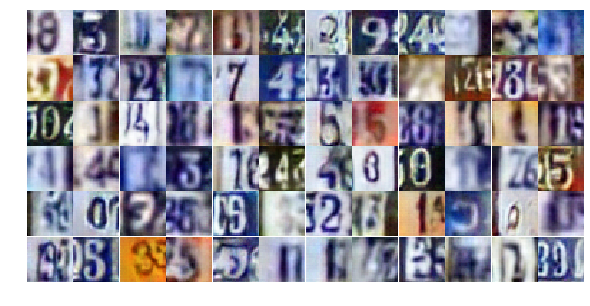

Epoch 25/25... Discriminator Loss: 0.6297... Generator Loss: 1.1920
Epoch 25/25... Discriminator Loss: 0.3679... Generator Loss: 1.5668
Epoch 25/25... Discriminator Loss: 0.7168... Generator Loss: 0.9980
Epoch 25/25... Discriminator Loss: 0.5492... Generator Loss: 1.3915
Epoch 25/25... Discriminator Loss: 1.8474... Generator Loss: 0.3069
Epoch 25/25... Discriminator Loss: 0.7614... Generator Loss: 1.4712
Epoch 25/25... Discriminator Loss: 0.5096... Generator Loss: 1.2849
Epoch 25/25... Discriminator Loss: 1.1244... Generator Loss: 0.5571
Epoch 25/25... Discriminator Loss: 1.8919... Generator Loss: 0.3748
Epoch 25/25... Discriminator Loss: 0.3566... Generator Loss: 3.0637


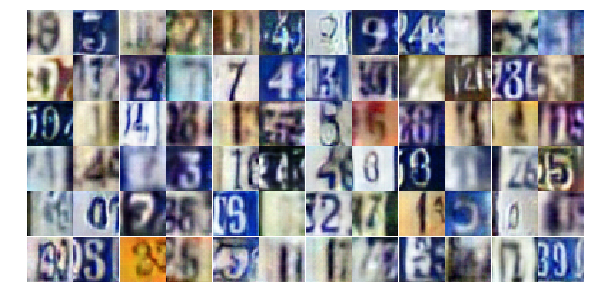

Epoch 25/25... Discriminator Loss: 9.8267... Generator Loss: 0.0109
Epoch 25/25... Discriminator Loss: 2.6002... Generator Loss: 1.3234
Epoch 25/25... Discriminator Loss: 2.6870... Generator Loss: 3.8477
Epoch 25/25... Discriminator Loss: 0.9211... Generator Loss: 0.9061
Epoch 25/25... Discriminator Loss: 1.3960... Generator Loss: 0.5040
Epoch 25/25... Discriminator Loss: 0.6049... Generator Loss: 1.2197
Epoch 25/25... Discriminator Loss: 0.9003... Generator Loss: 0.8109
Epoch 25/25... Discriminator Loss: 1.0015... Generator Loss: 0.7132
Epoch 25/25... Discriminator Loss: 0.8224... Generator Loss: 0.8648
Epoch 25/25... Discriminator Loss: 1.1018... Generator Loss: 0.6425


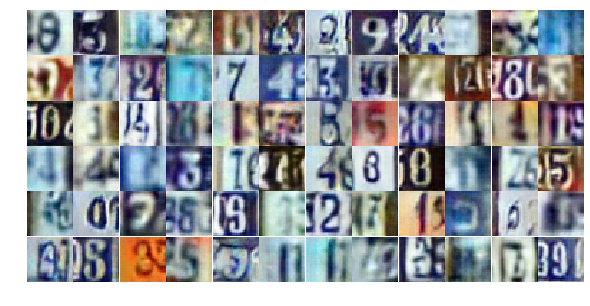

Epoch 25/25... Discriminator Loss: 0.4917... Generator Loss: 1.7821
Epoch 25/25... Discriminator Loss: 1.4205... Generator Loss: 0.4504


In [24]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

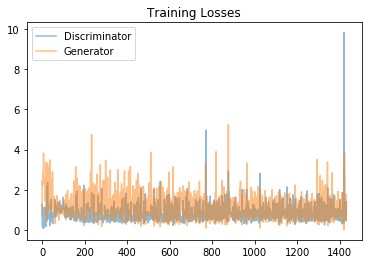

In [25]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

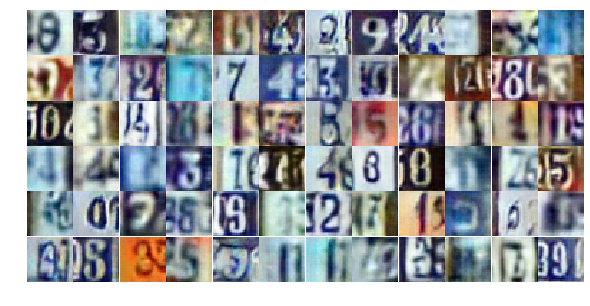

In [26]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))